# TODOs:

## HeatMap: Correlate Cell Activation with Output cell activation
This will probably be better than comparison to ground truth our final output as it is more continuous as well.

(Maybe use weigted cells to know the real impact)

## HeatMap: All Dense Cell weights
That way we see which cell has how much meaning to a specific category.

In [1]:
import pandas as pd
import numpy as np

# Define the matrix from the image with 33 cells and 4 oscillation categories
osc_corr_matrix = np.array([
    [0.19, 0.28, 0.05, 0.18],
    [0.17, 0.03, 0.12, 0.08],
    [0.46, 0.49, 0.50, 0.09],
    [0.57, 0.54, 0.38, 0.32],
    [0.39, 0.42, 0.46, 0.36],
    [0.36, 0.40, 0.34, 0.58],
    [0.51, 0.55, 0.53, 0.28],
    [0.41, 0.49, 0.52, 0.55],
    [0.21, 0.40, 0.50, 0.36],
    [0.21, 0.35, 0.35, 0.11],
    [0.35, 0.35, 0.23, 0.03],
    [0.23, 0.22, 0.18, 0.09],
    [0.44, 0.54, 0.52, 0.11],
    [0.40, 0.34, 0.13, 0.19],
    [0.18, 0.11, 0.01, 0.19],
    [0.09, 0.06, 0.14, 0.37],
    [0.34, 0.42, 0.50, 0.36],
    [0.01, 0.04, 0.00, 0.38],
    [0.39, 0.52, 0.64, 0.72],
    [0.14, 0.05, 0.35, 0.07],
    [0.24, 0.31, 0.20, 0.17],
    [0.12, 0.40, 0.51, 0.19],
    [0.05, 0.06, 0.13, 0.44],
    [0.15, 0.03, 0.02, 0.43],
    [0.09, 0.05, 0.21, 0.19],
    [0.27, 0.38, 0.48, 0.28],
    [0.24, 0.29, 0.10, 0.18],
    [0.22, 0.34, 0.44, 0.59],
    [0.38, 0.44, 0.47, 0.54],
    [0.26, 0.42, 0.54, 0.67],
    [0.09, 0.14, 0.19, 0.02],
    [0.09, 0.18, 0.08, 0.15],
])

# Calculate sum of absolute correlations per category (column-wise)
category_sums = np.mean(np.abs(osc_corr_matrix), axis=0)

# Wrap in a labeled Series
categories = ["theta", "alpha", "beta", "gamma"]
category_sums_series = pd.Series(category_sums, index=categories)
category_sums_series


,0
theta,0.257812
alpha,0.301250
beta,0.306875
gamma,0.289687


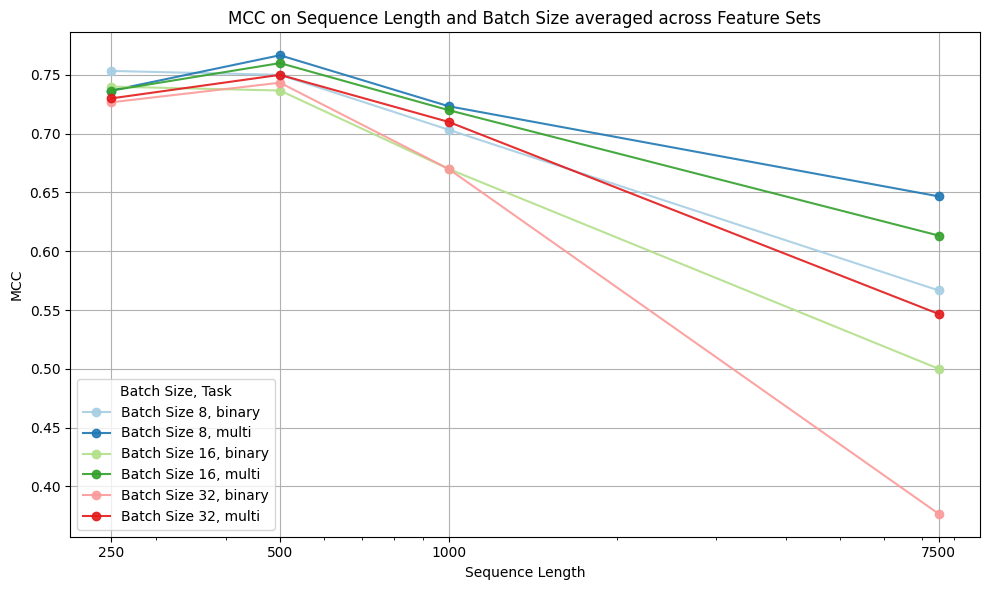

In [2]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib.ticker as mtick

# Manually typed MCC results from both images (25 epochs)
# Structure: [Feature Set, Task, SeqLen, BatchSize, MCC]
data = [
    # Binary task
    ["signal", "binary", 250, 8, 0.69], ["signal", "binary", 250, 16, 0.66], ["signal", "binary", 250, 32, 0.64],
    ["signal", "binary", 500, 8, 0.66], ["signal", "binary", 500, 16, 0.63], ["signal", "binary", 500, 32, 0.67],
    ["signal", "binary", 1000, 8, 0.60], ["signal", "binary", 1000, 16, 0.51], ["signal", "binary", 1000, 32, 0.56],
    ["signal", "binary", 7500, 8, 0.44], ["signal", "binary", 7500, 16, 0.29], ["signal", "binary", 7500, 32, 0.13],

    ["hilbert", "binary", 250, 8, 0.77], ["hilbert", "binary", 250, 16, 0.77], ["hilbert", "binary", 250, 32, 0.75],
    ["hilbert", "binary", 500, 8, 0.78], ["hilbert", "binary", 500, 16, 0.78], ["hilbert", "binary", 500, 32, 0.77],
    ["hilbert", "binary", 1000, 8, 0.75], ["hilbert", "binary", 1000, 16, 0.74], ["hilbert", "binary", 1000, 32, 0.71],
    ["hilbert", "binary", 7500, 8, 0.62], ["hilbert", "binary", 7500, 16, 0.58], ["hilbert", "binary", 7500, 32, 0.46],

    ["wavelets", "binary", 250, 8, 0.80], ["wavelets", "binary", 250, 16, 0.79], ["wavelets", "binary", 250, 32, 0.79],
    ["wavelets", "binary", 500, 8, 0.81], ["wavelets", "binary", 500, 16, 0.80], ["wavelets", "binary", 500, 32, 0.79],
    ["wavelets", "binary", 1000, 8, 0.76], ["wavelets", "binary", 1000, 16, 0.76], ["wavelets", "binary", 1000, 32, 0.74],
    ["wavelets", "binary", 7500, 8, 0.64], ["wavelets", "binary", 7500, 16, 0.63], ["wavelets", "binary", 7500, 32, 0.54],

    # Multiclass task
    ["signal", "multi", 250, 8, 0.70], ["signal", "multi", 250, 16, 0.70], ["signal", "multi", 250, 32, 0.69],
    ["signal", "multi", 500, 8, 0.74], ["signal", "multi", 500, 16, 0.73], ["signal", "multi", 500, 32, 0.72],
    ["signal", "multi", 1000, 8, 0.68], ["signal", "multi", 1000, 16, 0.68], ["signal", "multi", 1000, 32, 0.67],
    ["signal", "multi", 7500, 8, 0.63], ["signal", "multi", 7500, 16, 0.57], ["signal", "multi", 7500, 32, 0.48],

    ["hilbert", "multi", 250, 8, 0.73], ["hilbert", "multi", 250, 16, 0.74], ["hilbert", "multi", 250, 32, 0.74],
    ["hilbert", "multi", 500, 8, 0.76], ["hilbert", "multi", 500, 16, 0.76], ["hilbert", "multi", 500, 32, 0.75],
    ["hilbert", "multi", 1000, 8, 0.73], ["hilbert", "multi", 1000, 16, 0.72], ["hilbert", "multi", 1000, 32, 0.72],
    ["hilbert", "multi", 7500, 8, 0.65], ["hilbert", "multi", 7500, 16, 0.63], ["hilbert", "multi", 7500, 32, 0.55],

    ["wavelets", "multi", 250, 8, 0.78], ["wavelets", "multi", 250, 16, 0.77], ["wavelets", "multi", 250, 32, 0.76],
    ["wavelets", "multi", 500, 8, 0.80], ["wavelets", "multi", 500, 16, 0.79], ["wavelets", "multi", 500, 32, 0.78],
    ["wavelets", "multi", 1000, 8, 0.76], ["wavelets", "multi", 1000, 16, 0.76], ["wavelets", "multi", 1000, 32, 0.74],
    ["wavelets", "multi", 7500, 8, 0.66], ["wavelets", "multi", 7500, 16, 0.64], ["wavelets", "multi", 7500, 32, 0.61],
]

# Convert to DataFrame
df = pd.DataFrame(data, columns=["Feature", "Task", "SeqLen", "BatchSize", "MCC"])


# Generate heatmaps
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib.ticker as ticker

# Generate line plots to visualize MCC vs. Sequence Length for each feature and task
import seaborn as sns
import matplotlib.pyplot as plt

agg_df = df.groupby(["Task", "SeqLen", "BatchSize"])["MCC"].agg(['mean', 'min', 'max']).reset_index()


# Convert all necessary columns to standard numpy float arrays to ensure compatibility with matplotlib
agg_df["SeqLen"] = agg_df["SeqLen"].astype(float)
agg_df["mean"] = agg_df["mean"].astype(float)
agg_df["min"] = agg_df["min"].astype(float)
agg_df["max"] = agg_df["max"].astype(float)

batch_colors = {
    8: sns.color_palette("Blues", n_colors=5),  # Blues for batch size 8
    16: sns.color_palette("Greens", n_colors=5), # Greens for batch size 16
    32: sns.color_palette("Oranges", n_colors=5) # Oranges for batch size 32
}

colors = sns.color_palette("Paired", n_colors=8)  # Use a distinct color palette

# Create the plot with proper float arrays
plt.figure(figsize=(10, 6))
index = 0
for batch_size in agg_df['BatchSize'].unique():
    for task in agg_df['Task'].unique():
        subset = agg_df[(agg_df['BatchSize'] == batch_size) & (agg_df['Task'] == task)]

        # Choose color and style based on batch size and task
        color = batch_colors[batch_size][-2 if task == 'binary' else -3]  # Different shades for binary/multi
        style = '-' if task == 'binary' else '-'  # Solid line for binary, dashed for multi

        # Plot the line with chosen color and style
        plt.plot(subset['SeqLen'].values,
                 subset['mean'].values,
                 marker='o',
                 linestyle=style,
                 color=colors[index],
                 alpha=0.9,
                 label=f'Batch Size {batch_size}, {task}')
        index += 1
plt.title("MCC on Sequence Length and Batch Size averaged across Feature Sets")
plt.ylabel("MCC")
plt.xlabel("Sequence Length")
plt.xscale('log')
plt.xticks([250, 500, 1000, 7500])

# Get the current x-tick labels
xtick_labels = plt.gca().get_xticklabels()

# Format the xtick labels to show the original values
# This step is necessary because the logarithmic scale might change the labels
plt.gca().set_xticklabels([250, 500, 1000, 7500])


plt.grid(True)
plt.legend(title="Batch Size, Task")
plt.tight_layout()
plt.show()


    SeqLen  BatchSize      mean   min   max       std
0      250          8  0.745000  0.69  0.80  0.045056
1      250         16  0.738333  0.66  0.79  0.049565
2      250         32  0.728333  0.64  0.79  0.054191
3      500          8  0.758333  0.66  0.81  0.054559
4      500         16  0.748333  0.63  0.80  0.063061
5      500         32  0.746667  0.67  0.79  0.045019
6     1000          8  0.713333  0.60  0.76  0.063140
7     1000         16  0.695000  0.51  0.76  0.095446
8     1000         32  0.690000  0.56  0.74  0.068702
9     7500          8  0.606667  0.44  0.66  0.082865
10    7500         16  0.556667  0.29  0.64  0.133816
11    7500         32  0.461667  0.13  0.61  0.171046


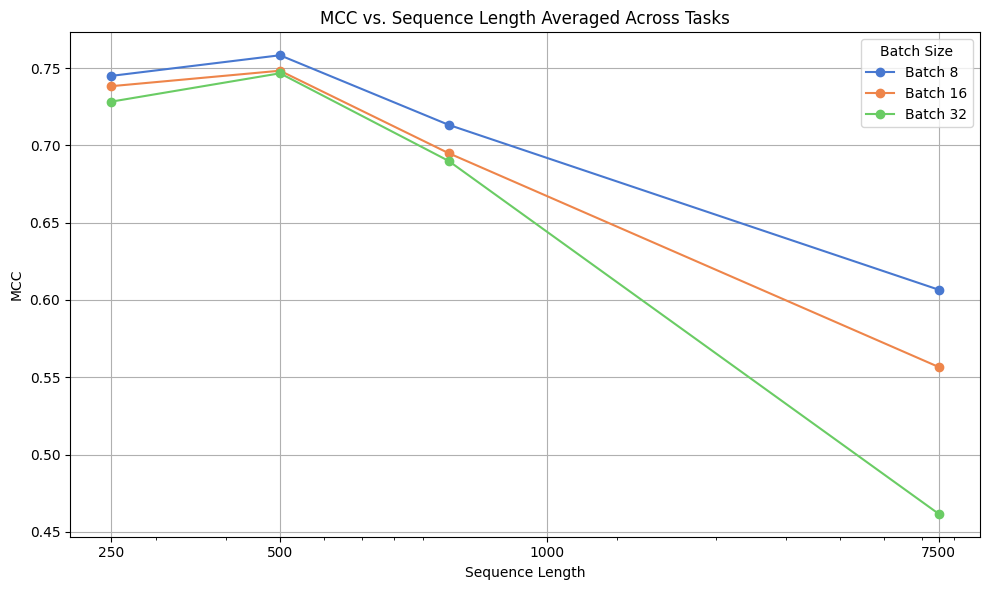

In [7]:
agg_df_task_averaged = df.groupby(["SeqLen", "BatchSize"])["MCC"].agg(['mean', 'min', 'max', 'std']).reset_index()
print(agg_df_task_averaged)

# Convert all necessary columns to standard numpy float arrays to ensure compatibility with matplotlib
agg_df_task_averaged["SeqLen"] = agg_df_task_averaged["SeqLen"].astype(float)
agg_df_task_averaged["mean"] = agg_df_task_averaged["mean"].astype(float)
agg_df_task_averaged["min"] = agg_df_task_averaged["min"].astype(float)
agg_df_task_averaged["max"] = agg_df_task_averaged["max"].astype(float)

# Generate the new plot
plt.figure(figsize=(10, 6))

index = 0
for batch_size in agg_df_task_averaged['BatchSize'].unique():

    subset = agg_df_task_averaged[agg_df_task_averaged['BatchSize'] == batch_size]

    # Choose color palette and specific color based on batch size
    palette = sns.color_palette("muted", n_colors=3)  # Use a distinct color palette
    color = palette[index]  # Index based on batch size (8, 16, 32)
    index += 1
    # Plot the line with chosen color and style
    plt.plot(subset['SeqLen'].values,
             subset['mean'].values,
             marker='o',
             linestyle='-', # Always solid line since task is averaged
             color=color,
             label=f'Batch {batch_size}')

# Set x-axis to logarithmic scale
plt.xscale('log')
# Set x-ticks to the desired values
plt.xticks([250, 500, 1500, 7500])
# Get the current x-tick labels
xtick_labels = plt.gca().get_xticklabels()
# Format the xtick labels to show the original values
# This step is necessary because the logarithmic scale might change the labels
plt.gca().set_xticklabels([250, 500, 1000, 7500])

plt.title("MCC vs. Sequence Length Averaged Across Tasks")
plt.ylabel("MCC")
plt.xlabel("Sequence Length")
plt.grid(True)
plt.legend(title="Batch Size")  # Update legend title
plt.tight_layout()
plt.show()

    SeqLen  BatchSize      mean   min   max
0      250          8  0.745000  0.69  0.80
1      250         16  0.738333  0.66  0.79
2      250         32  0.728333  0.64  0.79
3      500          8  0.758333  0.66  0.81
4      500         16  0.748333  0.63  0.80
5      500         32  0.746667  0.67  0.79
6     1000          8  0.713333  0.60  0.76
7     1000         16  0.695000  0.51  0.76
8     1000         32  0.690000  0.56  0.74
9     7500          8  0.606667  0.44  0.66
10    7500         16  0.556667  0.29  0.64
11    7500         32  0.461667  0.13  0.61


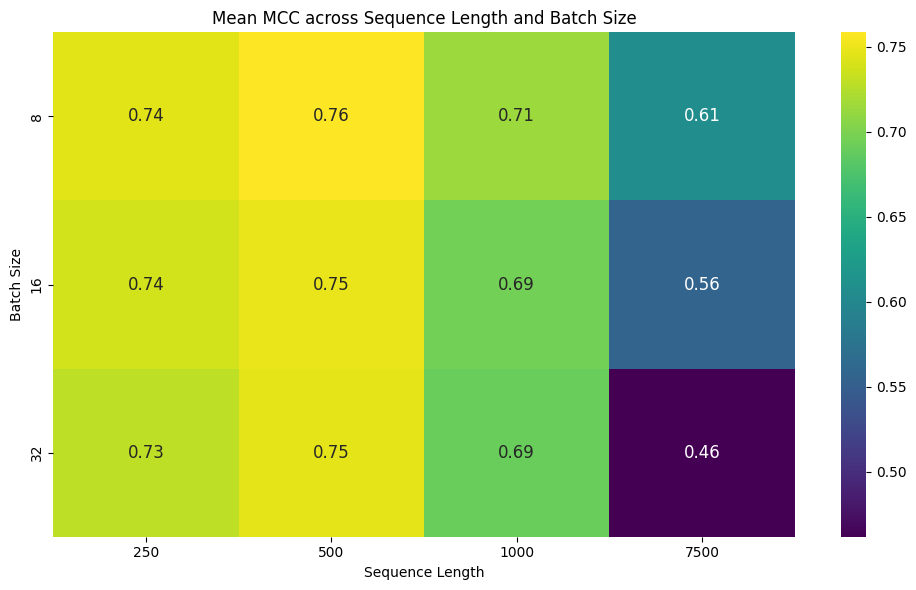

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Group and aggregate data for the new plot
agg_df_task_averaged = df.groupby(["SeqLen", "BatchSize"])["MCC"].agg(['mean', 'min', 'max']).reset_index()

print(agg_df_task_averaged)


# Pivot the DataFrame to create a matrix for the heatmap
# ... but first, convert BatchSize and SeqLen to string
agg_df_task_averaged['BatchSize'] = agg_df_task_averaged['BatchSize'].astype(str)
agg_df_task_averaged['SeqLen'] = agg_df_task_averaged['SeqLen'].astype(str)

heatmap_data = agg_df_task_averaged.pivot(index="BatchSize", columns="SeqLen", values="mean")


# Reorder the columns (x-axis) and index (y-axis)
desired_x_order = ['250', '500', '1000', '7500']  # Convert to strings to match column names
desired_y_order = ['8', '16', '32']  # Convert to strings to match index names

heatmap_data = heatmap_data.reindex(index=desired_y_order, columns=desired_x_order)

# Create the heatmap
plt.figure(figsize=(10, 6))
sns.heatmap(heatmap_data, annot=True, cmap="viridis", fmt=".2f", annot_kws={"size": 12})
plt.title("Mean MCC across Sequence Length and Batch Size")
plt.xlabel("Sequence Length")
plt.ylabel("Batch Size")
plt.tight_layout()
plt.show()

In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import tensorflow as tf

from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report, accuracy_score
from sklearn.model_selection import train_test_split

from tensorflow.keras import Model
# Re-import necessary library after execution state reset
from graphviz import Digraph

from sklearn.preprocessing import MinMaxScaler

import seaborn as sns
import os
import sys
import pickle

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
# Get the current working directory (where your notebook is)
current_directory = os.getcwd()

# Construct the full path to your data_utils.py file
analysis_utils_path = '/content/drive/MyDrive/Colab Notebooks/Bachelor Thesis/Thesis Files/'  # Replace with the actual path

# Add the directory containing data_utils.py to the Python path
# sys.path.append(os.path.dirname(analysis_utils_path))  # Add parent directory of data_utils.py
# Instead of appending the parent directory, append the actual directory
sys.path.append(analysis_utils_path)

# Now you can import the custom module
import analysis_utils as au
import data_utils as du

# Remove or comment out the line that resets the Python path
# sys.path = current_directory

In [ ]:
# ONLY FOR RELOAD!

# Reloads if the data_utils has been updated during runtime
# Always need to add and reset the paths
import importlib

# Add the directory containing data_utils.py to the Python path
sys.path.append(os.path.dirname(analysis_utils_path))  # Add parent directory of data_utils.py

importlib.reload(au)  # This reloads the module

sys.path = []

## Loading the data

In [ ]:
basePathAnalysis = "/content/drive/MyDrive/Colab Notebooks/Bachelor Thesis/Data/LSTM Analysis Data/"

multiClassPath = f"{basePathAnalysis}Multi_Models_and_Performances/New"

In [ ]:
# Example usage
train_test_path_special = f'{multiClassPath}/special_analysis_testing_splits_dict.pkl'
train_test_path = f'{multiClassPath}/short_analysis_testing_splits_dict.pkl'

tt_splits_dict = au.load_splits_dict(train_test_path)
tt_splits_dict_special = au.load_splits_dict(train_test_path_special)



Splits dictionary loaded from: /content/drive/MyDrive/Colab Notebooks/Bachelor Thesis/Data/LSTM Analysis Data/Multi_Models_and_Performances/New/short_analysis_testing_splits_dict.pkl
Splits dictionary loaded from: /content/drive/MyDrive/Colab Notebooks/Bachelor Thesis/Data/LSTM Analysis Data/Multi_Models_and_Performances/New/special_analysis_testing_splits_dict.pkl


In [ ]:
# Example usage:
analysis_path_special = f'{multiClassPath}/special_LSTM_hidden_data.pkl'
analysis_path = f'{multiClassPath}/LSTM_hidden_data.pkl'

extracted_data_dict = au.load_extracted_data(analysis_path)
extracted_data_dict_special = au.load_extracted_data(analysis_path_special)

Extracted data loaded from: /content/drive/MyDrive/Colab Notebooks/Bachelor Thesis/Data/LSTM Analysis Data/Multi_Models_and_Performances/New/LSTM_hidden_data.pkl
Extracted data loaded from: /content/drive/MyDrive/Colab Notebooks/Bachelor Thesis/Data/LSTM Analysis Data/Multi_Models_and_Performances/New/special_LSTM_hidden_data.pkl


In [ ]:
print("Structure of the saved dictionary:")
au.explain_dict_structure(extracted_data_dict)

# Example usage
print("Structure of the train/test dictionary:")
au.explain_dict_structure(tt_splits_dict)

Structure of the saved dictionary:
all_features_multi:
   hidden_states_activation:
      Shape: (20, 5, 7500, 32)
   model_predictions:
      Shape: (20, 5, 7500, 5)
   final_hidden_states:
      Shape: (20, 5, 32)
   final_cell_states:
      Shape: (20, 5, 32)
   dense_weights:
      Shape: (32, 5)
   dense_bias:
      Shape: (5,)

signal_multi:
   hidden_states_activation:
      Shape: (20, 5, 7500, 32)
   model_predictions:
      Shape: (20, 5, 7500, 5)
   final_hidden_states:
      Shape: (20, 5, 32)
   final_cell_states:
      Shape: (20, 5, 32)
   dense_weights:
      Shape: (32, 5)
   dense_bias:
      Shape: (5,)

hilbert_only_multi:
   hidden_states_activation:
      Shape: (20, 5, 7500, 32)
   model_predictions:
      Shape: (20, 5, 7500, 5)
   final_hidden_states:
      Shape: (20, 5, 32)
   final_cell_states:
      Shape: (20, 5, 32)
   dense_weights:
      Shape: (32, 5)
   dense_bias:
      Shape: (5,)

hilbert_included_multi:
   hidden_states_activation:
      Shape: (2

### Shaping the Data to necessary formats

In [ ]:

def add_dimension_to_arrays(data_dict):
  """Adds a new dimension at the beginning of each NumPy array in the dictionary.

  Args:
    data_dict: The dictionary containing NumPy arrays.

  Returns:
    The modified dictionary with the added dimension to each array.
  """
  for key, value in data_dict.items():
    # Check if the value is a dictionary (nested structure)
    if isinstance(value, dict):
      # Recursively call the function for nested dictionaries
      add_dimension_to_arrays(value)
    elif isinstance(value, np.ndarray):
      # Add a new dimension at the beginning using expand_dims
      data_dict[key] = np.expand_dims(value, axis=0)
  return data_dict

# Apply the function to your extracted_data_dict
extracted_data_dict = add_dimension_to_arrays(extracted_data_dict)

In [ ]:
def add_dimension_to_specific_arrays(data_dict):
  """Adds a new dimension at the beginning of NumPy arrays
  with keys 'dense_weights' or 'dense_bias'.

  Args:
    data_dict: The dictionary containing NumPy arrays.

  Returns:
    The modified dictionary with the added dimension to specific arrays.
  """
  for key, value in data_dict.items():
    # Check if the key is 'dense_weights' or 'dense_bias' and the value is a NumPy array
    if key in ("dense_weights", "dense_bias") and isinstance(value, np.ndarray):
      # Add a new dimension at the beginning using expand_dims
      data_dict[key] = np.expand_dims(value, axis=0)
    # Check if the value is a dictionary (nested structure)
    elif isinstance(value, dict):
        # Recursively call the function for nested dictionaries
        add_dimension_to_specific_arrays(value)
  return data_dict

# Apply the function to your extracted_data_dict
extracted_data_dict_special = add_dimension_to_specific_arrays(extracted_data_dict_special)

In [ ]:
# prompt: For every key in extracted_data_dict rename the subkey "model_predictions" to "epoch_model_predictions"

def rename_subkey(data_dict):
    """Renames the subkey "model_predictions" to "epoch_model_predictions" for every key in the input dictionary.

    Args:
    data_dict (dict): The input dictionary with nested structures.
    """
    for key in data_dict:
        if "model_predictions" in data_dict[key]:
            data_dict[key]["epoch_model_predictions"] = data_dict[key].pop("model_predictions")
    return data_dict

# Example usage (assuming extracted_data_dict is defined as in your provided code)
extracted_data_dict = rename_subkey(extracted_data_dict)
extracted_data_dict_special = rename_subkey(extracted_data_dict_special)

print("Structure of the saved dictionary after renaming:")



Structure of the saved dictionary after renaming:


In [ ]:
# prompt: Write me a function that takes a list of dicts and removes all keys from each dict in that list, that are contained in a list of strings containing the keys

def remove_keys_from_list_of_dicts(list_of_dicts, keys_to_remove):
    """Removes specified keys from each dictionary in a list of dictionaries.

    Args:
        list_of_dicts: A list of dictionaries.
        keys_to_remove: A list of keys to remove from each dictionary.

    Returns:
        A new list of dictionaries with the specified keys removed.
        Returns the original list if input is invalid.
    """

    if not isinstance(list_of_dicts, list):
        print("Error: Input must be a list of dictionaries.")
        return list_of_dicts

    for dictionary in list_of_dicts:
        if not isinstance(dictionary, dict):
            print("Error: Input list must contain only dictionaries.")
            return list_of_dicts

    new_list_of_dicts = []
    for dict_item in list_of_dicts:
        new_dict = {}
        for key, value in dict_item.items():
            if key not in keys_to_remove:
                new_dict[key] = value
        new_list_of_dicts.append(new_dict)
    return new_list_of_dicts

new_list_of_dicts = remove_keys_from_list_of_dicts(list_of_dicts=[extracted_data_dict, extracted_data_dict_special, tt_splits_dict, tt_splits_dict_special],
                               keys_to_remove=["hilbert_only_multi", "wavelet_only_multi"])

extracted_data_dict, extracted_data_dict_special, tt_splits_dict, tt_splits_dict_special = new_list_of_dicts


In [ ]:
au.explain_dict_structure(extracted_data_dict)
au.explain_dict_structure(tt_splits_dict_special)

all_features_multi:
   hidden_states_activation:
      Shape: (1, 20, 5, 7500, 32)
   final_hidden_states:
      Shape: (1, 20, 5, 32)
   final_cell_states:
      Shape: (1, 20, 5, 32)
   dense_weights:
      Shape: (1, 32, 5)
   dense_bias:
      Shape: (1, 5)
   epoch_model_predictions:
      Shape: (1, 20, 5, 7500, 5)

signal_multi:
   hidden_states_activation:
      Shape: (1, 20, 5, 7500, 32)
   final_hidden_states:
      Shape: (1, 20, 5, 32)
   final_cell_states:
      Shape: (1, 20, 5, 32)
   dense_weights:
      Shape: (1, 32, 5)
   dense_bias:
      Shape: (1, 5)
   epoch_model_predictions:
      Shape: (1, 20, 5, 7500, 5)

hilbert_included_multi:
   hidden_states_activation:
      Shape: (1, 20, 5, 7500, 32)
   final_hidden_states:
      Shape: (1, 20, 5, 32)
   final_cell_states:
      Shape: (1, 20, 5, 32)
   dense_weights:
      Shape: (1, 32, 5)
   dense_bias:
      Shape: (1, 5)
   epoch_model_predictions:
      Shape: (1, 20, 5, 7500, 5)

wavelet_inlcuded_multi:
   hid

# Performance Analysis

In [ ]:
def create_heatmap_model_freq_mcc(extracted_data_dict, tt_splits_dict, epoch=-1):
    """
    Creates a heatmap comparing model predictions with ground truth for different noise levels.

    Args:
        extracted_data_dict (dict): Dictionary containing extracted data from the models.
        tt_splits_dict (dict): Dictionary containing train-test splits.
        epoch (int, optional): The epoch to analyze. Defaults to -1 (last epoch).

    Returns:
        None: Displays the heatmap.
    """

    # Determine y-labels
    mean_freqs = np.logspace(np.log10(4), np.log10(100), num=20)
    mean_freqs_round = np.round(mean_freqs).astype(int)
    mean_freqs_round = [4, 5, 5.5, 6, 7, 8, 9, 10, 11, 12, 14, 16, 18, 22, 26, 35, 45, 60, 80, 100]

    # Updated model_label_names to include all keys from extracted_data_dict

    model_names = list(extracted_data_dict.keys())
    first_string = model_names.pop(0)  # Remove the first string
    model_names.append(first_string)

    print(model_names)

     # Generate model_label_names automatically from model_names
    model_label_names = ['Signal Only',
                         'Hilbert Included', 'Wavelet Included', 'All Features']  # Extended labels
    accuracy_matrix = []

    for model_name in model_names:
        model_accuracies = []
        for frequency in range(len(mean_freqs_round)):
            y_true = tt_splits_dict[model_name]['y_test'][frequency, :, :].flatten()
            y_pred = extracted_data_dict[model_name]['epoch_model_predictions'][epoch][frequency, :, :]

            noise_ratio, n_timesteps, n_cats  = y_pred.shape  # (7500, 5)

            y_pred = np.argmax(y_pred, axis=-1).flatten()

            mcc = matthews_corrcoef(y_true, y_pred)  # Calculate MCC
            accuracy = accuracy_score(y_true, y_pred)  # Calculate accuracy
            model_accuracies.append(mcc)
        accuracy_matrix.append(model_accuracies)

    # Create DataFrame for the heatmap
    df = pd.DataFrame(accuracy_matrix, index=model_label_names, columns=mean_freqs_round)

    # Create the heatmap
    plt.figure(figsize=(20, 6))
    sns.heatmap(df, annot=True, cmap="viridis", fmt=".2f", annot_kws={"size": 12})
    plt.title("Model Accuracies (MCC) across Frequency Values")
    plt.xlabel("Frequency in Hz")
    plt.ylabel("Model")
    plt.show()

In [ ]:
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.metrics import matthews_corrcoef  # Import MCC function
from sklearn.metrics import accuracy_score

def create_heatmap_model_freq_mcc_all(extracted_data_dict, tt_splits_dict, epoch=-1):
    """
    Creates heatmaps comparing model predictions with ground truth for different
    noise levels and frequencies, for all models in extracted_data_dict.

    Args:
        extracted_data_dict (dict): Dictionary containing extracted data from the models.
        tt_splits_dict (dict): Dictionary containing train-test splits.
        epoch (int, optional): The epoch to analyze. Defaults to -1 (last epoch).

    Returns:
        None: Displays the heatmaps for each model within a single plot, stacked vertically.
    """


    # Determine y-labels (frequencies)
    mean_freqs = np.logspace(np.log10(4), np.log10(100), num=20)
    mean_freqs_round = np.round(mean_freqs).astype(int)
    mean_freqs_round = [4, 5, 5.5, 6, 7, 8, 9, 10, 11, 12, 14, 16, 18, 22, 26, 30, 45, 60, 80, 100]


    noise_levels = [-8, -4, 0, 4, 8]

    model_names = list(extracted_data_dict.keys())
    first_string = model_names.pop(0)  # Remove the first string
    model_names.append(first_string)

    print(model_names)

     # Generate model_label_names automatically from model_names
    model_label_names = ['Signal Only', 'Hilbert Only',
                         'Hilbert Included', 'Wavelet Only', 'Wavelet Included', 'All Features']  # Extended labels

    num_models = len(model_names)  # Update to use actual model count

    # Create subplots (3 rows, 1 column) with shared x-axis
    fig, axes = plt.subplots(num_models, 1, figsize=(13, 4 * num_models), sharex=True)

    # Calculate overall min and max values for consistent color scale
    all_values = []
    for model_name in model_names:
        accuracy_matrix = []
        for noise_ratio in range(len(noise_levels)):
            model_accuracies = []
            for frequency in range(len(mean_freqs_round)):
                y_true = tt_splits_dict[model_name]['y_test'][frequency, noise_ratio, :].flatten()
                y_pred = extracted_data_dict[model_name]['epoch_model_predictions'][epoch][frequency, noise_ratio, :]

                n_timesteps, n_cats = y_pred.shape

                y_pred = np.argmax(y_pred, axis=-1).flatten()

                mcc = matthews_corrcoef(y_true, y_pred)  # Calculate MCC
                model_accuracies.append(mcc)
            accuracy_matrix.append(model_accuracies)
        all_values.extend(np.array(accuracy_matrix).flatten())  # Add all values to a single list

    vmin = min(all_values)
    vmax = max(all_values)

    # Loop through each model and its corresponding subplot
    for idx, (model_name, ax) in enumerate(zip(model_names, axes.flatten())):
        accuracy_matrix = []

        for noise_ratio in range(len(noise_levels)):
            model_accuracies = []
            for frequency in range(len(mean_freqs_round)):
                y_true = tt_splits_dict[model_name]['y_test'][frequency, noise_ratio, :].flatten()
                y_pred = extracted_data_dict[model_name]['epoch_model_predictions'][epoch][frequency, noise_ratio, :]

                n_timesteps, n_cats = y_pred.shape

                y_pred = np.argmax(y_pred, axis=-1).flatten()

                mcc = matthews_corrcoef(y_true, y_pred)  # Calculate MCC
                model_accuracies.append(mcc)
            accuracy_matrix.append(model_accuracies)

        # Create DataFrame for the heatmap for the current model
        df = pd.DataFrame(accuracy_matrix, index=noise_levels, columns=mean_freqs_round)

        # Create the heatmap on the current subplot with consistent color scale
        sns.heatmap(df, annot=True, cmap="viridis", fmt=".2f", annot_kws={"size": 10}, ax=ax, vmin=vmin, vmax=vmax)
        ax.set_title(f"Model Accuracy (MCC) - {model_label_names[idx]}")  # Use extended labels
        ax.set_ylabel("Noise Ratios in dB")

    # Common X-label for the entire plot
    plt.xlabel("Frequency in Hz")
    plt.tight_layout()
    plt.show()


In [ ]:
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.metrics import matthews_corrcoef  # Import MCC function
from sklearn.metrics import accuracy_score

def create_heatmap_model_noise_accuracy(extracted_data_dict, tt_splits_dict, epoch=-1):
    """
    Creates a heatmap comparing model predictions with ground truth for different noise levels.

    Args:
        extracted_data_dict (dict): Dictionary containing extracted data from the models.
        tt_splits_dict (dict): Dictionary containing train-test splits.
        epoch (int, optional): The epoch to analyze. Defaults to -1 (last epoch).

    Returns:
        None: Displays the heatmap.
    """

    noise_levels = [-8, -4, 0, 4, 8]  # Assuming these are your noise levels
    model_names = list(extracted_data_dict.keys())
    first_string = model_names.pop(0)  # Remove the first string
    model_names.append(first_string)

    print(model_names)

     # Generate model_label_names automatically from model_names
    model_label_names = ['Signal Only',
                         'Hilbert Included', 'Wavelet Included', 'All Features']  # Extended labels
    accuracy_matrix = []

    for model_name in model_names:
        model_accuracies = []
        for noise_ratio in range(len(noise_levels)):
            y_true = tt_splits_dict[model_name]['y_test'][:, noise_ratio, :].flatten()
            y_pred = extracted_data_dict[model_name]['epoch_model_predictions'][epoch][:, noise_ratio, :]

            frequencies, n_timesteps, n_cats  = y_pred.shape  # (7500, 5)

            y_pred = np.argmax(y_pred, axis=-1).flatten()

            mcc = matthews_corrcoef(y_true, y_pred)  # Calculate MCC
            accuracy = accuracy_score(y_true, y_pred)  # Calculate accuracy
            model_accuracies.append(mcc)
        accuracy_matrix.append(model_accuracies)

    # Create DataFrame for the heatmap
    df = pd.DataFrame(accuracy_matrix, index=model_label_names, columns=noise_levels)

    # Create the heatmap
    plt.figure(figsize=(12, 6))
    sns.heatmap(df, annot=True, cmap="viridis", fmt=".2f", annot_kws={"size": 12})
    plt.title("Multi Model MCC across Noise Levels")
    plt.xlabel("Noise Level (dB)")
    plt.ylabel("Model")
    plt.show()

In [ ]:
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.metrics import matthews_corrcoef  # Import MCC function
from sklearn.metrics import accuracy_score

def create_heatmap_category_noise_all_models(extracted_data_dict, tt_splits_dict, epoch=-1):
    """
    Creates heatmaps comparing model predictions with ground truth for different
    noise levels and categories, for all models in extracted_data_dict.

    Args:
        extracted_data_dict (dict): Dictionary containing extracted data from the models.
        tt_splits_dict (dict): Dictionary containing train-test splits.
        epoch (int, optional): The epoch to analyze. Defaults to -1 (last epoch).

    Returns:
        None: Displays the heatmaps for each model within a single plot.
    """

    noise_levels = [-8, -4, 0, 4, 8]
    categories = ["noise", "theta", "alpha", "beta", "gamma"]
    model_names = list(extracted_data_dict.keys())
    first_string = model_names.pop(0)  # Remove the first string
    model_names.append(first_string)

    print(model_names)

     # Generate model_label_names automatically from model_names
    model_label_names = ['Signal Only', 'Hilbert Only',
                         'Hilbert Included', 'Wavelet Only', 'Wavelet Included', 'All Features']  # Extended labels

    # Change order the models are processed in


    num_models = len(model_names)

    # Determine grid layout based on the number of models
    num_rows = 1 if num_models <= 3 else 2  # 1 row for up to 3 models, 2 rows for 4-6 models
    num_cols = min(num_models, 3)  # Up to 3 columns


    # Create subplots (1 row, 3 columns)
    fig, axes = plt.subplots(num_rows, num_cols, figsize=(20, 5 * num_rows), sharey=True)  # sharey for common y-axis

    # Loop through each model and its corresponding subplot
    for idx, (model_name, ax) in enumerate(zip(model_names, axes.flatten())):
        accuracy_matrix = []

        for noise_ratio in range(len(noise_levels)):
            category_accuracies = []

            y_true = tt_splits_dict[model_name]['y_test'][:, noise_ratio, :]
            y_pred = extracted_data_dict[model_name]['epoch_model_predictions'][epoch][:, noise_ratio, :]

            # Convert probability predictions to class labels using argmax
            y_pred = np.argmax(y_pred, axis=-1)

            y_true_flat = y_true.flatten()
            y_pred_flat = y_pred.flatten()

            for category in range(len(categories)):
                # Convert to binary for MCC calculation
                y_true_binary = (y_true_flat == category).astype(int)
                y_pred_binary = (y_pred_flat == category).astype(int)

                # Compute MCC and append
                mcc = matthews_corrcoef(y_true_binary, y_pred_binary)
                category_accuracies.append(mcc)

            accuracy_matrix.append(category_accuracies)

        # Create DataFrame for the heatmap for the current model
        df = pd.DataFrame(accuracy_matrix, index=noise_levels, columns=categories)

        # Create the heatmap on the current subplot
        sns.heatmap(df, annot=True, cmap="viridis", fmt=".2f", annot_kws={"size": 12}, ax=ax)
        ax.set_title(f"Model Accuracy (MCC) - {model_label_names[idx]}")
        ax.set_xlabel("Category")
        ax.set_ylabel("Noise Ratios in dB")

    # Adjust layout and display the plot
    plt.tight_layout()
    plt.show()

In [ ]:
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.metrics import matthews_corrcoef  # Import MCC function

def create_heatmap_category_all_models(extracted_data_dict, tt_splits_dict, epoch=-1):
    """
    Creates a single heatmap comparing model predictions with ground truth for different
    categories, summing MCC values across noise levels for all models.

    Args:
        extracted_data_dict (dict): Dictionary containing extracted data from the models.
        tt_splits_dict (dict): Dictionary containing train-test splits.
        epoch (int, optional): The epoch to analyze. Defaults to -1 (last epoch).

    Returns:
        None: Displays the single heatmap.
    """

    categories = ["noise", "theta", "alpha", "beta", "gamma"]
    model_names = list(extracted_data_dict.keys())
    first_string = model_names.pop(0)  # Remove the first string
    model_names.append(first_string)

    print(model_names)

     # Generate model_label_names automatically from model_names
    model_label_names = ['Signal Only',
                         'Hilbert Included', 'Wavelet Included', 'All Features']  # Extended labels
    num_models = len(model_names)

    accuracy_matrix = []  # Store summed MCC values for each model and category

    # Loop through each model
    for model_name in model_names:
        model_accuracies = []  # Store MCC values for this model

        y_true_all_noise = tt_splits_dict[model_name]['y_test']  # All noise levels
        y_pred_all_noise = extracted_data_dict[model_name]['epoch_model_predictions'][epoch]  # All noise levels

        # Convert probability predictions to class labels using argmax
        y_pred_all_noise = np.argmax(y_pred_all_noise, axis=-1)

        y_true_flat = y_true_all_noise.flatten()
        y_pred_flat = y_pred_all_noise.flatten()

        # Loop through each category
        for category in range(len(categories)):
            # Convert to binary for MCC calculation
            y_true_binary = (y_true_flat == category).astype(int)
            y_pred_binary = (y_pred_flat == category).astype(int)

            # Compute MCC and append
            mcc = matthews_corrcoef(y_true_binary, y_pred_binary)
            model_accuracies.append(mcc)

        accuracy_matrix.append(model_accuracies)  # Add this model's accuracies to the main matrix

    # Create DataFrame for the single heatmap
    df = pd.DataFrame(accuracy_matrix, index=model_label_names, columns=categories)

    # Create the single heatmap
    plt.figure(figsize=(12, 6))  # Adjust figure size if needed
    sns.heatmap(df, annot=True, cmap="viridis", fmt=".2f", annot_kws={"size": 12})
    plt.title("Model Accuracy (MCC) - Summed Noise Levels")
    plt.xlabel("Category")
    plt.ylabel("Model")
    plt.tight_layout()
    plt.show()

In [ ]:
extracted_data_dict["signal_multi"].keys()

dict_keys(['hidden_states_activation', 'final_hidden_states', 'final_cell_states', 'dense_weights', 'dense_bias', 'epoch_model_predictions'])

['signal_multi', 'hilbert_included_multi', 'wavelet_inlcuded_multi', 'all_features_multi']


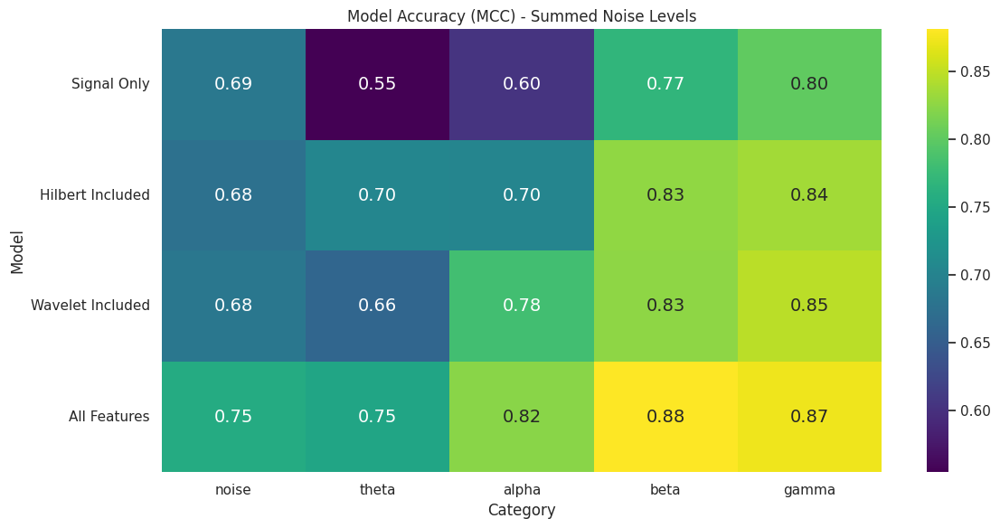

In [ ]:
# create_heatmap_category_noise_all_models(extracted_data_dict, tt_splits_dict)
create_heatmap_category_all_models(extracted_data_dict, tt_splits_dict)

['signal_multi', 'hilbert_included_multi', 'wavelet_inlcuded_multi', 'all_features_multi']


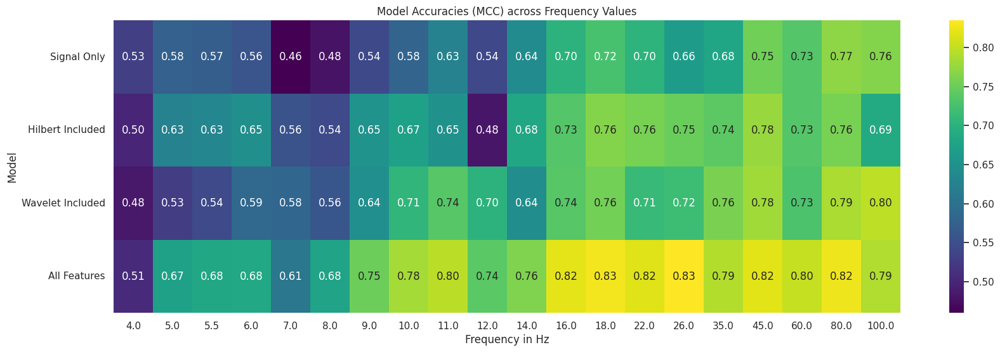

In [ ]:
create_heatmap_model_freq_mcc(extracted_data_dict, tt_splits_dict, epoch=-1)  # Use default last epoch (-1)

['signal_multi', 'hilbert_included_multi', 'wavelet_inlcuded_multi', 'all_features_multi']


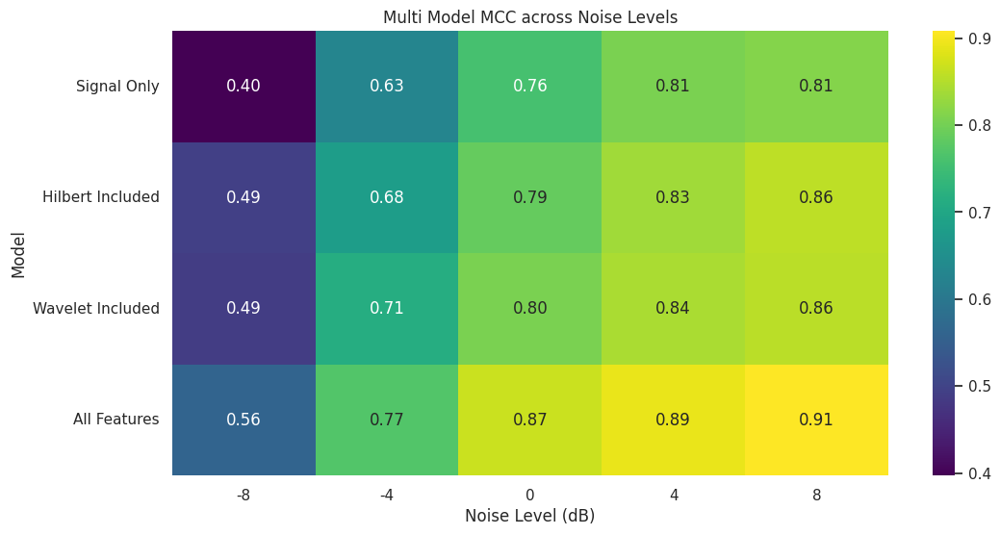

In [ ]:
create_heatmap_model_noise_accuracy(extracted_data_dict, tt_splits_dict, epoch=-1)  # Use default last epoch (-1)


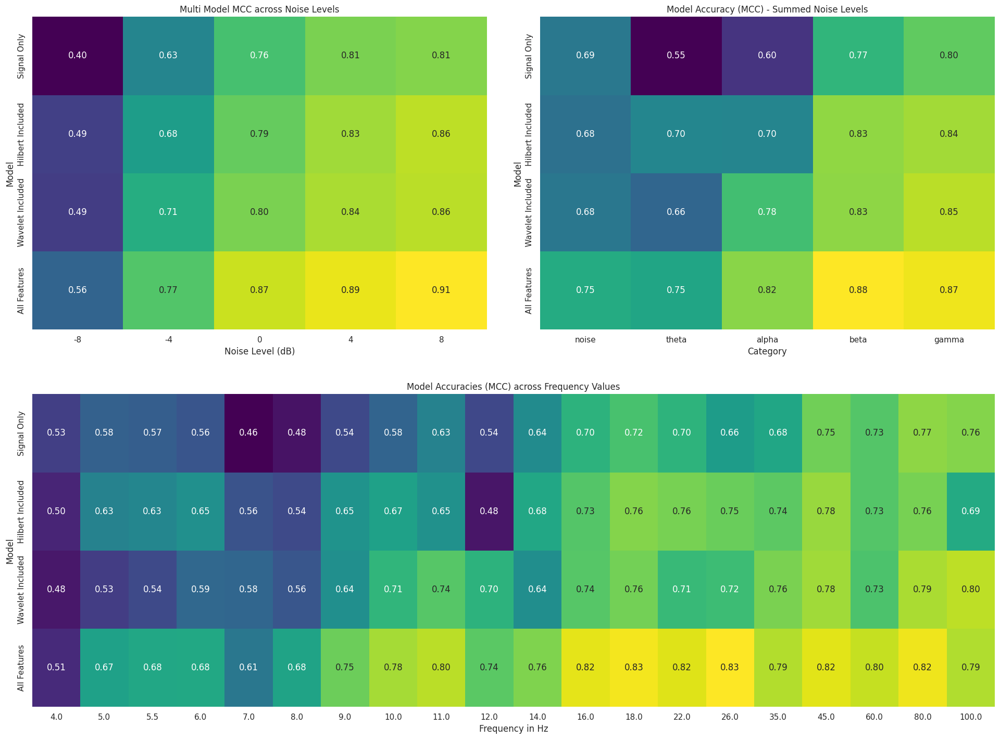

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
import pandas as pd
from sklearn.metrics import matthews_corrcoef, accuracy_score

def create_combined_heatmap(extracted_data_dict, tt_splits_dict, epoch=-1):
    """Combines the three heatmaps into a single larger plot."""

    # Define parameters
    mean_freqs_round = [4, 5, 5.5, 6, 7, 8, 9, 10, 11, 12, 14, 16, 18, 22, 26, 35, 45, 60, 80, 100]
    noise_levels = [-8, -4, 0, 4, 8]
    categories = ["noise", "theta", "alpha", "beta", "gamma"]
    model_names = list(extracted_data_dict.keys())
    first_string = model_names.pop(0)
    model_names.append(first_string)
    model_label_names = ['Signal Only', 'Hilbert Included', 'Wavelet Included', 'All Features']

    # Function to calculate MCC
    def calculate_mcc(y_true, y_pred):
        return matthews_corrcoef(y_true, np.argmax(y_pred, axis=-1).flatten())

    # Create figure and axes using GridSpec for more control over layout
    fig = plt.figure(figsize=(20, 15))  # Adjust figsize as needed
    gs = fig.add_gridspec(2, 2)  # 2 rows, 2 columns

    # Axes for the heatmaps
    ax1 = fig.add_subplot(gs[1, :])  # Top row, spanning both columns
    ax2 = fig.add_subplot(gs[0, 0])  # Bottom row, left column
    ax3 = fig.add_subplot(gs[0, 1])  # Bottom row, right column


    # 1. Frequency vs. MCC Heatmap (ax1)
    accuracy_matrix_freq = []
    for model_name in model_names:
        model_accuracies = []
        for frequency in mean_freqs_round:
            y_true = tt_splits_dict[model_name]['y_test'][mean_freqs_round.index(frequency), :, :].flatten()
            y_pred = extracted_data_dict[model_name]['epoch_model_predictions'][epoch][mean_freqs_round.index(frequency), :, :]
            model_accuracies.append(calculate_mcc(y_true, y_pred))
        accuracy_matrix_freq.append(model_accuracies)
    df_freq = pd.DataFrame(accuracy_matrix_freq, index=model_label_names, columns=mean_freqs_round)
    sns.heatmap(df_freq,
                annot=True,
                cmap="viridis",
                fmt=".2f",
                annot_kws={"size": 12},
                cbar=False,
                ax=ax1)
    ax1.set_title("Model Accuracies (MCC) across Frequency Values")
    ax1.set_xlabel("Frequency in Hz")  # X-axis label for ax1
    ax1.set_ylabel("Model")  # Y-axis label for ax1


    # 2. Noise vs. MCC Heatmap (ax2)
    accuracy_matrix_noise = []
    for model_name in model_names:
      model_accuracies = []
      for noise_ratio in range(len(noise_levels)):
          y_true = tt_splits_dict[model_name]['y_test'][:, noise_ratio, :].flatten()
          y_pred = extracted_data_dict[model_name]['epoch_model_predictions'][epoch][:, noise_ratio, :]
          model_accuracies.append(calculate_mcc(y_true, y_pred))
      accuracy_matrix_noise.append(model_accuracies)
    df_noise = pd.DataFrame(accuracy_matrix_noise, index=model_label_names, columns=noise_levels)
    sns.heatmap(df_noise,
                annot=True,
                cmap="viridis",
                fmt=".2f",
                annot_kws={"size": 12},
                cbar=False,
                ax=ax2)
    ax2.set_title("Multi Model MCC across Noise Levels")
    ax2.set_xlabel("Noise Level (dB)")  # X-axis label for ax2
    ax2.set_ylabel("Model")  # Y-axis label for ax2


    # 3. Category vs. MCC Heatmap (ax3)
    accuracy_matrix_category = []
    for model_name in model_names:
        model_accuracies = []
        y_true_all_noise = tt_splits_dict[model_name]['y_test']
        y_pred_all_noise = extracted_data_dict[model_name]['epoch_model_predictions'][epoch]
        y_pred_all_noise = np.argmax(y_pred_all_noise, axis=-1)

        y_true_flat = y_true_all_noise.flatten()
        y_pred_flat = y_pred_all_noise.flatten()

        for category in range(len(categories)):
            y_true_binary = (y_true_flat == category).astype(int)
            y_pred_binary = (y_pred_flat == category).astype(int)
            mcc = matthews_corrcoef(y_true_binary, y_pred_binary)
            model_accuracies.append(mcc)
        accuracy_matrix_category.append(model_accuracies)
    df_category = pd.DataFrame(accuracy_matrix_category, index=model_label_names, columns=categories)
    sns.heatmap(df_category,
                annot=True,
                cmap="viridis",
                fmt=".2f",
                annot_kws={"size": 12},
                cbar=False,
                ax=ax3)
    ax3.set_title("Model Accuracy (MCC) - Summed Noise Levels")
    ax3.set_xlabel("Category")  # X-axis label for ax3
    ax3.set_ylabel("Model")  # Y-axis label for ax3


    plt.tight_layout(pad=3.0)  # Add padding between subplots
    plt.show()

create_combined_heatmap(extracted_data_dict, tt_splits_dict, epoch=-1)

In [ ]:
extracted_data_dict.keys()

dict_keys(['all_features_multi', 'signal_multi', 'hilbert_only_multi', 'hilbert_included_multi', 'wavelet_only_multi', 'wavelet_inlcuded_multi'])

The Hilbert Model is very interesting, because it struggles quite a bit with the edge case scenarios. Otherwise it can perform very well. I guess the frequency bands assigned, potentially have too little overlap. It is not guaranteed though that more overlap would solve this issue.

# Simple Analysis

## Analyze Dense Cell weights

By accessing the final dense layer we can determine which LSTM Cells had the biggest weight, and therefore the biggest influence on the final prediction.

By analyzing the d_weights and d_bias values across epochs or layers, you can gain insights into how the network processes information and adjusts its focus on different features.

### Helper Functions

In [ ]:
def rank_by_absolute_value(array):
    """
    Ranks the elements of an array by their absolute values, preserving their original values.
    Also calculates and returns the min, max, median, and mean of the array.

    Args:
        array (np.ndarray): Input 1D NumPy array.

    Returns:
        tuple: (ranked_list, min_val, max_val, median_val, mean_val)
    """
    sorted_indices = np.argsort(np.abs(array))[::-1]
    sorted_by_abs = array[sorted_indices]
    ranked_list = [(rank + 1, index, value) for rank, (index, value) in enumerate(zip(sorted_indices, sorted_by_abs))]

    min_val = np.min(array)
    max_val = np.max(array)
    median_val = np.median(array)
    mean_val = np.mean(array)

    return ranked_list, min_val, max_val, median_val, mean_val

In [ ]:
def unrank_weights(ranked_weights, ranked_indices):
    """Unranks a list of ranked weights and indices to their original positions.

    Args:
        ranked_weights (list): The list of ranked weights.
        ranked_indices (list): The list of corresponding ranked indices.
        original_length (int): The original length of the unranked list.

    Returns:
        list: The unranked list of weights.
    """

    unranked_weights = [0] * len(ranked_weights)  # Initialize with zeros

    # Place ranked weights back into their original positions
    for weight, index in zip(ranked_weights, ranked_indices):
        unranked_weights[index] = weight

    return unranked_weights  # Return the unranked list

In [ ]:
def rank_dense_weights_for_all_models_multi_summed(extracted_data_dict, epoch=-1, top_n=None, ranked=True):
    """Ranks and displays the dense weights for all models in the extracted
    data dictionary after summing them across dense_cell_id for a specific epoch.

    Args:
        extracted_data_dict (dict): Dictionary containing extracted data from the models.
        epoch (int, optional): The epoch to analyze. Defaults to -1 (last epoch).
        top_n (int, optional): The number of top LSTM cells to display. Defaults to 5.
    Returns:
        dict: A dictionary containing ranked cell indices and weights for each model.
    """
    ranked_weights_dict = {}  # Initialize the dictionary to store results
    for model_name, model_data in extracted_data_dict.items():
        # Dense weights have shape (epoch, hidden_layer_cell_weight, dense_cell_id)
        dense_weights = model_data['dense_weights']

        # Sum weights across dense_cell_id (axis=2) for the specified epoch
        summed_weights_for_epoch = np.sum(dense_weights[epoch], axis=1)

        # Rank summed weights for the specified epoch
        ranked_weights, min_val, max_val, median_val, mean_val = au.rank_by_absolute_value(summed_weights_for_epoch)


         # Extract cell indices and weights
         # This one will keep all cells just in case
        ranked_cell_indices = np.array([item[1] for item in ranked_weights])
        ranked_dense_weights = np.array([item[2] for item in ranked_weights])

        # Store results in the dictionary
        ranked_weights_dict[model_name] = {
            'ranked_cell_indices': ranked_cell_indices,
            'ranked_dense_weights': ranked_dense_weights
        }

        # Create DataFrame (without styling)
        df = pd.DataFrame(ranked_weights, columns=['Rank', 'Cell Index', 'Dense Weight'])
        df = df.set_index('Rank')  # Set 'Rank' as the index

        if top_n:
          # Display only the top_n LSTM cells
          df = df.head(top_n)

        # Display DataFrame with basic formatting
        print(f"\nModel: {model_name} (Epoch {epoch}, Top {top_n} Cells)")
        print(f"Min: {min_val:.4f}, Max: {max_val:.4f}, Median: {median_val:.4f}, Mean: {mean_val:.4f}")
        print(df.to_string())  # Use to_string() for basic formatting
    return ranked_weights_dict

In [ ]:
def calculate_weighted_activations(lstm_outputs, dense_weights, dense_bias):
    """Calculates the weighted contributions of LSTM cells to the final output.

    Args:
        lstm_outputs (np.ndarray): The output of the LSTM layer (shape: [lstm_units, timesteps]).
        dense_weights (np.ndarray): The weights of the dense layer (shape: [lstm_units]).
        dense_bias (float): The bias of the dense layer (single float value).

    Returns:
        np.ndarray: The weighted activations of the LSTM cells (shape: [lstm_units, timesteps]).
    """
    # Convert dense_weights to a NumPy array if it's a list
    dense_weights = np.array(dense_weights).T

    # Apply weights and bias to LSTM outputs
    weighted_activations = (lstm_outputs * dense_weights[:, np.newaxis]) + dense_bias

    return weighted_activations  # Return the weighted activations

In [ ]:
def create_heatmap_from_ranked_dense_weights(data_dict, absolute=False):
    """Creates a heatmap from a dictionary of ranked dense weights.

    Args:
        data_dict (dict): A dictionary where keys represent categories
                          and values are dictionaries containing
                          'ranked_dense_weights' as a key with a list
                          of 32 entries as its value.

    Returns:
        None: Displays the heatmap.
    """

    categories = list(data_dict.keys())

    cell_weights = []
    for category in categories:
        cell_weights.append(data_dict[category]['ranked_dense_weights'])
    categories = ["noise", "theta", "alpha", "beta", "gamma"]  # Define categories

    num_cells = len(cell_weights[0])
    # Create a Pandas DataFrame
    df = pd.DataFrame(cell_weights, index=categories, columns=range(1, num_cells + 1)).T  # Columns labeled 1-32
    df.columns = categories
    df.index.name = "Cell Weights"

    if absolute:
        df = np.abs(df)


    # Create the heatmap
    plt.figure(figsize=(12, 9))  # Adjust figure size if needed
    sns.heatmap(df,annot=True, cmap=sns.color_palette("coolwarm", as_cmap=True), fmt=f"=0.2f")
    plt.title('Heatmap of Ranked Dense Weights')
    plt.xlabel('Cell Weights (1-32)')
    plt.ylabel('Categories')
    plt.show()

# Example usage with your data_dict:
# Assuming your dictionary is called 'ranked_weights'

# create_heatmap_from_ranked_dense_weights(ranked_weights)

In [ ]:
def rank_dense_weights_for_all_models_multi(extracted_data_dict, epoch=-1, top_n=None, display=False, ranked=True):
    """Ranks and displays the dense weights for all models in the extracted data dictionary.

    Args:
        extracted_data_dict (dict): Dictionary containing extracted data from the models.
        epoch (int, optional): The epoch to analyze. Defaults to -1 (last epoch).
        top_n (int, optional): The number of top cells to display. If None, displays all cells. Defaults to None.

    Returns:
        dict: A dictionary containing ranked cell indices and weights for each model,
               organized by dense_cell_id. The structure is:
               {
                   'model_name': {
                       'dense_cell_id_1': {
                           'ranked_cell_indices': [list of cell indices],
                           'ranked_dense_weights': [list of corresponding weights]
                       },
                       ...},
                   ... }
    """

    ranked_weights_dict = {}

    for model_name, model_data in extracted_data_dict.items():

        ranked_weights_dict[model_name] = {}

        # Dense weights have shape (epoch, lstm_hidden_layer_weight, cell_id)
        dense_weights = model_data['dense_weights']
        # Select weights for the specified epoch
        weights_for_epoch = dense_weights[epoch]

        # Transpose, to loop over each dense cell and not the lstm weights
        weights_for_epoch = weights_for_epoch.T

        # Enumerate to get the index (dense cell ID)
        for dense_cell_id, dense_cells in enumerate(weights_for_epoch):
            # Rank weights using dense_cell instead of weights_for_epoch
            ranked_weights, min_val, max_val, median_val, mean_val = rank_by_absolute_value(dense_cells)

            # This is for storage for later
            ranked_cell_indices = np.array([item[1] for item in ranked_weights])
            ranked_dense_weights = np.array([item[2] for item in ranked_weights])

            if ranked == False:
                ranked_dense_weights = np.array(unrank_weights(ranked_dense_weights, ranked_cell_indices))
                ranked_cell_indices = np.array(range(len(ranked_dense_weights)))
                 # Create DataFrame (without styling)
                df = pd.DataFrame({'Cell Index': ranked_cell_indices, 'Dense Weight': ranked_dense_weights})
            else:
                df = pd.DataFrame(ranked_weights, columns=['Rank', 'Cell Index', 'Dense Weight'])
                df = df.set_index('Rank')  # Set 'Rank' as the index

            # Store results for the current dense_cell_id
            ranked_weights_dict[model_name][dense_cell_id] = {
                'ranked_cell_indices': ranked_cell_indices,
                'ranked_dense_weights': ranked_dense_weights
            }

            # Display only top_n cells if specified
            if top_n is not None:
                df = df.head(top_n)  # Select only the top_n rows
            if display:
                # Display DataFrame with basic formatting, using dense_cell_id instead of model_name
                print(f"\nDense Cell ID: {dense_cell_id} (Epoch {epoch})")
                print(f"Min: {min_val:.4f}, Max: {max_val:.4f}, Median: {median_val:.4f}, Mean: {mean_val:.4f}")
                print(df.to_string())  # Use to_string() for basic formatting
    return ranked_weights_dict

In [ ]:
def plot_dense_weights_evolution(dense_weights_3d, custom_epochs=None):
    """Plots the evolution of dense weights for each dense cell in a grid.

    Args:
        dense_weights_3d (np.ndarray): A 3-dimensional array of dense weights
                                       with shape (epochs, lstm_units, dense_cells).
        custom_epochs (list, optional): A list of custom epoch values for the x-axis.
                                        If None, the default range is used. Defaults to None.
    """

    num_dense_cells = dense_weights_3d.shape[2]  # Get the number of dense cells

    # Create a grid of subplots
    fig, axes = plt.subplots(1, num_dense_cells, figsize=(15, 6), sharex=True, sharey=True)

    # Determine x-axis values (epochs)
    x_values = custom_epochs if custom_epochs is not None else range(dense_weights_3d.shape[0])

    # Iterate over each dense cell
    for dense_cell_id in range(num_dense_cells):
        dense_weights_cell = dense_weights_3d[:, :, dense_cell_id]  # Select weights for this dense cell

        # Reshape for plotting
        dense_weights_cell = dense_weights_cell.reshape(dense_weights_cell.shape[0], dense_weights_cell.shape[1])

        # Get the current subplot axis
        ax = axes[dense_cell_id]

        # Plot the weights for each LSTM cell within this dense cell
        for lstm_cell_id in range(dense_weights_cell.shape[1]):
            ax.plot(x_values, dense_weights_cell[:, lstm_cell_id],
                    label=f"LSTM Cell {lstm_cell_id + 1}")

        # Add title and labels to the subplot
        ax.set_title(f"Dense Cell {dense_cell_id + 1}")
        ax.set_xlabel("Epoch")
        ax.set_ylabel("Dense Weight")
        ax.set_ylabel("Dense Weight")

    # Add a common legend to the figure, in multiple rows at the bottom
    handles, labels = axes[0].get_legend_handles_labels()  # Get handles and labels from the first subplot
    num_cols = 7  # Number of columns in the legend
    num_rows = int(np.ceil(len(labels) / num_cols))  # Calculate number of rows
    fig.legend(handles, labels, loc='lower center', ncol=num_cols,  # Place legend at the bottom center
               bbox_to_anchor=(0.5, 0.05), fontsize=8)  # Adjust position and font size

    fig.suptitle("Evolution of Dense Weights for Each Dense Cell")
    plt.tight_layout()
    plt.subplots_adjust(bottom=0.3)  # Add more space at the bottom for the legend
    plt.show()

### Implementation

In [ ]:
# I am assuming that each of the Dense cells has different top performers
# Each Cell possibly referencing a different frequency range

# ranked_weights = rank_dense_weights_for_all_models_multi(extracted_data_dict, top_n=5, display=False, ranked=False)  # Ranks weights for the last epoch

ranked_weights = rank_dense_weights_for_all_models_multi(extracted_data_dict)

In [ ]:
create_heatmap_from_ranked_dense_weights(ranked_weights['mid_noise_all_features_multi'], absolute=False)

KeyError: 'mid_noise_all_features_multi'

In [ ]:
create_heatmap_from_ranked_dense_weights(ranked_weights['mid_noise_signal_multi'], absolute=True)

This is actually as interesting as I had hoped.

Each dense cell often has very different weights for the different LSTM cells.

Some LSTM Cell seem to be favored by multiple dense cells.

**Next:**

I want to sum the cells weights and see which cell have the most weight overall


In [ ]:
summed_dense_weights_ranked = rank_dense_weights_for_all_models_multi_summed(extracted_data_dict, top_n=10)

In [ ]:
au.explain_dict_structure(ranked_weights)

Maybe this will be useful later

In [ ]:
extracted_data_dict.keys()

In [ ]:
dense_weights_signal = extracted_data_dict['mid_noise_signal_multi']['dense_weights']
dense_weights_hilbert = extracted_data_dict['mid_noise_hilbert_multi']['dense_weights']
dense_weights_feature = extracted_data_dict['mid_noise_all_features_multi']['dense_weights']

custom_epochs = [1,5,10,15,20]

plot_dense_weights_evolution(dense_weights_signal, custom_epochs=custom_epochs)
plot_dense_weights_evolution(dense_weights_hilbert, custom_epochs=custom_epochs)
plot_dense_weights_evolution(dense_weights_feature, custom_epochs=custom_epochs)

This Graph tells us that generally speaking the we have stronger Cell weights than with binary data. It may have to do with the fact, that the higher order predictions try to aim for a higher total value predictions.

Instead of (0 or 1) it must be one of (0,1,2,3,4)

## LSTM Final Cell States

This is actually useless knowledge unless we know how the specific sample ends.

The final cell state is a long-term memory state value but it is still probably only longterm for at most 100 timesteps. Mostlikely, actually less.

Since our sequences are 15000 timesteps it heavily depends on whether a sequence ends on a burst or noise signal, what the final cell state represents

In [ ]:
def plot_specific_cell_state_evolution(cell_states, cell_index=1, custom_epochs=None):
    """Plots the evolution of a specific cell state's value for all samples over epochs.

    Args:
        cell_states (np.ndarray): The final cell states of the LSTM (shape: [epochs, samples, cell states]).
        cell_index (int, optional): The index of the cell state to plot. Defaults to 1.
        custom_epochs (list, optional): A list of custom epoch values for the x-axis. If None, the default range is used. Defaults to None.
    """

    specific_cell = cell_states[:, :, cell_index]
    x_values = custom_epochs if custom_epochs is not None else range(cell_states.shape[0])

    plt.figure(figsize=(12, 6))
    for i in range(specific_cell.shape[1]):  # Iterate over samples
        plt.plot(x_values, specific_cell[:, i], label=f"Sample {i+1}")

    plt.title(f"Evolution of Cell {cell_index + 1} State Value per Sample over Epochs")
    plt.xlabel("Epoch")
    plt.ylabel("Cell State Value")
    plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', fontsize='small')
    plt.tight_layout()
    plt.show()


def plot_mean_cell_state_evolution(cell_states, custom_epochs=None):
    """Plots the evolution of the mean cell states over epochs.

    Args:
        cell_states (np.ndarray): The final cell states of the LSTM (shape: [epochs, samples, cell states]).
        custom_epochs (list, optional): A list of custom epoch values for the x-axis. If None, the default range is used. Defaults to None.
    """

    mean_states = np.mean(cell_states, axis=1)  # Mean across samples
    x_values = custom_epochs if custom_epochs is not None else range(cell_states.shape[0])

    plt.figure(figsize=(12, 6))
    for i in range(mean_states.shape[1]):  # Iterate over cell states
        plt.plot(x_values, mean_states[:, i], label=f"Cell State {i+1}")

    plt.title("Evolution of Mean Cell States over Epochs")
    plt.xlabel("Epoch")
    plt.ylabel("Mean Cell State Value")
    plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', fontsize='small')
    plt.tight_layout()
    plt.show()

def visualize_lstm_cell_states(cell_states, custom_epochs=None):
    """
    Visualizes the evolution of LSTM cell states over epochs.

    Args:
        cell_states (np.ndarray): The LSTM cell states with shape (epochs, samples, num_cells).
        custom_epochs (list or np.ndarray, optional): A list or array of custom epoch values
                                                      to use for the x-axis. If None, the default
                                                      range of epochs is used. Defaults to None.
    """
    epochs, samples, num_cells = cell_states.shape

    # Create a grid of subplots
    n_rows = int(np.ceil(np.sqrt(num_cells)))
    n_cols = n_rows
    fig, axes = plt.subplots(n_rows, n_cols, figsize=(15, 15))
    axes = axes.flatten()

    # Determine x-axis values
    x_values = custom_epochs if custom_epochs is not None else range(epochs)

    # Loop through each cell and plot its statistics
    for cell_index in range(num_cells):
        chosen_cell = cell_states[:, :, cell_index]

        # Compute statistics
        mean_cell = np.mean(chosen_cell, axis=1)
        variance_cell = np.var(chosen_cell, axis=1)
        min_cell = np.min(chosen_cell, axis=1)
        max_cell = np.max(chosen_cell, axis=1)

        # Plot on the respective subplot using x_values
        ax = axes[cell_index]
        ax.plot(x_values, mean_cell, label="Mean", color="blue")
        ax.fill_between(
            x_values,  # Use x_values here
            mean_cell - variance_cell,
            mean_cell + variance_cell,
            color="blue",
            alpha=0.2,
            label="Variance"
        )
        ax.plot(x_values, min_cell, label="Min", color="green", linestyle="--")  # Use x_values here
        ax.plot(x_values, max_cell, label="Max", color="red", linestyle="--")  # Use x_values here

        # Add title and format
        ax.set_title(f"Cell {cell_index + 1}")
        ax.set_xlabel("Epoch")
        ax.set_ylabel("Cell State Value")

    # Remove extra subplots if any
    for i in range(num_cells, len(axes)):
        fig.delaxes(axes[i])

    # Add legend for the first plot only
    axes[0].legend(loc="upper right", fontsize=8)

    fig.suptitle("The final LSTM Cell States after each sample runthrough at each epoch in training")
    plt.tight_layout(rect=[0, 0, 1, 0.98])
    plt.show()

<ipython-input-23-b1e3fbb8093d>:21: UserWarning: Tight layout not applied. The bottom and top margins cannot be made large enough to accommodate all Axes decorations.
  plt.tight_layout()


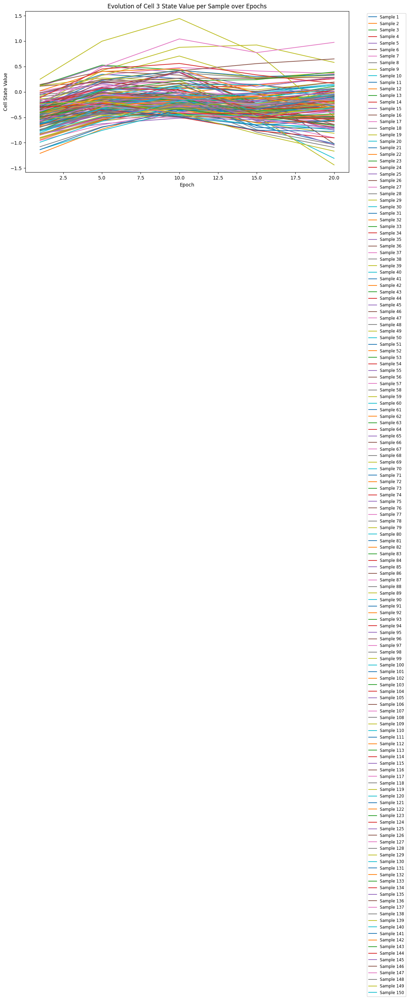

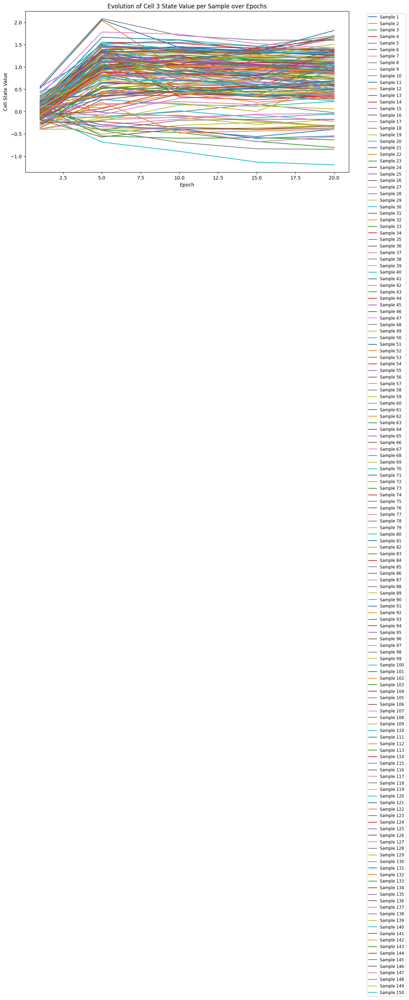

In [ ]:
cell_states_signal = extracted_data_dict['mid_noise_signal_multi']['final_cell_states']
cell_states_features = extracted_data_dict['mid_noise_hilbert_multi']['final_cell_states']

# Assuming 'cell_states_low' is your cell states data
plot_specific_cell_state_evolution(cell_states_signal,   cell_index=2, custom_epochs=custom_epochs)  # Plot cell state 3 with custom epochs
plot_specific_cell_state_evolution(cell_states_features, cell_index=2, custom_epochs=custom_epochs)  # Plot cell state 3 with custom epochs


This is actually useless knowledge unless we know how the specific sample ends

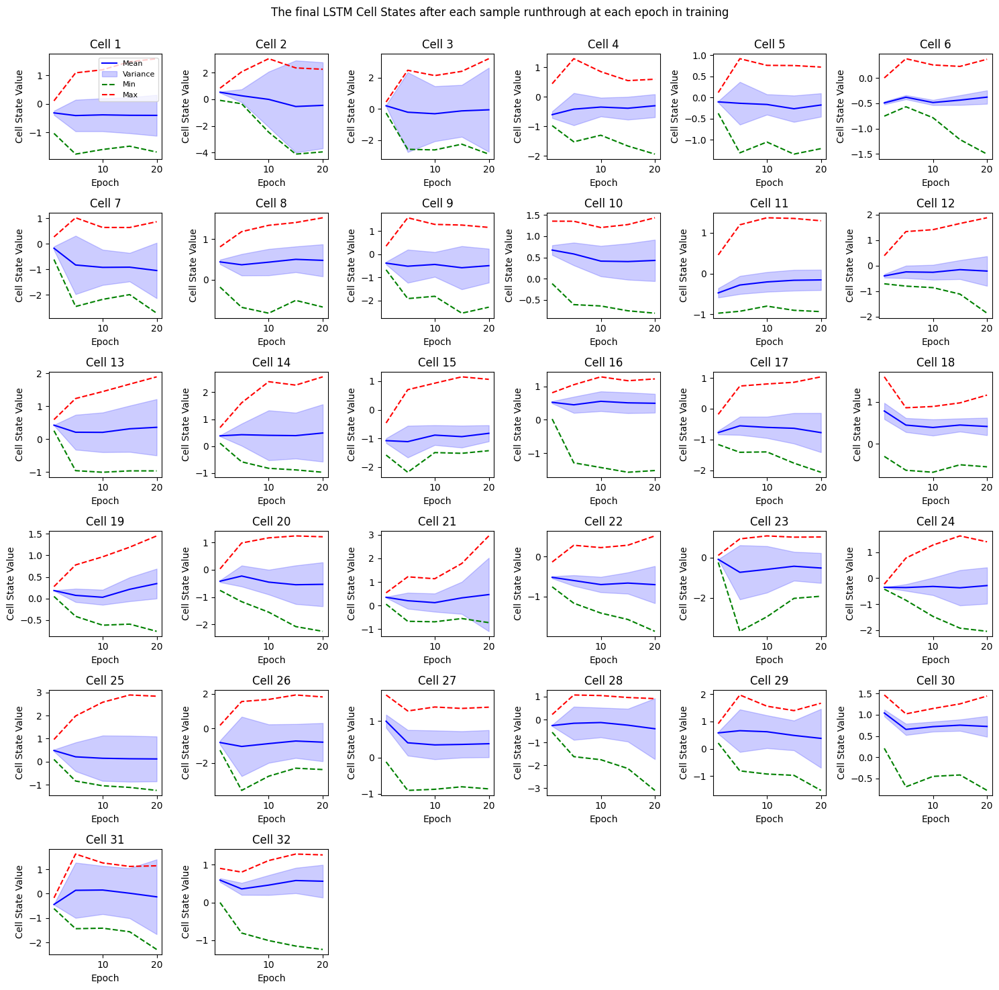

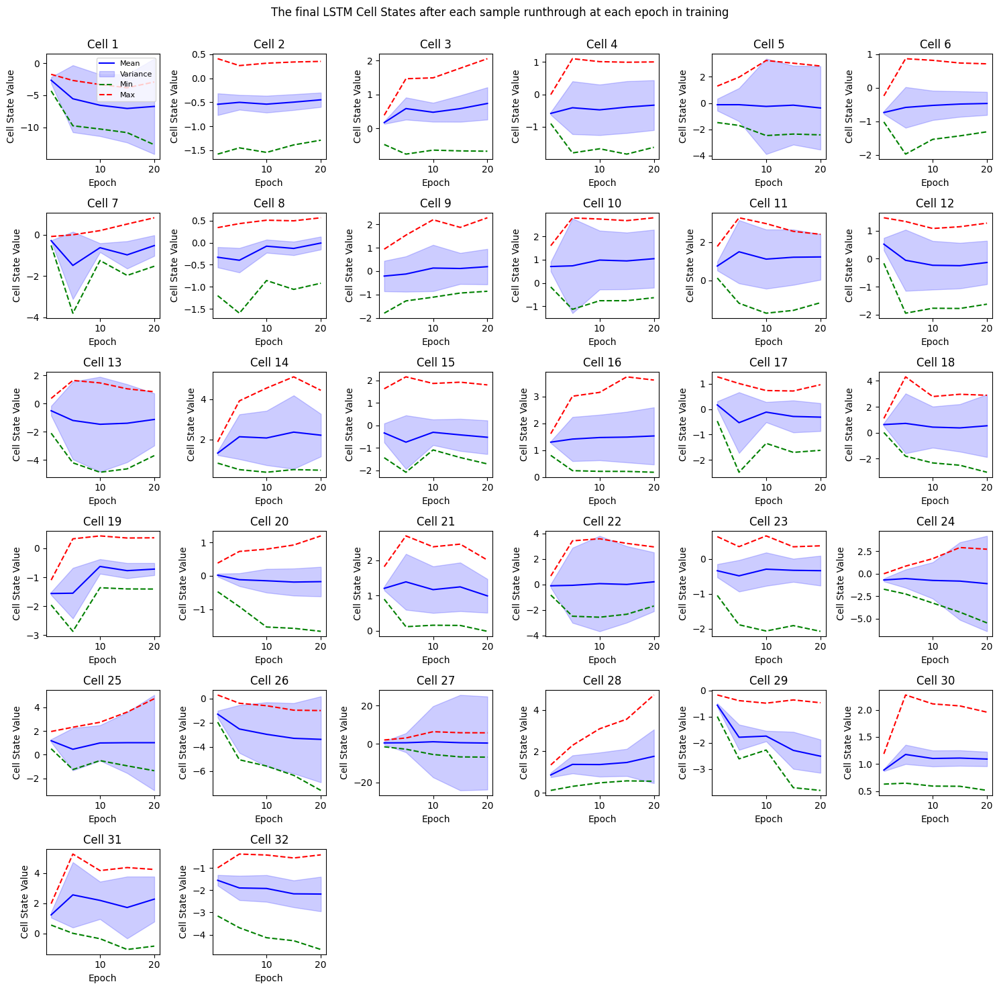

In [ ]:
visualize_lstm_cell_states(cell_states_signal, custom_epochs=custom_epochs)
visualize_lstm_cell_states(cell_states_features, custom_epochs=custom_epochs)

A high variance, indicated in the blue shade, may indicate a greater suceptability to changes in the signal. That is a very far indication, however.

Also, somehow the variance is often much greater than the min, max values. That is strange

## LSTM Hidden Activation (without weights)

I still attempt to display the highes ranked LSTM weights

### Helper Functions

In [ ]:
dense_weights_ranked = rank_dense_weights_for_all_models_multi(extracted_data_dict)  # Ranks weights for the last epoch

In [ ]:
extracted_data_dict.keys()

dict_keys(['all_features_multi', 'signal_multi', 'hilbert_included_multi', 'wavelet_inlcuded_multi'])

In [ ]:
import matplotlib.cm as cm
import matplotlib.colors as mcolors

def visualize_hidden_activation_multi(extracted_data_dict, tt_splits_dict, directory_name='low_noise_beta_binary',
                                sample_number=4, top_n=4, cells_to_visualize=[0, 1, 2, 3],  # Specify cell indices to visualize
                                epoch_to_visualize=-1, time_limit=(0, 5),
                                weighted_cells=False, sequence_duration=None,
                                show_worst_cells=True,
                                noise_ratio=2, weighted_cell=None):  # This argument has no effect anymore
  """Visualizes the hidden activation of an LSTM model for a specific sample,
    independent of cell weights.

    Args:
        extracted_data_dict (dict): Dictionary containing extracted data from the model, including hidden states and predictions.
        tt_splits_dict (dict): Dictionary containing train-test splits, including X_test and y_test.
        directory_name (str, optional): The noise level of the data to visualize ('low_noise_beta_binary' or 'high_noise_beta_binary'). Defaults to 'low_noise_beta_binary'.
        sample_number (int, optional): The index of the sample to visualize. Defaults to 4.
        cells_to_visualize (list, optional): A list of cell indices to visualize. Defaults to [0, 1, 2, 3].
        top_n (int, optional): The number of top and bottom LSTM cells to highlight based on their weights. Defaults to 4.
        epoch_to_visualize (int, optional): The epoch to visualize the hidden states from. Defaults to -1 (last epoch).
        time_limit (tuple, optional): The time range to display on the x-axis (in seconds). Defaults to (55, 60).
        weighted_cells (bool, optional): Whether to display the weighted cell activations. Defaults to False.
        sequence_duration (int, optional): The duration of the input sequence in seconds. If None, it will be inferred from the signal length. Defaults to None.
        show_worst_cells (bool, optional): This argument has no effect and is kept for backward compatibility. Defaults to True.

    Returns:
        None: Displays the visualization using matplotlib.
  """
  noise_ratios = [-8,-4,0,4,8]
  category_labels=['noise', 'theta', 'alpha', 'beta', 'gamma']

  label_size = 14
  tick_size = 14
  legen_size = 10


  sampling_frequency = 250
  print(f"Model: {directory_name} \nSample: {sample_number} \nNoiseRatio: {noise_ratios[noise_ratio]}")
  # Create custom color lists with variations of green and red
  top_colors = [mcolors.to_rgba('green', alpha=1 - (i / (top_n + 1))) for i in range(top_n)] # More intense green, less alpha variation
  bottom_colors = [mcolors.to_rgba('red', alpha=1 - (i / (top_n + 1))) for i in range(top_n)] # More intense red, less alpha variation

  # Extract data for the specified noise level
  X_test = tt_splits_dict[directory_name]['X_test'][:,:, :, :, 0] # Gets only the signal (works for featue Xs as well)
  y_test = tt_splits_dict[directory_name]['y_test']
  hidden_states_activation = extracted_data_dict[directory_name]['hidden_states_activation']
  dense_weights = extracted_data_dict[directory_name]['dense_weights']
  dense_bias = extracted_data_dict[directory_name]['dense_bias']
  epoch_model_predictions = extracted_data_dict[directory_name]['epoch_model_predictions']

  print(f"X_test shape: {X_test.shape}")
  print(f"y_test shape: {y_test.shape}")
  # Define time vector based on sequence_duration
  if sequence_duration is None:  # If sequence_duration is not provided, infer it from the signal length
      sequence_duration = len(X_test[0, sample_number, noise_ratio].flatten()) / sampling_frequency
  time_vec = np.linspace(0, sequence_duration, int(sequence_duration * sampling_frequency), endpoint=False)  # Ensure time_vec length matches signal length
  # Create visualization with potential extra subplot for weighted cells
  num_subplots = 3 + int(weighted_cells)  # Add a subplot if weighted_cells is True
  fig, ax = plt.subplots(num_subplots, 1, figsize=(20, 14 + 6 * int(weighted_cells)),
                         sharex=True, gridspec_kw={'hspace': 0.3})

  print(sequence_duration)
  # Extract signal and ground truth for the sample
  signal_sample = X_test[0, sample_number, noise_ratio].flatten()
  ground_truth = y_test[0, sample_number, noise_ratio].flatten()

   # One-hot encode labels
  current_label_sample = du.one_hot_encode_single_sample(ground_truth, categories=np.unique(y_test.flatten()))

  custom_colors = ['lightblue', 'orange', 'green', 'red', 'darkblue']
  cc = custom_colors[:current_label_sample.shape[1]]

  max_value = np.max(signal_sample) * 1.05
  min_value = np.min(signal_sample) * 1.05

  # This will tell me what the burst category of the sample is
  # I can use that to choose which cells to display
  oscillation_cat = max(ground_truth)
  if weighted_cells:
      dense_weights_ranked = rank_dense_weights_for_all_models_multi(extracted_data_dict)
      dense_weights_by_cat = dense_weights_ranked[directory_name][oscillation_cat]
      cell_ids_good = dense_weights_by_cat['ranked_cell_indices'][:top_n]
      cell_ids_bad = dense_weights_by_cat['ranked_cell_indices'][-top_n:]
      print(f"Top {top_n} LSTM Cells: {cell_ids_good}")
      print(f"Bottom {top_n} LSTM Cells: {cell_ids_bad}")


  # Extract hidden states for the specified epoch (sample, n_of_hidden_cells, n_timesteps)
  epoch_lstm_act = hidden_states_activation[epoch_to_visualize]
  # (epochs, samples, timesteps, output cells) = (5,20,5,7500,5)
  y_pred = epoch_model_predictions[epoch_to_visualize][sample_number][noise_ratio]
  n_timesteps, n_cats  = y_pred.shape  # (7500, 5)
  y_pred_reshaped = y_pred.reshape(-1, n_cats, 1)




  print(y_pred_reshaped.shape)

  model_pred = np.argmax(y_pred_reshaped, axis=1)
  predicted_labels = du.one_hot_encode_single_sample(model_pred, categories=np.unique(y_test.flatten()))
  # Plot LFP signal
  ax[0].plot(time_vec, signal_sample, label='Signal', alpha=1, color="k", linewidth=1.5)
  ax[0].stackplot(time_vec, current_label_sample.T * max_value, labels=category_labels, alpha=0.4, linewidth=2, colors=cc)
  ax[0].stackplot(time_vec, current_label_sample.T * min_value, alpha=0.4, linewidth=2, colors=cc)
  ax[0].set_xlabel("Time (s)", fontsize=label_size)
  ax[0].set_ylabel("Amplitude", fontsize=label_size)
  ax[0].set_title(f"Synthetic Signal (Sample: {sample_number}; Noise_Ratio: {noise_ratios[noise_ratio]}dB)", fontsize=label_size)
  ax[0].legend(loc='lower left', framealpha=0.6, ncol=2)
  ax[0].set_xlim(time_limit)

  # Plot model predictions and ground truth (moved to ax[1])
  predictions = model_pred.flatten()
  #ax[1].plot(time_vec, predictions, label='Confidence', alpha=0.9)
  #ax[1].stackplot(time_vec, ground_truth, labels=["Ground Truth"], alpha=0.5, colors=['red'])
  ax[1].stackplot(time_vec, predicted_labels.T , alpha=0.4, linewidth=2, colors=cc) # labels=category_labels,
  # ax[1].stackplot(time_vec, y_pred.T * min_value, alpha=0.4, linewidth=2, colors=cc)
  ax[1].set_xlabel("Time (s)", fontsize=label_size)
  ax[1].set_ylabel("Confidence", fontsize=label_size)
  ax[1].set_title("Predicted Signal Type", fontsize=label_size)
  ax[1].legend(loc='lower left')  # Adjust legend location if needed
  ax[1].set_xlim(time_limit)
  ax[1].set_ylim(0, 1)

  # Create a secondary y-axis for confidence plots
  #ax2 = ax[1].twinx()  # Create a twin axis sharing the x-axis
  for class_id in range(y_pred.shape[1]):
      ax[1].plot(time_vec, y_pred[:, class_id].flatten(), label=f'Class {class_id} Confidence', alpha=0.9)
  #ax2.set_ylabel('Confidence Value', color='blue')  # Set label for the secondary y-axis
  #ax2.tick_params(axis='y', labelcolor='blue')  # Set tick color for the secondary y-axis
  ax[1].legend(loc='lower right')  # Adjust legend location if needed


  if weighted_cells and cells_to_visualize is None:
    # Plot hidden states for top and bottom cells (moved to ax[2])
    for i, cell_id in enumerate(cell_ids_good):
        ax[2].plot(time_vec, epoch_lstm_act[sample_number,noise_ratio, : ,cell_id], label=f'Good Output Cell {cell_id + 1}')

    if show_worst_cells:  # Only plot worst cells if show_worst_cells is True
        for i, cell_id in enumerate(cell_ids_bad):
            ax[2].plot(time_vec, epoch_lstm_act[sample_number,noise_ratio, : ,cell_id], label=f'Bad Output Cell {cell_id + 1}')

  if weighted_cells and cells_to_visualize:
      for cell_id in cells_to_visualize:
        ax[2].plot(time_vec, epoch_lstm_act[sample_number,noise_ratio, : ,cell_id], label=f'LSTM Cell {cell_id + 1}')
  else:
      print(f"Printing the {cells_to_visualize} cells")
      for cell_id in cells_to_visualize:
        ax[2].plot(time_vec, epoch_lstm_act[sample_number,noise_ratio, : ,cell_id], label=f'LSTM Cell {cell_id + 1}')



  ax[2].set_title(f'Epoch: {epoch_to_visualize} LSTM Hidden States Values', fontsize=label_size)
  ax[2].set_xlabel('Time (s)', fontsize=label_size)
  ax[2].set_ylabel('Hidden State Value', fontsize=label_size)
  ax[2].set_xlim(time_limit)
  ax[2].legend(loc="right", framealpha=0.7)


  # Plot weighted cell states if weighted_cells is True (added as a separate subplot below hidden states)
  if weighted_cells:
      dense_weights_by_cat = dense_weights_ranked[directory_name][oscillation_cat]['ranked_dense_weights']
      dense_weight_by_cat_indices = dense_weights_ranked[directory_name][oscillation_cat]['ranked_cell_indices']
      dense_weights_by_cat = unrank_weights(dense_weights_by_cat, dense_weight_by_cat_indices)

      dense_bias_by_cat = dense_bias[epoch_to_visualize][oscillation_cat]

      print(f"Dense Weights: {len(dense_weights_by_cat)}")
      print(f"Dense Bias: {epoch_lstm_act[sample_number][noise_ratio].shape}")

      weighted_activations = calculate_weighted_activations(epoch_lstm_act[sample_number,noise_ratio].T, dense_weights_by_cat, dense_bias_by_cat)

      print(dense_weights.shape)
      print(dense_bias.shape)
      all_weighted_activations = calculate_all_weighted_activations(epoch_lstm_act[sample_number,noise_ratio].T,
                                                                    dense_weights=dense_weights[0],
                                                                    dense_bias=dense_bias[0])
      print(all_weighted_activations.shape)
      if weighted_cells and cells_to_visualize is None:
          for cell_id in enumerate(cell_ids_good):
              ax[3].plot(time_vec, weighted_activations[cell_id], label=f'LSTM Cell{cell_id + 1}')
          if show_worst_cells:
              for cell_id in enumerate(cell_ids_bad):
                  ax[3].plot(time_vec, weighted_activations[cell_id], label=f'LSTM Cell {cell_id + 1}', color="orange")
      if weighted_cells and cells_to_visualize:
          for dense_cell in range(all_weighted_activations.shape[0]): # Loops through all Output Cells
              ax[3].plot(time_vec, all_weighted_activations[dense_cell, weighted_cell], label=f'LSTM Cell {weighted_cell + 1}, Dense Cell: {dense_cell}')
      else:
          for cell_id in range(top_n):
              ax[2].plot(time_vec, weighted_activations[cell_id], label=f'LSTM Cell {cell_id + 1}')


      ax[3].set_title(f'LSTM Weighted Hidden State Values', fontsize=label_size)
      ax[3].set_xlabel('Time Steps', fontsize=label_size)
      ax[3].set_ylabel("Weighted Hidden State Value", fontsize=label_size)
      ax[3].set_xlim(time_limit)
      ax[3].legend(loc="lower left", framealpha=0.5, ncol = 1)

  for axis in ax:
    axis.grid(False)  # Disable x-grid lines for this subplot
    axis.tick_params(axis='both', which='both',  # Apply to both x and y axes
                        bottom=True, top=False,   # Control tick visibility
                        left=True, right=False,
                        labelbottom=True, labelleft=True) # Control tick label visibility
  plt.show()

### Viusalizations

In [ ]:
extracted_data_dict.keys()

dict_keys(['all_features_multi', 'signal_multi', 'hilbert_included_multi', 'wavelet_inlcuded_multi'])

In [ ]:
# Remove dense_weights_ranked as an argument, it's not needed in the function signature.
visualize_hidden_activation_multi(extracted_data_dict, tt_splits_dict, directory_name='signal_multi',
                                      sample_number=0, epoch_to_visualize=-1,
                                      top_n=3,
                                      weighted_cells=False,
                                      show_worst_cells=False,
                                      noise_ratio=2,
                                      cells_to_visualize=[14,0],
                                      time_limit=(0, 8),)

Model: signal_multi 
Sample: 0 
NoiseRatio: 0


IndexError: too many indices for array: array is 4-dimensional, but 5 were indexed

In [ ]:
extracted_data_dict.keys()

In [ ]:
# Remove dense_weights_ranked as an argument, it's not needed in the function signature.
visualize_hidden_activation_multi(extracted_data_dict, tt_splits_dict, directory_name='all_features_multi',
                                      sample_number=10, epoch_to_visualize=-1,
                                      top_n=3,
                                      weighted_cells=True,
                                      show_worst_cells=False,
                                      noise_ratio=1,
                                      cells_to_visualize=[14,0],
                                      time_limit=(0, 8),)

In [ ]:
# Zum export
for sample in [2,6,10,14]:
    visualize_hidden_activation_multi(extracted_data_dict, tt_splits_dict, dense_weights_ranked, directory_name='mid_noise_all_features_multi',
                                      sample_number=sample, epoch_to_visualize=-1,
                                      top_n=4,
                                      weighted_cells=False,
                                      show_worst_cells=False)

### Analyze specifc cells

Now we'll look into certain specific cells.

1. Choosing an allrounder Cell

    a. Feature Model

    b. Signal Model
2. Choosing a specific Cell

    a. Feature Model

    b. Signal Model

**1. Choosing an allrounder**

In [ ]:
summed_weights_signal = summed_dense_weights_ranked['mid_noise_all_signal_multi_low']["ranked_cell_indices"][:3]
summed_weights_features = summed_dense_weights_ranked['mid_noise_features_multi_low']["ranked_cell_indices"][:3]
print(summed_weights_signal)
print(summed_weights_features)

[16  7 15]
[ 2 30 21]


**1a) Feature Model**

Model: mid_noise_features_multi_mid 
Sample: 2


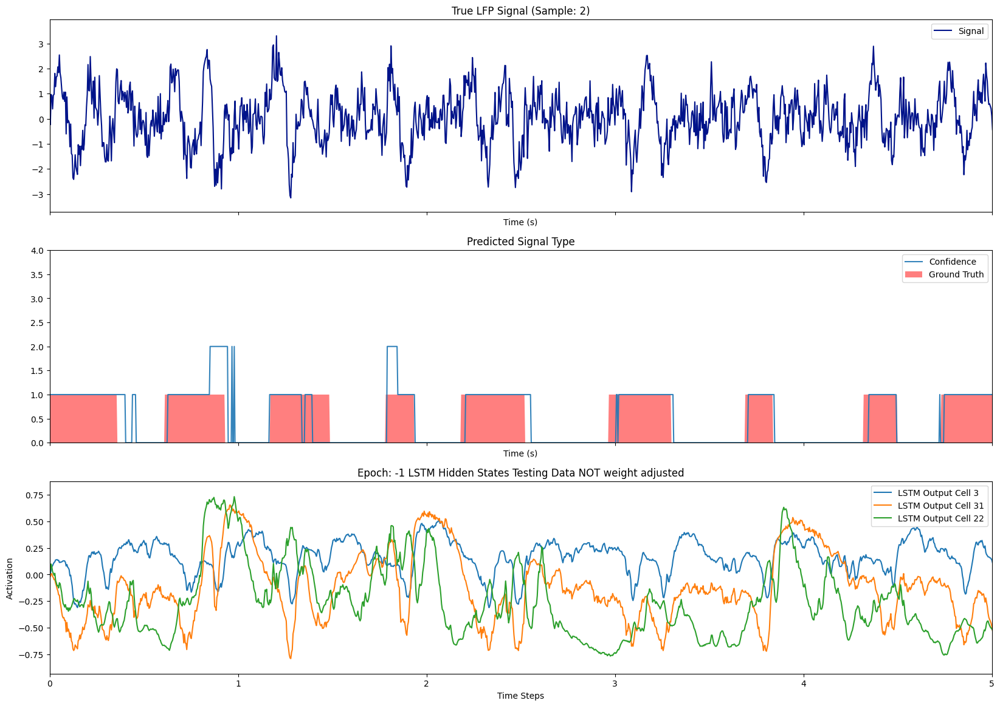

Model: mid_noise_features_multi_mid 
Sample: 6


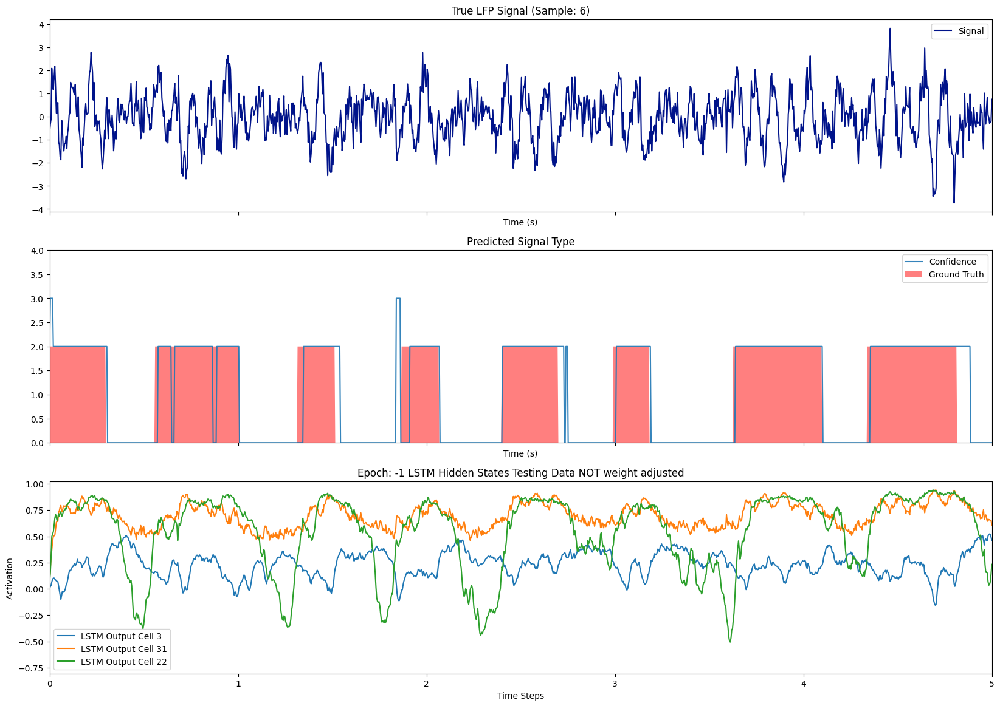

Model: mid_noise_features_multi_mid 
Sample: 10


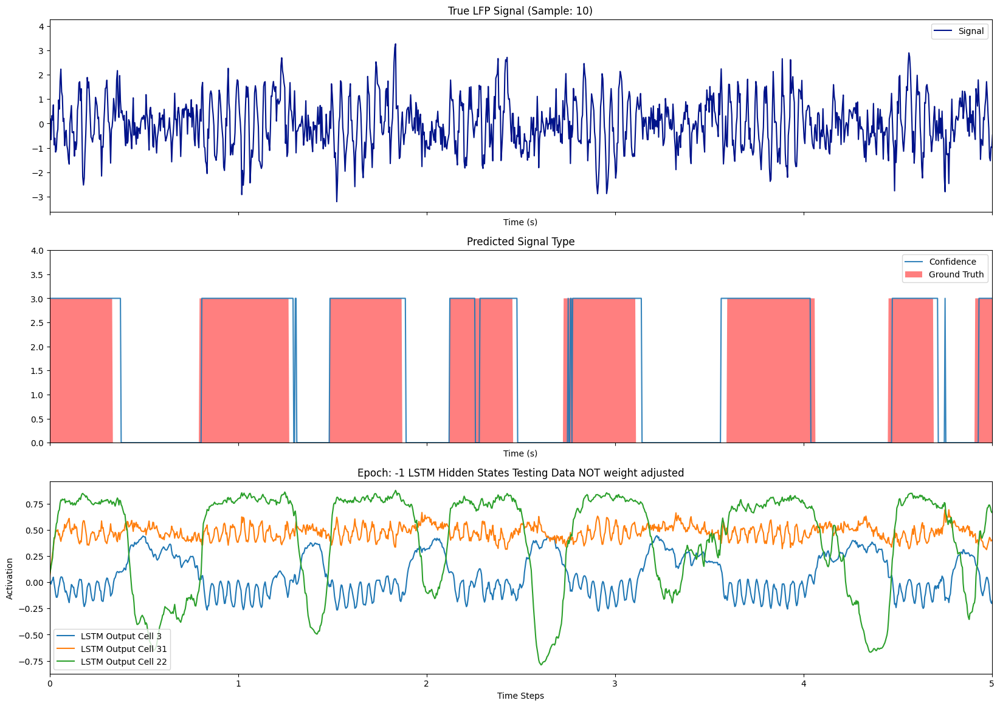

Model: mid_noise_features_multi_mid 
Sample: 14


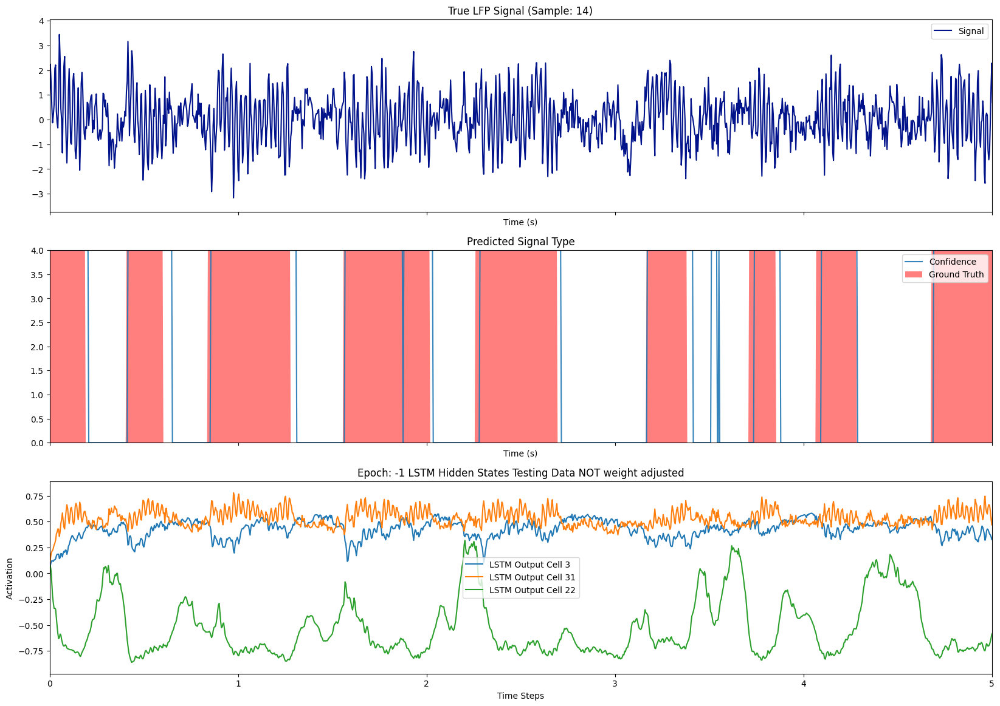

In [ ]:
# Zum export (theta,alpha,beta,gamma)
for sample in [2,6,10,14]:
    visualize_hidden_activation_multi(extracted_data_dict, tt_splits_dict, directory_name='mid_noise_features_multi_mid',
                                      sample_number=sample, epoch_to_visualize=-1,
                                      cells_to_visualize=summed_weights_features)

Das sind zwar die allrounder unter den Zellen, aber man sieht ganz klar, welche für was am besten sind.

**1b) Signal Model**

In [ ]:
# Zum export (theta,alpha,beta,gamma)
for sample in [2,6,10,14]:
    visualize_hidden_activation_multi(extracted_data_dict, tt_splits_dict, directory_name='mid_noise_all_signal_multi_mid',
                                      sample_number=sample, epoch_to_visualize=-1,
                                      cells_to_visualize=summed_weights_signal)

Output hidden; open in https://colab.research.google.com to view.

**2) Specific Cell**

Features Model:

Cell_ID=11 (strong gamma correlation)

Cell_ID=12 (strong alpha correlation)

Cell_ID=4 (theta corr)

Signal Model:

Cell_ID=13 (strong noise correlation)

Cell_ID=6 (theta correlation)

None of these cells are in the top 10 overall.

I got those conclusions from the dense weights shown at the top of the file.


**2a) Feature Model**

Model: mid_noise_features_multi_mid 
Sample: 2


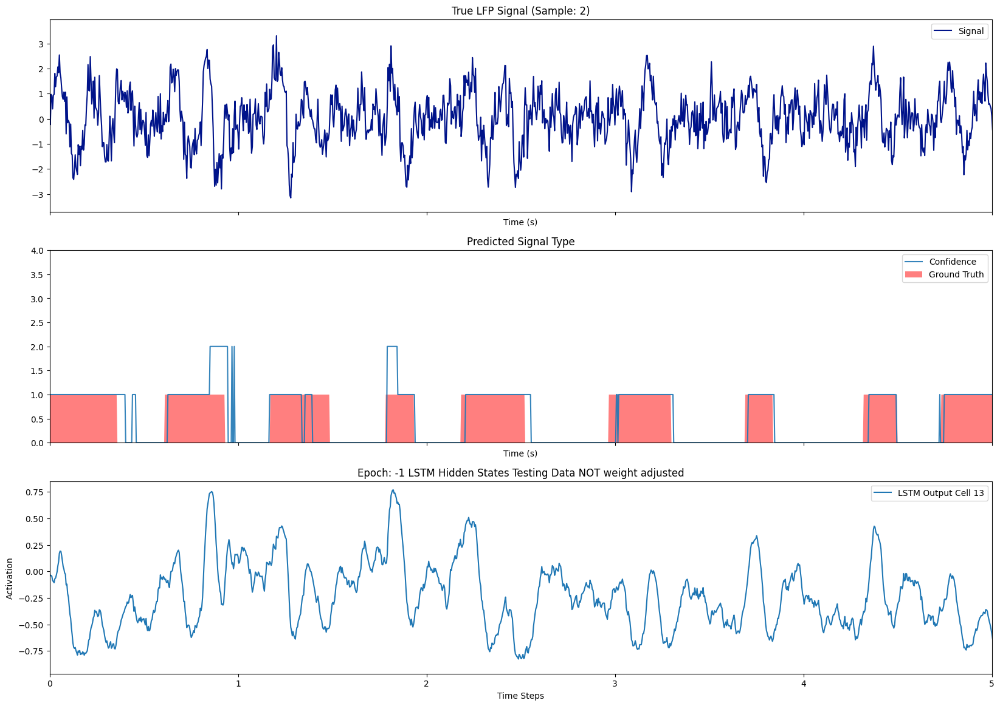

Model: mid_noise_features_multi_mid 
Sample: 6


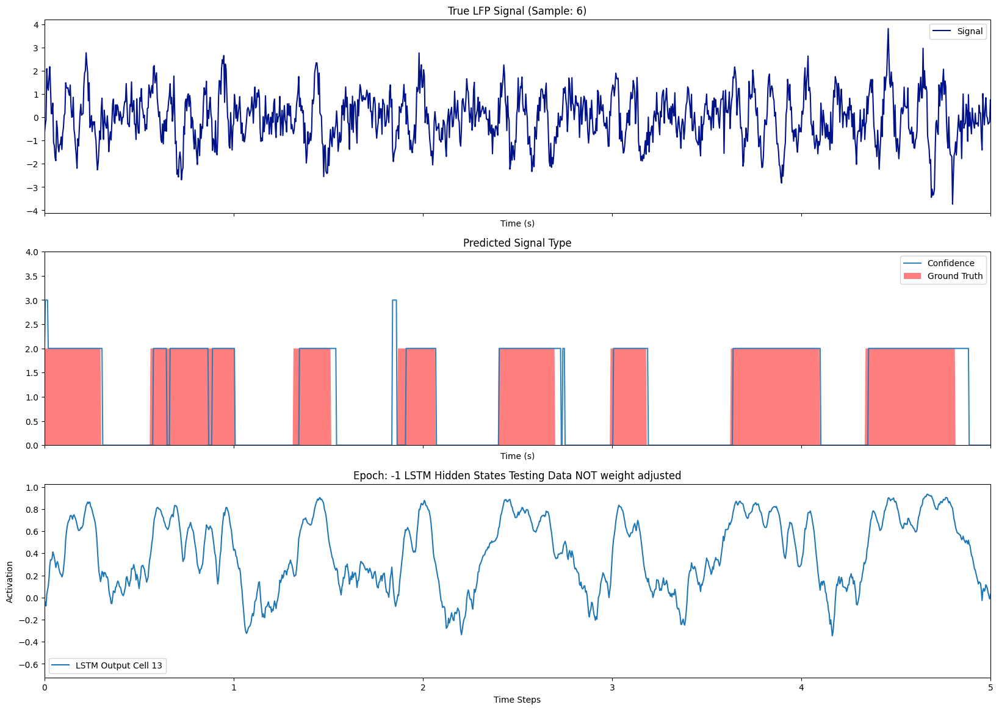

Model: mid_noise_features_multi_mid 
Sample: 10


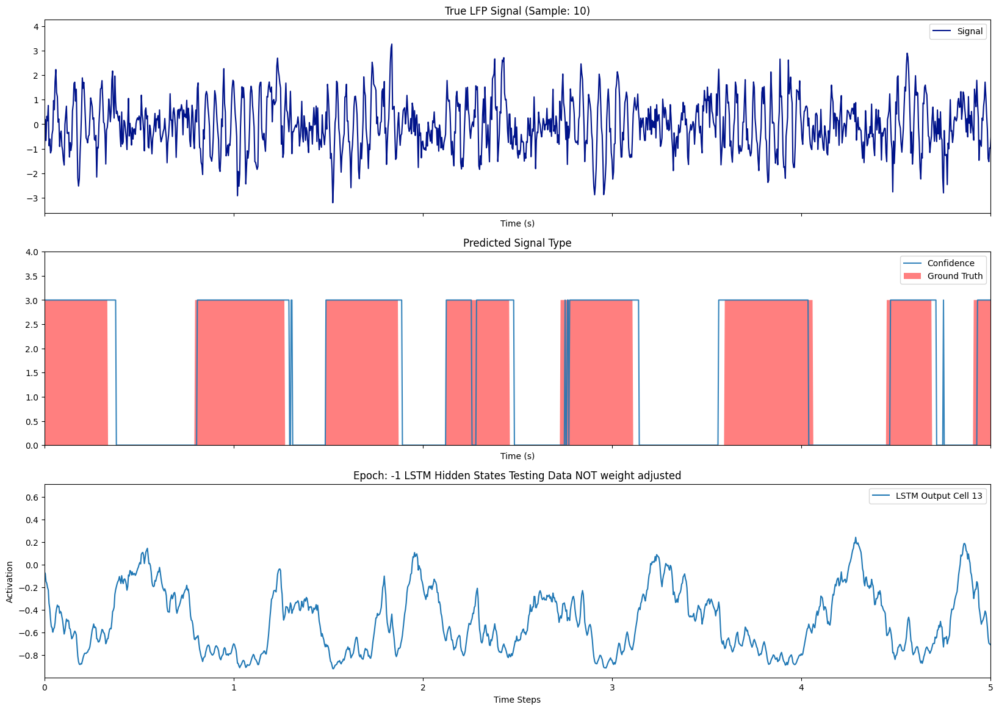

Model: mid_noise_features_multi_mid 
Sample: 14


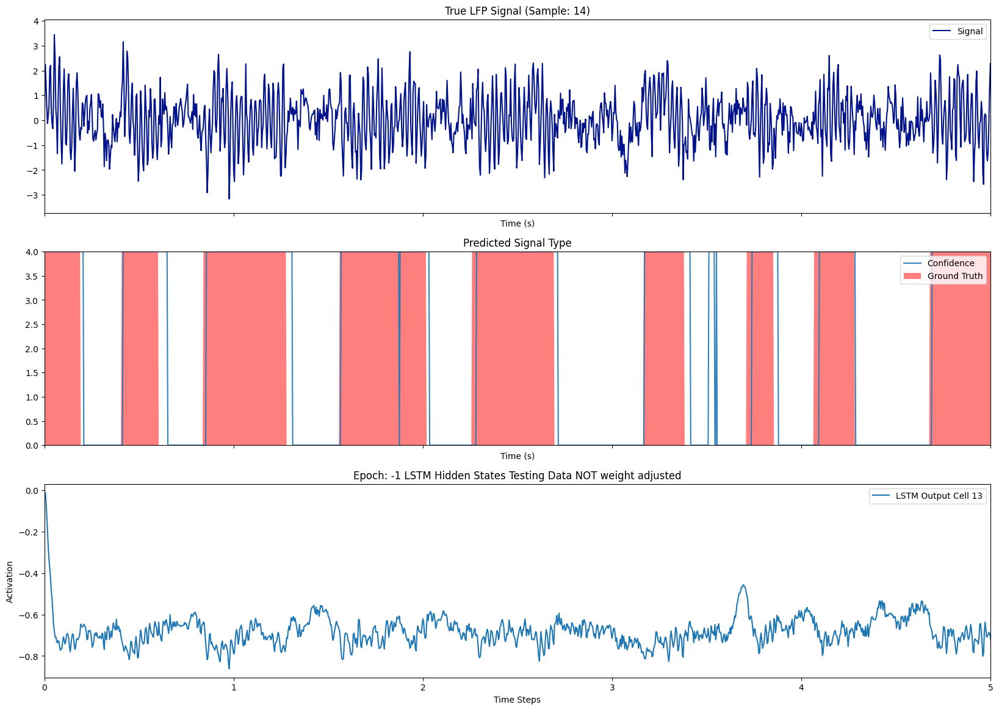

In [ ]:
special_cells = [12] # strong alpha

# Zum export (theta,alpha,beta,gamma)
for sample in [2,6,10,14]:
    visualize_hidden_activation_multi(extracted_data_dict, tt_splits_dict, directory_name='mid_noise_features_multi_mid',
                                      sample_number=sample, epoch_to_visualize=-1,
                                      cells_to_visualize=special_cells)

Model: mid_noise_features_multi_mid 
Sample: 2


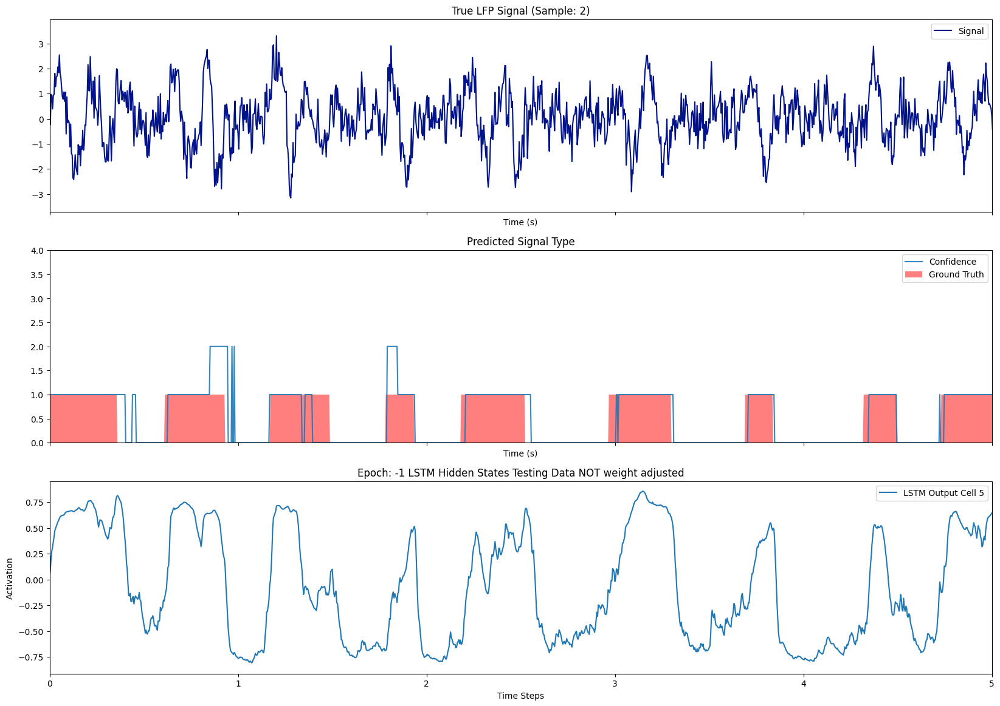

Model: mid_noise_features_multi_mid 
Sample: 6


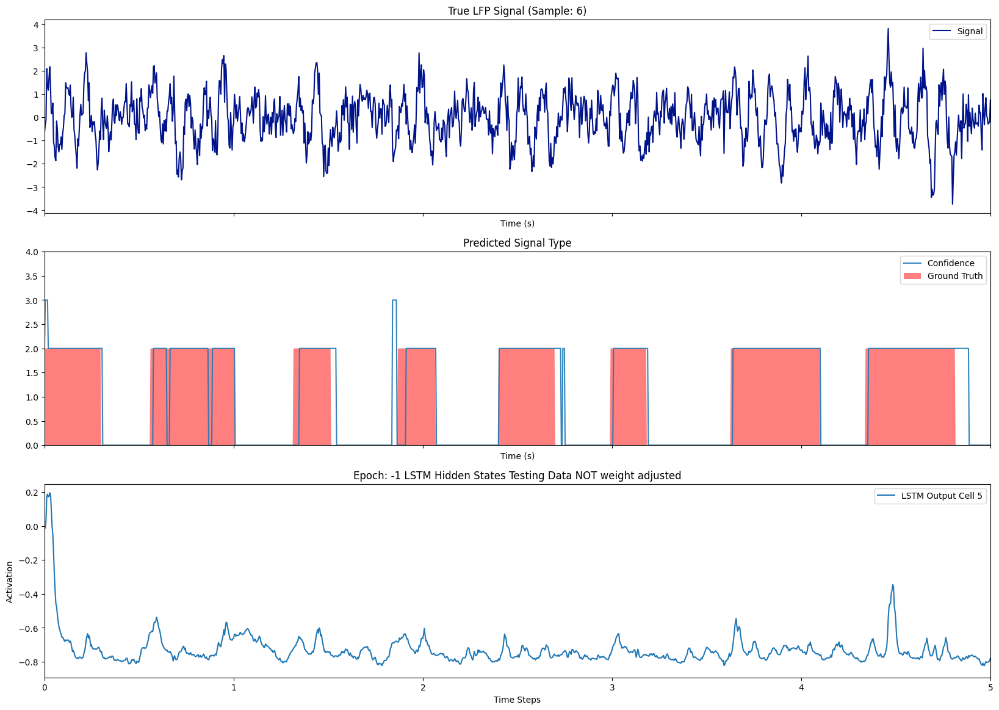

Model: mid_noise_features_multi_mid 
Sample: 10


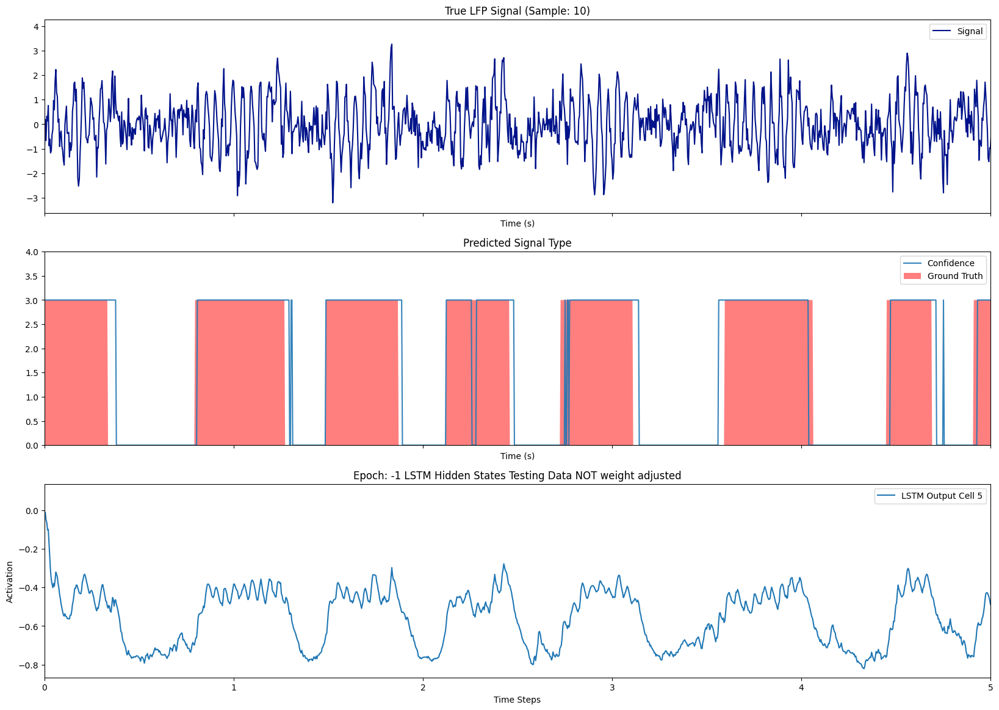

Model: mid_noise_features_multi_mid 
Sample: 14


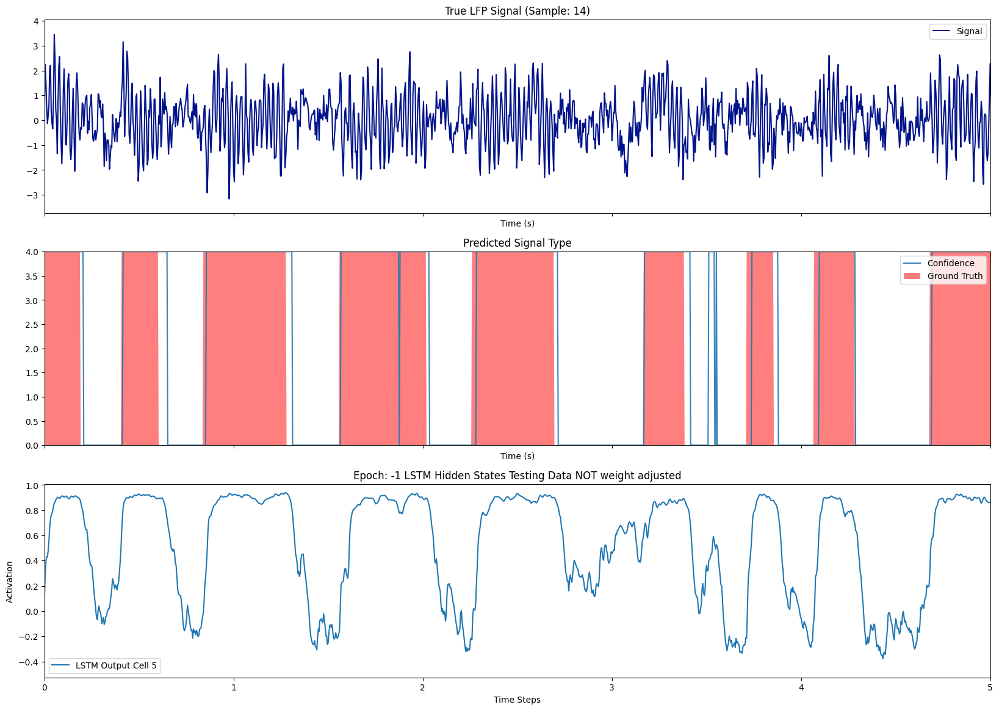

In [ ]:
special_cells = [4] # strong theta

# Zum export (theta,alpha,beta,gamma)
for sample in [2,6,10,14]:
    visualize_hidden_activation_multi(extracted_data_dict, tt_splits_dict, directory_name='mid_noise_features_multi_mid',
                                      sample_number=sample, epoch_to_visualize=-1,
                                      cells_to_visualize=special_cells)

**2b) Signal Model**

Model: mid_noise_all_signal_multi_high 
Sample: 2


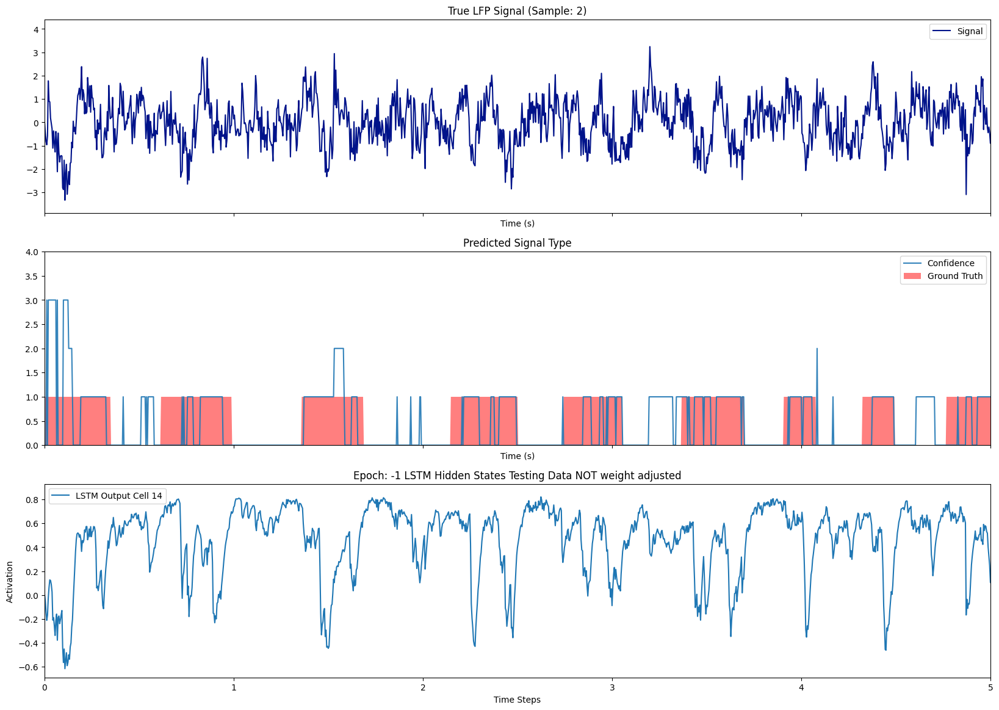

Model: mid_noise_all_signal_multi_high 
Sample: 6


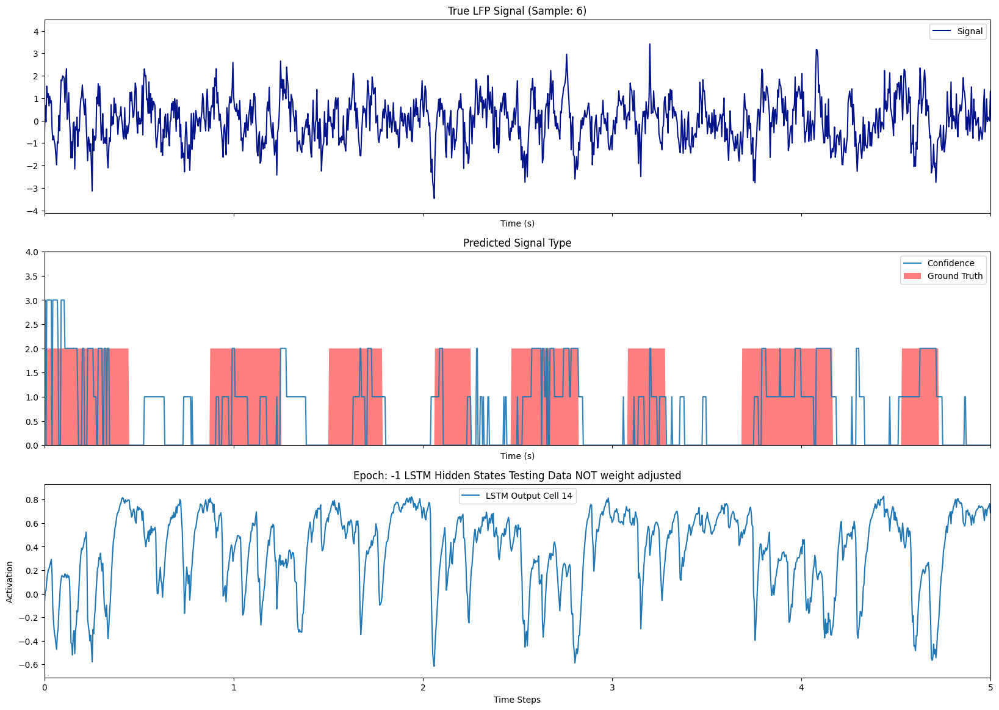

Model: mid_noise_all_signal_multi_high 
Sample: 10


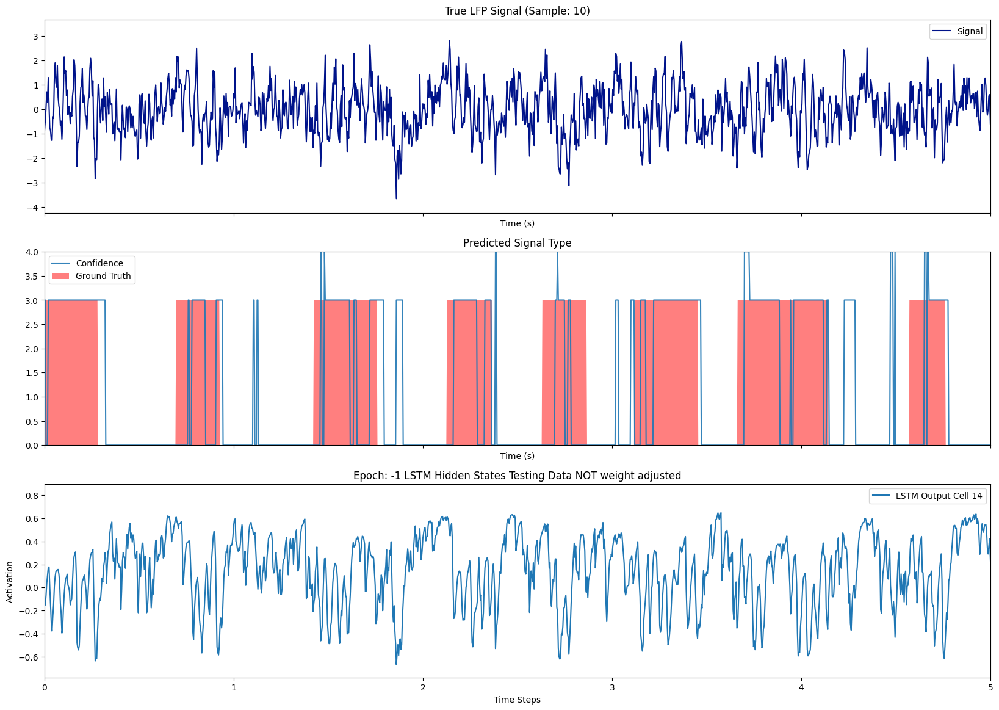

Model: mid_noise_all_signal_multi_high 
Sample: 14


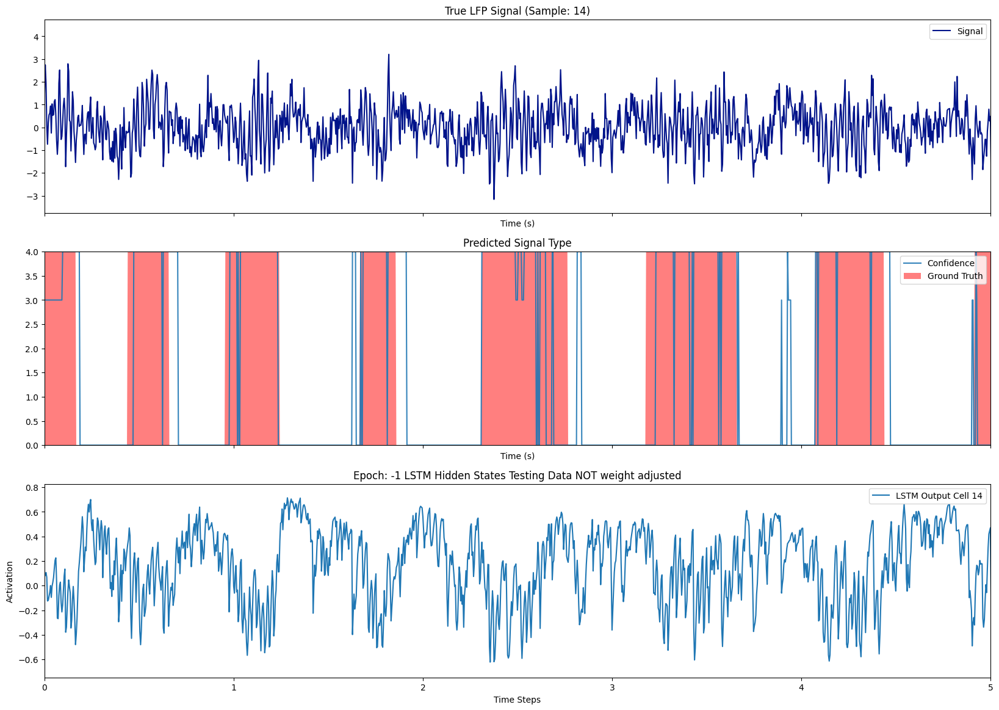

In [ ]:
special_cells = [13] # strong noise correlation

# Zum export (theta,alpha,beta,gamma)
for sample in [2,6,10,14]:
    visualize_hidden_activation_multi(extracted_data_dict, tt_splits_dict, directory_name='mid_noise_all_signal_multi_high',
                                      sample_number=sample, epoch_to_visualize=-1,
                                      cells_to_visualize=special_cells)

In [ ]:
extracted_data_dict.keys()

dict_keys(['mid_noise_all_features_multi', 'mid_noise_hilbert_multi', 'mid_noise_signal_multi'])

# HeatMaps

### HeatMap Functions

In [ ]:
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.metrics import mutual_info_score # Import mutual_info_score

def create_heatmap_cell_feature_corr(cell_activations, X_train, correlation_metric=np.corrcoef, absolute=False, rounding_factor=.1):
    """
    Creates a heatmap of correlation values between LSTM cell activations and input features.

    Args:
        cell_activations (np.ndarray): LSTM cell activations of shape (samples, noise_ratios, timesteps, cells).
        X_train (np.ndarray): Input features of shape (samples, noise_ratios, timesteps, features).
        correlation_metric (function, optional): The correlation metric function to use. Defaults to np.corrcoef.

    Returns:
        None: Displays the heatmap.
    """
    mean_freqs_round = np.round(np.logspace(np.log10(4), np.log10(100), num=20)).astype(int)
    num_cells = cell_activations.shape[-1]  # Number of LSTM cells
    num_features = X_train.shape[-1]  # Number of input features

    # Reshape for easier calculation
    cell_activations = cell_activations.reshape(-1, num_cells)
    X_train = X_train.reshape(-1, num_features)

    categories=range(1, num_features + 1)

    correlation_matrix = np.zeros((num_cells, num_features))

    # Calculate correlation for each cell-feature pair
    for cell_index in range(num_cells):
        for feature_index in range(num_features):

          if correlation_metric is mutual_info_score:
                # If it is, assign the scalar value directly
                correlation_matrix[cell_index, feature_index] = correlation_metric(
                    cell_activations[:, cell_index], X_train[:, feature_index])
          else:
                # Otherwise, assume it returns a 2D array and extract the correlation coefficient
                correlation_matrix[cell_index, feature_index] = correlation_metric(
                    cell_activations[:, cell_index], X_train[:, feature_index])[0, 1]

    if absolute:
        correlation_matrix = np.abs(correlation_matrix)

    if num_features in (5,6):
        categories = ["Ground Truth", "Signal", "Theta Hilbert", "Alpha Hilbert ", "Beta Hilbert", "Gamma Hilbert "]  # Define categories

    elif num_features in (1,2):
        categories = ["Ground Truth", "Signal"]  # Define categories

    elif num_features in (25,26,27):
        categories = ["Ground Truth", "Signal", "Theta Hilbert", "Alpha Hilbert ", "Beta Hilbert", "Gamma Hilbert "] + \
                [f'Wavelet at {freq} Hz' for freq in mean_freqs_round]

    # Create and display heatmap with annotations
    plt.figure(figsize=(15, 10))  # Adjust figure size as needed
    sns.heatmap(correlation_matrix, annot=True, cmap="viridis", fmt=f"{rounding_factor}f",  # Add annot=True and fmt=".2f"
                xticklabels=categories, yticklabels=range(1, num_cells + 1),
                annot_kws={"size": 12})
    plt.title("Correlation between LSTM Cell Activations and Input Features")
    plt.xlabel("Input Feature")
    plt.ylabel("LSTM Cell")

    if num_features in (25,26,27):
        plt.xticks(rotation=45, ha='right')
    plt.show()

    return correlation_matrix

In [ ]:

def create_heatmap_cell_frequency_corr(hidden_activations, y_labels, correlation_metric=np.corrcoef, absolute=False, rounding_factor=.1):
    """
    Creates a heatmap showing correlation between cell activations and frequency values.

    Args:
        hidden_activations (np.ndarray): Hidden activations of shape (20, 5, 7500, 32).
        y_labels (np.ndarray): Labels of shape (20, 5, 7500).
        correlation_metric (function, optional): The correlation metric function to use. Defaults to np.corrcoef.

    Returns:
        None: Displays the heatmap.
    """
    # Determine y-labels
    mean_freqs = np.logspace(np.log10(4), np.log10(100), num=20)
    mean_freqs_round = np.round(mean_freqs).astype(int)

    oscillation_categories = []
    for freq in mean_freqs_round:
        oscillation_categories.append(classify_burst(freq))

    num_frequencies = hidden_activations.shape[0]  # 20 frequency values
    num_cells = hidden_activations.shape[-1]  # 32 cells

    correlation_matrix = np.zeros((num_cells, num_frequencies))

    for frequency_index in range(num_frequencies):
        # Reshape activations and labels for this frequency
        activations_for_frequency = hidden_activations[frequency_index].reshape(-1, num_cells)
        labels_for_frequency = y_labels[frequency_index].flatten()

        # Calculate correlation for each cell
        for cell_index in range(num_cells):
            correlation_matrix[cell_index, frequency_index] = correlation_metric(
                activations_for_frequency[:, cell_index], labels_for_frequency)[0, 1]
    if absolute:
        correlation_matrix = np.abs(correlation_matrix)

    # Create and display heatmap
    fig, ax1 = plt.subplots(figsize=(12, 10))  # Adjust figure size as needed
    sns.heatmap(correlation_matrix, annot=True, cmap="viridis", fmt=f"{rounding_factor}f",
                xticklabels=mean_freqs_round, yticklabels=range(1, num_cells + 1), ax=ax1)
    ax1.set_title("Correlation between LSTM Cell Activations and Frequency Values")
    ax1.set_xlabel("Frequency Value in Hz")
    ax1.set_ylabel("LSTM Cell")

    # Create second x-axis for oscillation categories
    ax2 = ax1.twiny()
    ax2.set_xlim(ax1.get_xlim())  # Align x-axes
    ax2.set_xticks(ax1.get_xticks())  # Align ticks
    ax2.set_xticklabels(oscillation_categories, rotation=45, ha='left')  # Set oscillation category labels
    ax2.set_xlabel("Oscillation Category")

    plt.show()

    return correlation_matrix

In [ ]:
def create_heatmap_cell_oscillation_corr(hidden_activations, y_labels, correlation_metric=np.corrcoef, absolute=False, rounding_factor=.1):
    """
    Creates a heatmap showing correlation between cell activations and oscillation categories.

    Args:
        hidden_activations (np.ndarray): Hidden activations of shape (20, 5, 7500, 32).
        y_labels (np.ndarray): Labels of shape (20, 5, 7500).
        correlation_metric (function, optional): The correlation metric function to use. Defaults to np.corrcoef.
        absolute (bool, optional): Whether to take the absolute value of the correlations. Defaults to False.
        rounding_factor (float, optional): The rounding factor for the annotation. Defaults to .1.

    Returns:
        None: Displays the heatmap.
    """
    # Determine y-labels (frequencies)
    mean_freqs = np.logspace(np.log10(4), np.log10(100), num=20)
    mean_freqs_round = np.round(mean_freqs).astype(int)

    # Determine oscillation categories for each frequency
    oscillation_categories = []
    for freq in mean_freqs_round:
        oscillation_categories.append(classify_burst(freq))

    # Define desired order of categories
    category_order = ["theta", "alpha", "beta", "gamma", "noise"]

    # Get unique oscillation categories and their indices, respecting the order
    unique_categories = [cat for cat in category_order if cat in oscillation_categories]
    num_categories = len(unique_categories)
    num_cells = hidden_activations.shape[-1]  # Number of LSTM cells

    # Initialize correlation matrix for categories
    correlation_matrix = np.zeros((num_cells, num_categories))

    # Calculate correlation for each cell-category pair
    for category_index, category in enumerate(unique_categories):
        print(category_index, category)
        # Setting cat_idx + 1 is crucial because we want to only look at oscillation weights
        dense_weights_by_cat = dense_weights_ranked['mid_noise_all_features_multi'][category_index + 1]['ranked_dense_weights']
        dense_weight_by_cat_indices = dense_weights_ranked['mid_noise_all_features_multi'][category_index + 1]['ranked_cell_indices']
        dense_weights_by_cat = unrank_weights(dense_weights_by_cat, dense_weight_by_cat_indices)

        dense_bias_by_cat = dense_bias[-1][category_index + 1]

        print(f"Dense Weights: {len(dense_weights_by_cat)}")

        # Find indices of frequencies belonging to this category
        category_indices = [i for i, cat in enumerate(oscillation_categories) if cat == category]
        print(category_indices)
        # Extract activations and labels for this category
        activations_for_category = hidden_activations[category_indices].reshape(-1, num_cells)

        labels_for_category = y_labels[category_indices].reshape(-1)

        # Calculate correlation for each cell within this category
        for cell_index in range(num_cells):
            correlation_matrix[cell_index, category_index] = correlation_metric(
                activations_for_category[:, cell_index], labels_for_category)[0, 1]

    if absolute:
        correlation_matrix = np.abs(correlation_matrix)

    # Create and display heatmap
    plt.figure(figsize=(12, 10))  # Adjust figure size as needed
    sns.heatmap(correlation_matrix, annot=True, cmap="viridis", fmt=f"{rounding_factor}f",
                xticklabels=unique_categories, yticklabels=range(1, num_cells + 1))
    plt.title("Correlation between LSTM Cell Activations and Oscillation Categories")
    plt.xlabel("Oscillation Category")
    plt.ylabel("LSTM Cell")
    plt.show()

    return correlation_matrix

In [ ]:
extracted_data_dict["signal_multi"].keys()


dict_keys(['hidden_states_activation', 'final_hidden_states', 'final_cell_states', 'dense_weights', 'dense_bias', 'epoch_model_predictions'])

In [ ]:
def create_heatmap_weighted_cell_oscillation_corr(extracted_data_dict, model_name:str, correlation_metric=np.corrcoef, absolute=False, rounding_factor=.1, epoch=-1):
    """
    Creates a heatmap showing correlation between cell activations and oscillation categories.

    Args:
        ranked_dense_weights (np.ndarray): Hidden activations of shape (20, 5, 7500, 32).
        y_labels (np.ndarray): Labels of shape (20, 5, 7500).
        correlation_metric (function, optional): The correlation metric function to use. Defaults to np.corrcoef.
        absolute (bool, optional): Whether to take the absolute value of the correlations. Defaults to False.
        rounding_factor (float, optional): The rounding factor for the annotation. Defaults to .1.

    Returns:
        None: Displays the heatmap.
    """
    dense_weights_ranked = rank_dense_weights_for_all_models_multi(extracted_data_dict)

    hidden_activations = extracted_data_dict[model_name]['hidden_states_activation'][epoch]
    dense_bias = extracted_data_dict[model_name]['dense_bias'][epoch]

    y_labels = tt_splits_dict[model_name]['y_test']

    # Determine y-labels (frequencies)
    mean_freqs = np.logspace(np.log10(4), np.log10(100), num=20)
    mean_freqs_round = np.round(mean_freqs).astype(int)

    # Determine oscillation categories for each frequency
    oscillation_categories = []
    for freq in mean_freqs_round:
        oscillation_categories.append(classify_burst(freq))

    # Define desired order of categories
    category_order = ["theta", "alpha", "beta", "gamma", "noise"]

    # Get unique oscillation categories and their indices, respecting the order
    unique_categories = [cat for cat in category_order if cat in oscillation_categories]
    num_categories = len(unique_categories)
    num_cells = hidden_activations.shape[epoch]  # Number of LSTM cells

    # Initialize correlation matrix for categories
    correlation_matrix = np.zeros((num_cells, num_categories))

    # Calculate correlation for each cell-category pair
    for category_index, category in enumerate(unique_categories):

        # Getting the correct dense weights for the cells
        dense_weights_by_cat = dense_weights_ranked[model_name][category_index + 1]['ranked_dense_weights']
        dense_weight_by_cat_indices = dense_weights_ranked[model_name][category_index + 1]['ranked_cell_indices']
        dense_weights_by_cat = unrank_weights(dense_weights_by_cat, dense_weight_by_cat_indices)

        dense_bias_by_cat = dense_bias[category_index + 1]

        # Find indices of frequencies belonging to this category and returns them as a list
        category_indices = [i for i, cat in enumerate(oscillation_categories) if cat == category]

        # Extract activations and labels for this category
        activations_for_category = hidden_activations[category_indices].reshape(-1, num_cells)

        # Have to transpose the input and output of sub-function
        weighted_activations = calculate_weighted_activations(activations_for_category.T, dense_weights_by_cat, dense_bias_by_cat).T

        labels_for_category = y_labels[category_indices].reshape(-1)

        # Calculate correlation for each cell within this category
        for cell_index in range(num_cells):
            correlation_matrix[cell_index, category_index] = correlation_metric(
                activations_for_category[:, cell_index], labels_for_category)[0, 1]

    if absolute:
        correlation_matrix = np.abs(correlation_matrix)

    # Create and display heatmap
    plt.figure(figsize=(12, 10))  # Adjust figure size as needed
    sns.heatmap(correlation_matrix, annot=True, cmap="viridis", fmt=f"{rounding_factor}f",
                xticklabels=unique_categories, yticklabels=range(1, num_cells + 1))
    plt.title("Correlation between LSTM Cell Activations and Oscillation Categories")
    plt.xlabel("Oscillation Category")
    plt.ylabel("LSTM Cell")
    plt.show()

    return correlation_matrix

### Helper Functions

In [ ]:
def classify_burst(value):
    """
    Classify a given float value into one of the predefined categories.

    Parameters:
        value (float): The input value to classify.

    Returns:
        str: The classification category as a string.
    """
    if value < 0.0:
        raise ValueError("Value must be non-negative.")

    if 0.0 <= value < 4.0:
        return "noise"
    elif 4.0 <= value < 8.0:
        return "theta"
    elif 8.0 <= value < 13.0:
        return "alpha"
    elif 13.0 <= value < 30.0:
        return "beta"
    elif 30.0 <= value < 110.0:
        return "gamma"
    else:
        raise ValueError("Value does not fall within known classification categories.")

In [ ]:
def get_top_n_correlations(correlation_matrix, n=5):
    """
    Gets the top n correlations and their coordinates in the correlation matrix.

    Args:
        correlation_matrix (np.ndarray): The correlation matrix.
        n (int, optional): The number of top correlations to retrieve. Defaults to 5.

    Returns:
        list: A list of tuples, where each tuple contains (correlation_value, row_index, column_index).
    """
    # Flatten the correlation matrix and get the indices of the top n values
    flat_indices = np.argpartition(correlation_matrix.flatten(), -n)[-n:]

    # Convert flattened indices to row and column indices
    row_indices = flat_indices // correlation_matrix.shape[1]
    column_indices = flat_indices % correlation_matrix.shape[1]

    # Get the top n correlation values and their coordinates
    top_correlations = [(np.round(correlation_matrix[row, col],3), row, col)
                         for row, col in zip(row_indices, column_indices)]

    # Sort the correlations in descending order
    top_correlations.sort(reverse=True)

    return top_correlations

In [ ]:
import matplotlib.lines as mlines

def plot_correlation_distribution(correlation_matrix, x_labels=None):
    """
    Plots correlation distribution with mean and standard deviation per feature using seaborn.

    Args:
        correlation_matrix (np.ndarray): The correlation matrix (features x cells).
    """
    num_features = correlation_matrix.shape[1]
    num_cells = correlation_matrix.shape[0]

    plt.figure(figsize=(16, 10))

    # Create a DataFrame for seaborn (without cell index as hue)
    df = pd.DataFrame(correlation_matrix)
    df.columns = [f"{i+1}" for i in range(num_features)]
    df_melted = df.melt(ignore_index=False).reset_index()  # Remove 'Cell' column

    # Rename columns to include the 'Cell' column
    df_melted.columns = ['Cell', 'Feature', 'Correlation']  # Rename columns, including 'Cell'

    # Create the scatter plot with seaborn (single color for all dots)
    scatter_handle = sns.scatterplot(data=df_melted, x='Feature', y='Correlation', color='red', alpha=0.5, s=100, label="Cell Correlations")  # Add label here

    # Calculate mean and standard deviation per feature
    mean_correlations = np.mean(correlation_matrix, axis=0)
    std_correlations = np.std(correlation_matrix, axis=0)

    # Plot mean and standard deviation with error bars
    plt.errorbar(range(num_features), mean_correlations, yerr=std_correlations,
                 color='black', fmt='o', capsize=10, linewidth=3, label='Mean and Std Dev', zorder=10)

    # Set plot labels and title



    # Add custom handle to the legend
    handles, labels = scatter_handle.axes.get_legend_handles_labels()  # Get existing handles and labels
    # handles.append(scatter_legend_handle)  # Append the custom scatter handle

    plt.legend(handles=handles, fontsize=14)  # Use updated handles in legend

    plt.xlabel("Feature Index", fontsize=16)
    plt.ylabel("Correlation Strength", fontsize=16)
    plt.title("Correlation Distribution per Feature", fontsize=18)
    # plt.legend(fontsize=14)
    if x_labels is not None:
        plt.xticks(range(num_features), x_labels, rotation=45, ha='right', fontsize=14)  # Set ticks and rotation
    else:
        plt.xticks(range(num_features))  # Default ticks if x_labels is None
    plt.grid(True)
    plt.tight_layout()
    plt.show()

In [ ]:
def plot_feature_correlation(correlation_matrix, feature1_index, feature2_index):
    """
    Creates a scatter plot showing the correlation between two features.

    Args:
        correlation_matrix (np.ndarray): The correlation matrix.
        feature1_index (int): The index of the first feature.
        feature2_index (int): The index of the second feature.
    """

    # Extract scores for the two features
    feature1_scores = correlation_matrix[:, feature1_index]
    feature2_scores = correlation_matrix[:, feature2_index]

    # Create the scatter plot
    plt.figure(figsize=(8, 6))  # Adjust figure size as needed
    plt.scatter(feature1_scores, feature2_scores, alpha=0.7)  # Alpha for transparency

    # Set plot labels and title
    plt.xlabel(f"Feature {feature1_index + 1} Scores")
    plt.ylabel(f"Feature {feature2_index + 1} Scores")
    plt.title(f"Correlation between Feature {feature1_index + 1} and Feature {feature2_index + 1}")

    plt.grid(True)
    plt.tight_layout()
    plt.show()

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans

def plot_feature_correlation_kmeans(correlation_matrix, feature1_index, feature2_index, num_clusters=3):
    """
    Creates a scatter plot with k-means clustering
    showing the correlation between two features.

    Args:
        correlation_matrix (np.ndarray): The correlation matrix.
        feature1_index (int): The index of the first feature.
        feature2_index (int): The index of the second feature.
        num_clusters (int, optional): The number of clusters for k-means. Defaults to 3.
    """

    # Extract scores for the two features
    feature1_scores = correlation_matrix[:, feature1_index]
    feature2_scores = correlation_matrix[:, feature2_index]

    # Combine the features into a 2D array for k-means
    X = np.vstack((feature1_scores, feature2_scores)).T

    # Perform k-means clustering
    kmeans = KMeans(n_clusters=num_clusters, random_state=0)  # random_state for reproducibility
    kmeans.fit(X)
    labels = kmeans.labels_
    cluster_centers = kmeans.cluster_centers_

    # Create the scatter plot with cluster colors
    plt.figure(figsize=(8, 6))
    plt.scatter(feature1_scores, feature2_scores, c=labels, cmap='viridis', alpha=0.7)

    # Plot cluster centers
    plt.scatter(cluster_centers[:, 0], cluster_centers[:, 1], marker='x', s=200, linewidths=3, color='black', zorder=10)

    # Set plot labels and title
    plt.xlabel(f"Feature {feature1_index + 1} Scores")
    plt.ylabel(f"Feature {feature2_index + 1} Scores")

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.cluster import KMeans
from scipy.spatial import ConvexHull
import numpy as np

def plot_feature_correlation_kmeans_borders(correlation_matrix, feature1_index, feature2_index, num_clusters=3, feature_names=["x_feature", "y_feature"]):
    """
    Creates a scatter plot with k-means clustering, showing correlation between two features,
    and annotates each point with the cell index.

    Args:
        correlation_matrix (np.ndarray): The correlation matrix.
        feature1_index (int): The index of the first feature.
        feature2_index (int): The index of the second feature.
        num_clusters (int, optional): The number of clusters for k-means. Defaults to 3.
        feature_names (list, optional): Names for the features. Defaults to ["x_feature", "y_feature"].
    """

    # Extract scores for the two features
    feature1_scores = correlation_matrix[:, feature1_index]
    feature2_scores = correlation_matrix[:, feature2_index]

    # Combine the features into a 2D array for k-means
    X = np.vstack((feature1_scores, feature2_scores)).T

    # Perform k-means clustering
    kmeans = KMeans(n_clusters=num_clusters, random_state=0)
    kmeans.fit(X)
    labels = kmeans.labels_

    # Create a list of lists to store cell IDs for each cluster
    clustered_cell_ids = [[] for _ in range(num_clusters)]
    for cell_id, cluster_id in enumerate(labels):
        clustered_cell_ids[cluster_id].append(cell_id + 1)  # Add cell ID to the corresponding cluster list

    # Create the plot
    plt.figure(figsize=(12, 8))
    sns.set(style="whitegrid")

    # Assign unique markers and colors
    markers = ['o', 'o', 'o']
    colors = sns.color_palette("Set2", n_colors=num_clusters + 3)[0:]

    # Plot each cluster with cell index annotations
    for cluster in range(num_clusters):
        cluster_points = X[labels == cluster]
        plt.scatter(
            cluster_points[:, 0],
            cluster_points[:, 1],
            label=f'Cluster {cluster + 1}',
            alpha=0.9,
            marker=markers[cluster % len(markers)],
            color=colors[cluster],
             s=150
        )

        # Annotate each point with cell index
        for i, point in enumerate(cluster_points):
            cell_index = np.where(np.all(X == point, axis=1))[0][0] + 1  # Get original cell index
            plt.annotate(cell_index, (point[0], point[1]), fontsize=9, ha='center', va='center', color="black")

        # Draw the convex hull around the cluster
        if len(cluster_points) > 2:
            hull = ConvexHull(cluster_points)
            hull_points = np.append(hull.vertices, hull.vertices[0])
            plt.plot(
                cluster_points[hull_points, 0],
                cluster_points[hull_points, 1],
                color=colors[cluster],
                alpha=0.8
            )

    # Add labels and legend
    # plt.title("k-means Clustering")
    plt.xlabel(feature_names[0])
    plt.ylabel(feature_names[1])
    plt.legend(loc='lower right')
    plt.show()

    return clustered_cell_ids

## Cell to Input Feature Correlation

For Reference:
- Feature 0: Truth Label
- Feature 1: Signal
- Feature 2: Theta Hilbert
- Feature 3: Alpha Hilbert
- Feature 4: Beta Hilbert
- Feature 5: Gamma Hilbert
- Feature 6-25: Wavelets from (4-100Hz)
  - Wavelets in Hz: [  4   5   6   7   8   9  11  13  16  18  22  26  31  36  43  51  60  71
    84 100]
  - Feature 6-9: Theta Wavelet (4x)
  - Feature 10-12: Alpha Wavelet (3x)
  - Feature 13-17: Beta Wavelet (5x)
  - Feature 18-25: Gamma Wavelet (8x)

In [ ]:
au.explain_dict_structure(tt_splits_dict['all_features_multi'])
au.explain_dict_structure(extracted_data_dict['all_features_multi'])

X_test:
   Shape: (20, 5, 7500, 25)
y_test:
   Shape: (20, 5, 7500)

hidden_states_activation:
   Shape: (1, 20, 5, 7500, 32)
final_hidden_states:
   Shape: (1, 20, 5, 32)
final_cell_states:
   Shape: (1, 20, 5, 32)
dense_weights:
   Shape: (1, 32, 5)
dense_bias:
   Shape: (1, 5)
epoch_model_predictions:
   Shape: (1, 20, 5, 7500, 5)



### All Features

(20, 5, 7500, 26)


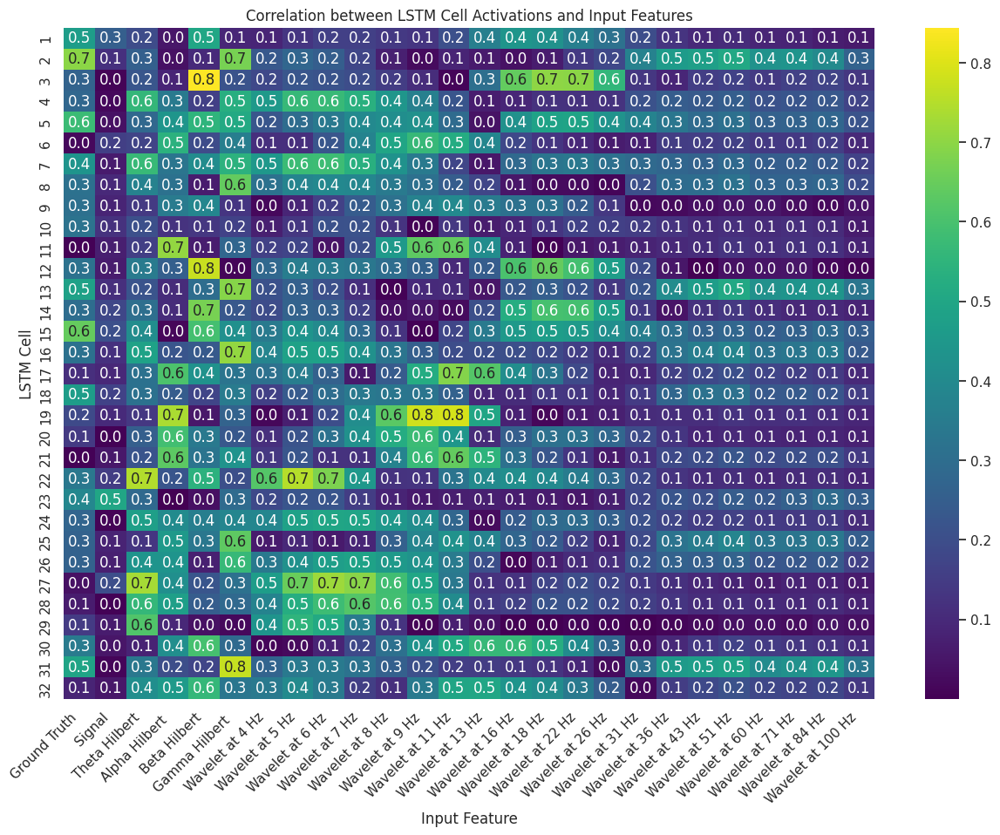

In [ ]:
model_name = "all_features_multi"

cell_activations = extracted_data_dict[model_name]['hidden_states_activation'][-1]

testing_features = tt_splits_dict[model_name]['X_test']

testing_label = tt_splits_dict[model_name]['y_test']
testing_label = np.expand_dims(testing_label, axis=-1)

testing_features = np.concatenate((testing_label, testing_features), axis=-1)
print(testing_features.shape)

features_corr_matrix = create_heatmap_cell_feature_corr(cell_activations, testing_features, absolute=True)

We can see that the hilbert features are most popluar to take as shape. Esepcially the theta one.

My data is slightly skewed to have most gamma oscillations and that could be the reason for it.

In [ ]:
features_corr_matrix.shape

(32, 26)

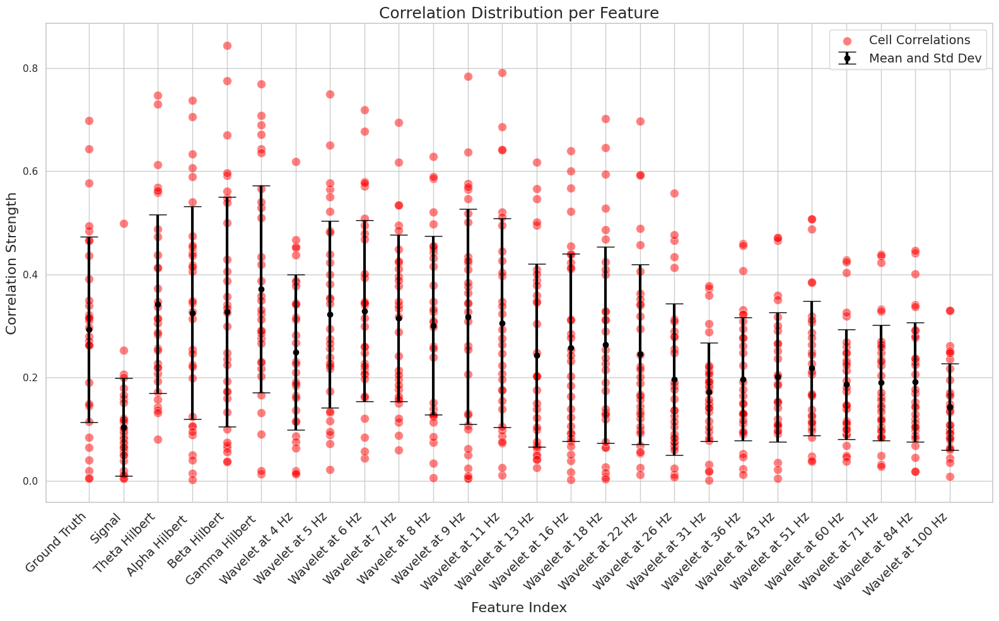

In [ ]:
mean_freqs_round = np.round(np.logspace(np.log10(4), np.log10(100), num=20)).astype(int)
categories = ["Ground Truth", "Signal", "Theta Hilbert", "Alpha Hilbert ", "Beta Hilbert", "Gamma Hilbert "] + \
                [f'Wavelet at {freq} Hz' for freq in mean_freqs_round]

plot_correlation_distribution(abs(features_corr_matrix), x_labels=categories)

In [ ]:
# Shape (correlation, column, row)
# Shape (corr, Cell, Feature)
top_corr = get_top_n_correlations(abs(features_corr_matrix), n=10)
print(top_corr)

[(np.float64(0.844), np.int64(2), np.int64(4)), (np.float64(0.791), np.int64(18), np.int64(12)), (np.float64(0.783), np.int64(18), np.int64(11)), (np.float64(0.775), np.int64(11), np.int64(4)), (np.float64(0.769), np.int64(30), np.int64(5)), (np.float64(0.75), np.int64(21), np.int64(7)), (np.float64(0.747), np.int64(21), np.int64(2)), (np.float64(0.737), np.int64(18), np.int64(3)), (np.float64(0.73), np.int64(26), np.int64(2)), (np.float64(0.719), np.int64(26), np.int64(8))]


Model: all_features_multi 
Sample: 0 
NoiseRatio: 4
X_test shape: (1, 1, 5, 7500)
y_test shape: (1, 1, 5, 7500)
30.0
Top 3 LSTM Cells: [12  1  4]
Bottom 3 LSTM Cells: [ 0 28 13]
(7500, 5, 1)


<ipython-input-82-4f14229a85d4>:121: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  ax[1].legend(loc='lower left')  # Adjust legend location if needed


Dense Weights: 32
Dense Bias: (7500, 32)
(1, 32, 5)
(1, 5)
(5, 32, 7500)


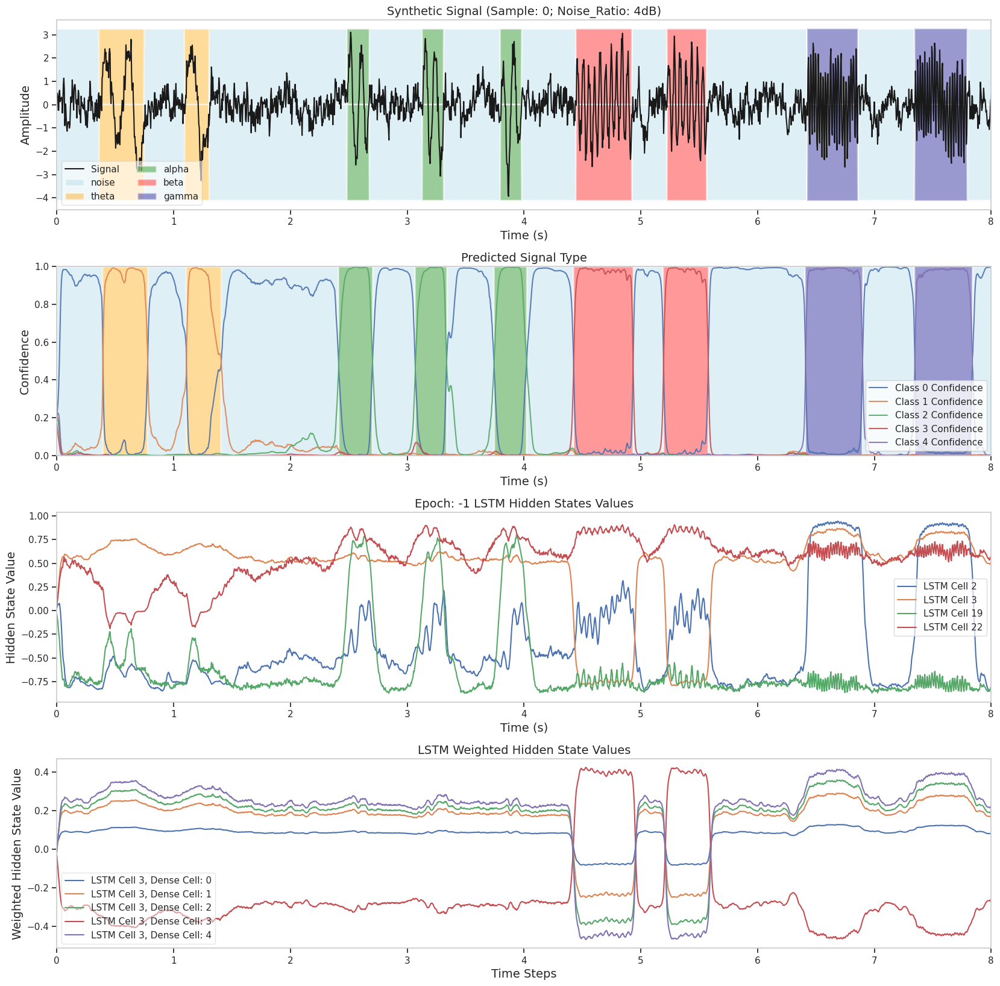

In [ ]:
special_cells = [1, 2, 18, 21]
# Cell 2:  Gamma
# Cell 3:  neg Beta
# Cell 22: neg Theta, pos Beta
# Cell 23: Signal


# Remove dense_weights_ranked as an argument, it's not needed in the function signature.
visualize_hidden_activation_multi(extracted_data_dict_special, tt_splits_dict_special, directory_name=model_name,
                                      sample_number=0, epoch_to_visualize=-1,
                                      top_n=3,
                                      weighted_cells=True,
                                      show_worst_cells=False,
                                      noise_ratio=3,
                                      cells_to_visualize=special_cells,
                                      time_limit=(0, 8),
                                      weighted_cell=2)

In [ ]:
extracted_data_dict.keys()

dict_keys(['all_features_multi', 'signal_multi', 'hilbert_only_multi', 'hilbert_included_multi', 'wavelet_only_multi', 'wavelet_inlcuded_multi'])

### Hilberts

(20, 5, 7500, 6)
(750000, 32)
(750000, 6)
0 0
(750000, 32)
(750000, 6)
0 1
(750000, 32)
(750000, 6)
0 2
(750000, 32)
(750000, 6)
0 3
(750000, 32)
(750000, 6)
0 4
(750000, 32)
(750000, 6)
0 5
(750000, 32)
(750000, 6)
1 0
(750000, 32)
(750000, 6)
1 1
(750000, 32)
(750000, 6)
1 2
(750000, 32)
(750000, 6)
1 3
(750000, 32)
(750000, 6)
1 4
(750000, 32)
(750000, 6)
1 5
(750000, 32)
(750000, 6)
2 0
(750000, 32)
(750000, 6)
2 1
(750000, 32)
(750000, 6)
2 2
(750000, 32)
(750000, 6)
2 3
(750000, 32)
(750000, 6)
2 4
(750000, 32)
(750000, 6)
2 5
(750000, 32)
(750000, 6)
3 0
(750000, 32)
(750000, 6)
3 1
(750000, 32)
(750000, 6)
3 2
(750000, 32)
(750000, 6)
3 3
(750000, 32)
(750000, 6)
3 4
(750000, 32)
(750000, 6)
3 5
(750000, 32)
(750000, 6)
4 0
(750000, 32)
(750000, 6)
4 1
(750000, 32)
(750000, 6)
4 2
(750000, 32)
(750000, 6)
4 3
(750000, 32)
(750000, 6)
4 4
(750000, 32)
(750000, 6)
4 5
(750000, 32)
(750000, 6)
5 0
(750000, 32)
(750000, 6)
5 1
(750000, 32)
(750000, 6)
5 2
(750000, 32)
(750000, 6)
5

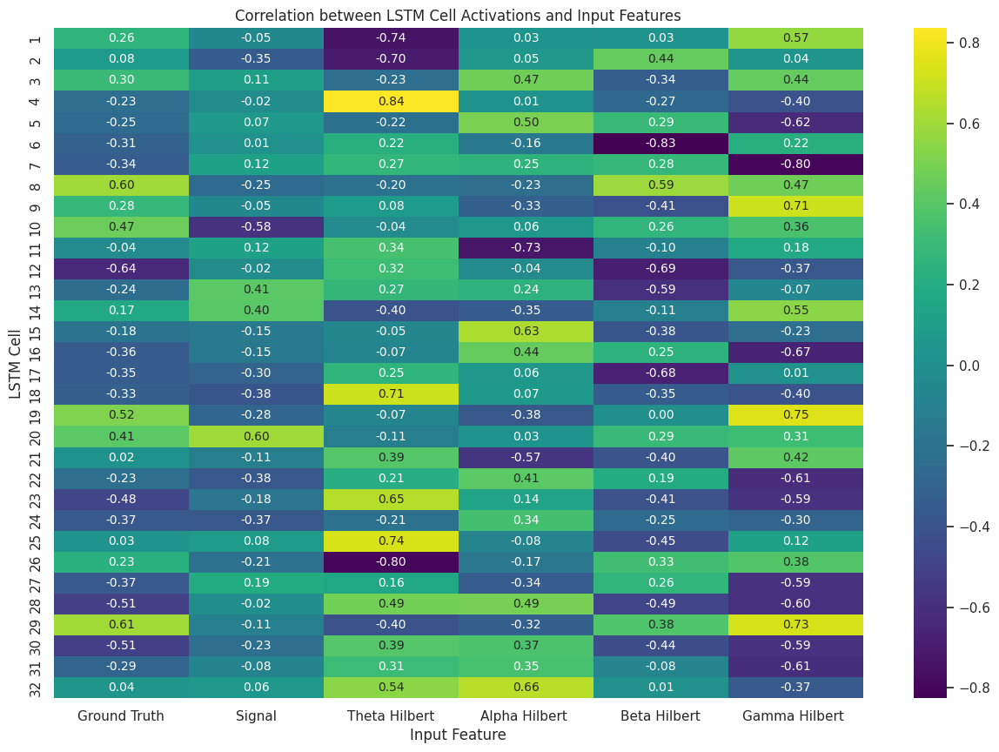

In [ ]:
model_name = "hilbert_included_multi"
cell_activations_hilbert = extracted_data_dict[model_name]['hidden_states_activation'][-1]
testing_hilberts = tt_splits_dict[model_name]['X_test']

testing_label = tt_splits_dict[model_name]['y_test']
testing_label = np.expand_dims(testing_label, axis=-1)

testing_hilberts = np.concatenate((testing_label, testing_hilberts), axis=-1)
print(testing_hilberts.shape)

hilbert_corr_matrix = create_heatmap_cell_feature_corr(cell_activations_hilbert, testing_hilberts,
                                               absolute=False, rounding_factor=.2)




In [ ]:
special_cells = [30, 1, 11, 14] # Indecies so ID - 1
special_cells = [3, 6, 28, 31] # NEW Data
hilbert_only_multi

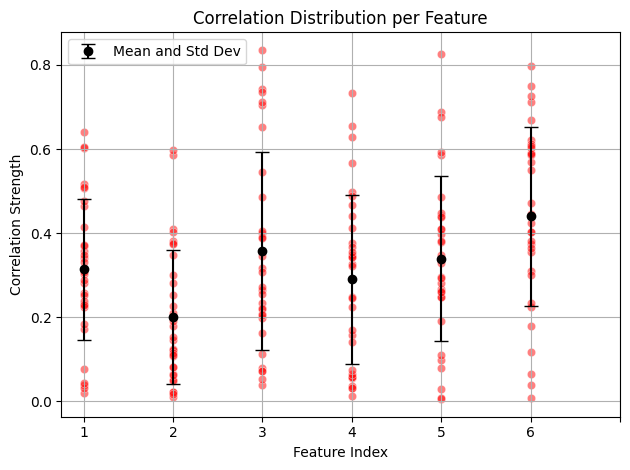

In [ ]:
plot_correlation_distribution(abs(hilbert_corr_matrix))

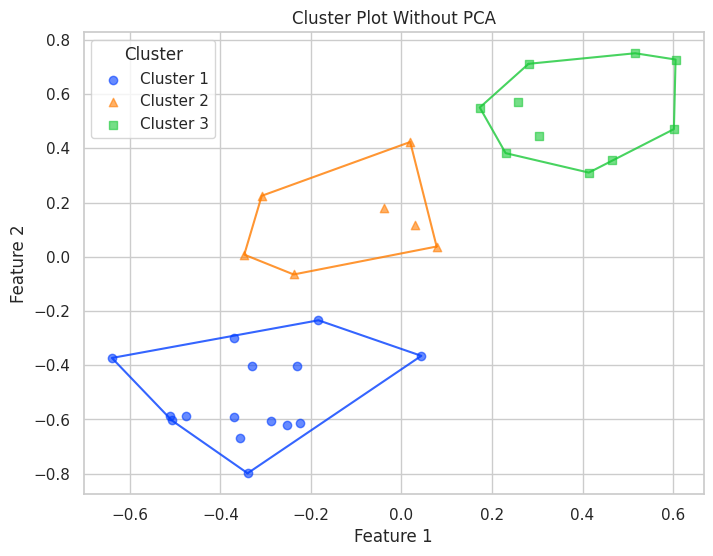

In [ ]:
plot_feature_correlation_kmeans_borders(hilbert_corr_matrix, 0, 5, 3)

Model: hilbert_only_multi 
Sample: 0 
NoiseRatio: -8
X_test shape: (1, 1, 5, 7500, 4)
y_test shape: (1, 1, 5, 7500)
120.0
Top 3 LSTM Cells: [17 14  8]
Bottom 3 LSTM Cells: [1 6 5]
(7500, 5, 1)
F Samples (7500,)
X: 0
Feature Samples: (7500,)
X: 1
Feature Samples: (7500,)
X: 2
Feature Samples: (7500,)
X: 3
Feature Samples: (7500,)
Dense Weights: 32
Dense Bias: (7500, 32)


<ipython-input-175-7569309987c3>:122: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  ax[1].legend(loc='upper left')  # Adjust legend location if needed


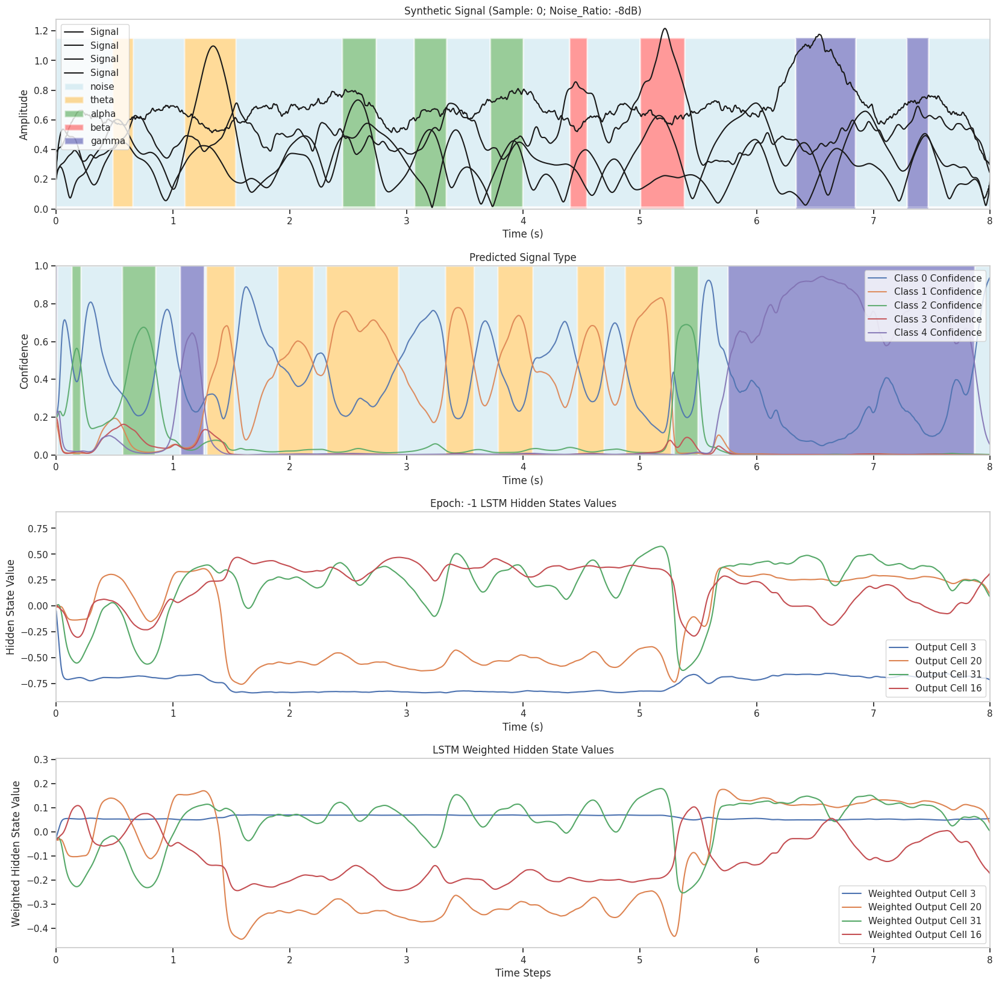

In [ ]:

# Remove dense_weights_ranked as an argument, it's not needed in the function signature.
visualize_hidden_activation_multi(extracted_data_dict_special, tt_splits_dict_special, directory_name=model_name,
                                      sample_number=0, epoch_to_visualize=-1,
                                      top_n=3,
                                      weighted_cells=True,
                                      show_worst_cells=False,
                                      noise_ratio=0,
                                      cells_to_visualize=special_cells,
                                      time_limit=(0, 8),)

(7500,)
(7500,)
(7500, 4)


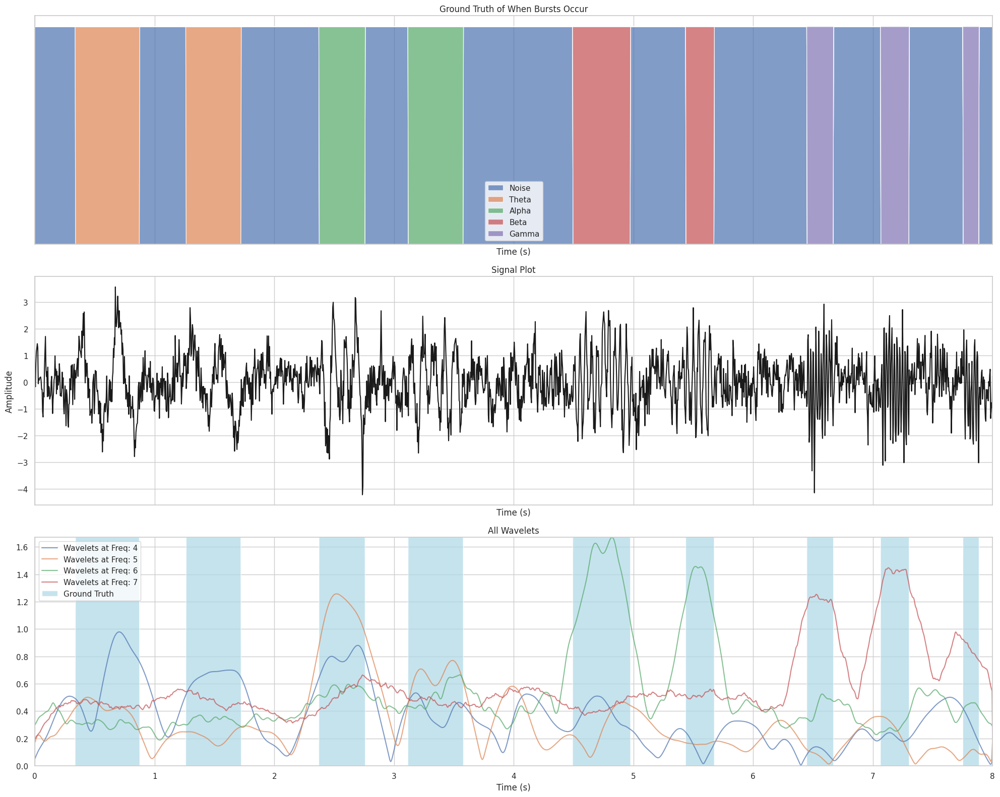

In [ ]:
sample = 0
noise = 2
model_name = "hilbert_included_multi"
# Extract data for the specified noise level
signal_sample = tt_splits_dict_special[model_name]['X_test'][0,sample, noise, :, 0] # Gets only the signal (works for featue Xs as well)
label_sample = tt_splits_dict_special[model_name]['y_test'][0,sample, noise, :]
feature_sample = tt_splits_dict_special[model_name]['X_test'][0,sample, noise, :, 1:] # Gets only the signal (works for featue Xs as well)

print(signal_sample.shape)
print(label_sample.shape)
print(feature_sample.shape)

du.visualize_feature_data(label_sample, signal_sample, feature_sample,
                          sampling_frequency=250, duration=30, time_window=(0, 8),
                          category_labels=["Noise", "Theta", "Alpha", "Beta", "Gamma"])

### Signal Only

In [ ]:
extracted_data_dict.keys()

dict_keys(['all_features_multi', 'signal_multi', 'hilbert_included_multi', 'wavelet_inlcuded_multi'])

(20, 5, 7500, 2)


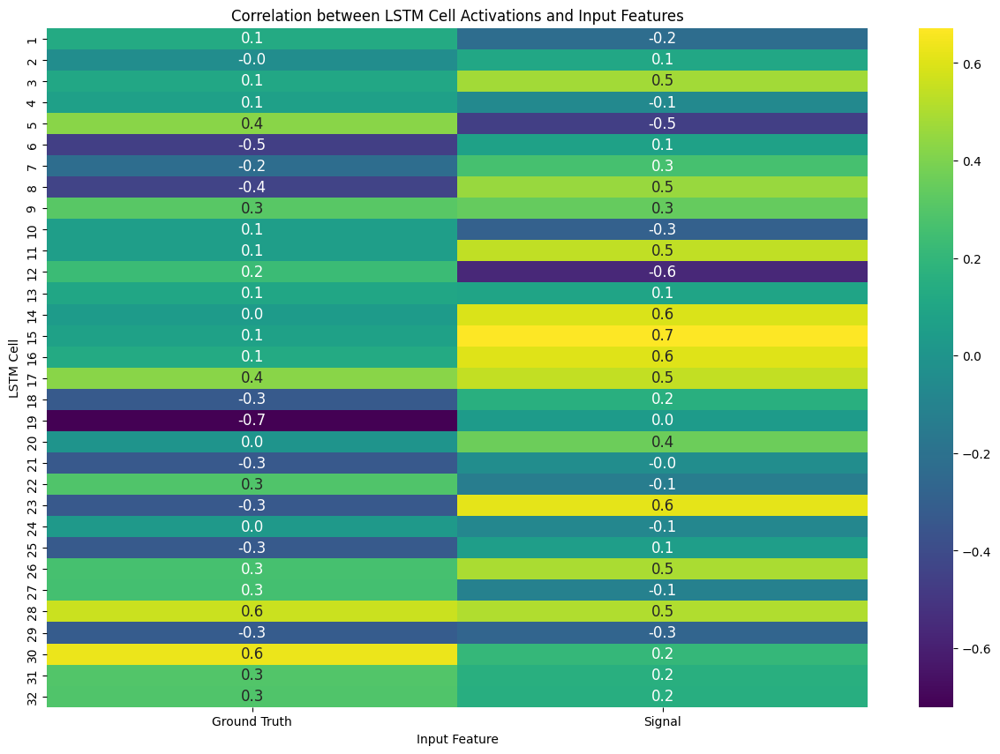

In [ ]:
model_name = "signal_multi"

cell_activations_signal = extracted_data_dict[model_name]['hidden_states_activation'][-1]
testing_signal = tt_splits_dict[model_name]['X_test']
testing_label = tt_splits_dict[model_name]['y_test']

testing_label = np.expand_dims(testing_label, axis=-1)
testing_features = np.concatenate((testing_label, testing_signal), axis=-1)

print(testing_features.shape)

signal_corr_matrix = create_heatmap_cell_feature_corr(cell_activations_signal, testing_features, absolute=False)

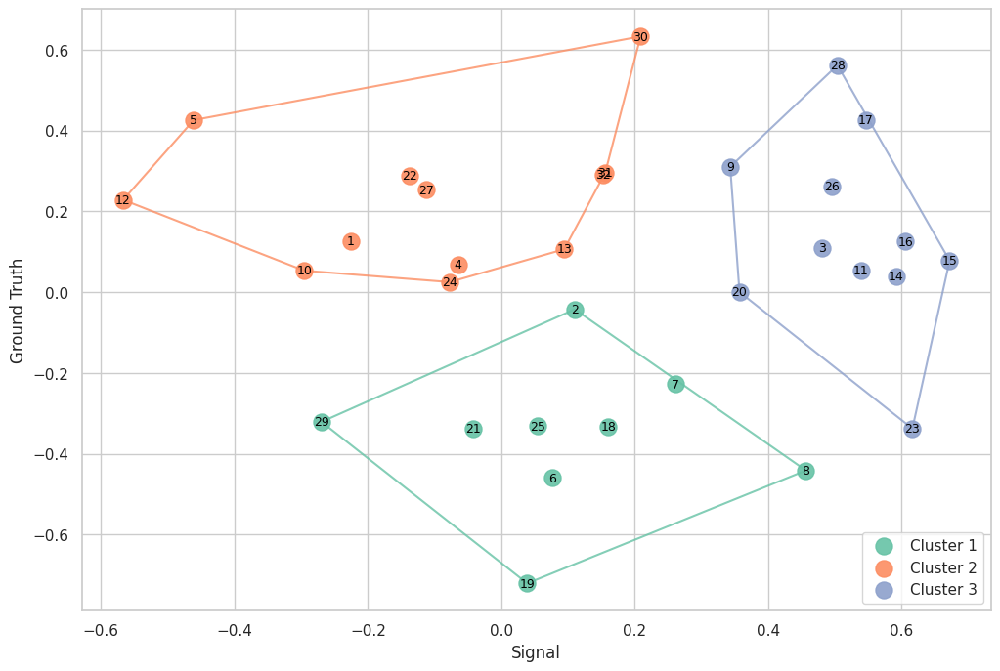

[[2, 6, 7, 8, 18, 19, 21, 25, 29],
 [1, 4, 5, 10, 12, 13, 22, 24, 27, 30, 31, 32],
 [3, 9, 11, 14, 15, 16, 17, 20, 23, 26, 28]]

In [ ]:
feature_names = ["Signal", "Ground Truth"]

plot_feature_correlation_kmeans_borders(signal_corr_matrix, 1, 0, 3, feature_names=feature_names)

In [ ]:
extracted_data_dict[model_name]['hidden_states_activation'].shape

(1, 20, 5, 7500, 32)

In [ ]:
def calculate_all_weighted_activations(lstm_outputs, dense_weights, dense_bias):
    """Calculates the weighted contributions of LSTM cells to each output neuron.

    Args:
        lstm_outputs (np.ndarray): The output of the LSTM layer (shape: [lstm_units, timesteps]).
        dense_weights (np.ndarray): The weights of the dense layer (shape: [lstm_units, output_neurons]).
        dense_bias (np.ndarray): The bias of the dense layer (shape: [output_neurons]).

    Returns:
        np.ndarray: The weighted activations of the LSTM cells for each output neuron (shape: [output_neurons, lstm_units, timesteps]).
    """
    weighted_activations = []
    for i in range(dense_weights.shape[1]):  # Iterate over output neurons
        weighted_activations.append(lstm_outputs * dense_weights[:, i, np.newaxis] + dense_bias[i])
    # Convert the list of arrays to a NumPy array with the correct shape
    return np.array(weighted_activations) # changed from np.ndarray(weighted_activations) to np.array(weighted_activations)

Model: signal_multi 
Sample: 0 
NoiseRatio: 0
X_test shape: (1, 1, 5, 7500)
y_test shape: (1, 1, 5, 7500)
30.0
Top 3 LSTM Cells: [29 22 15]
Bottom 3 LSTM Cells: [26 14  6]
(7500, 5, 1)


<ipython-input-83-bedb4aa04191>:117: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  ax[1].legend(loc='upper left')  # Adjust legend location if needed


Dense Weights: 32
Dense Bias: (7500, 32)
(1, 32, 5)
(1, 5)
(5, 32, 7500)


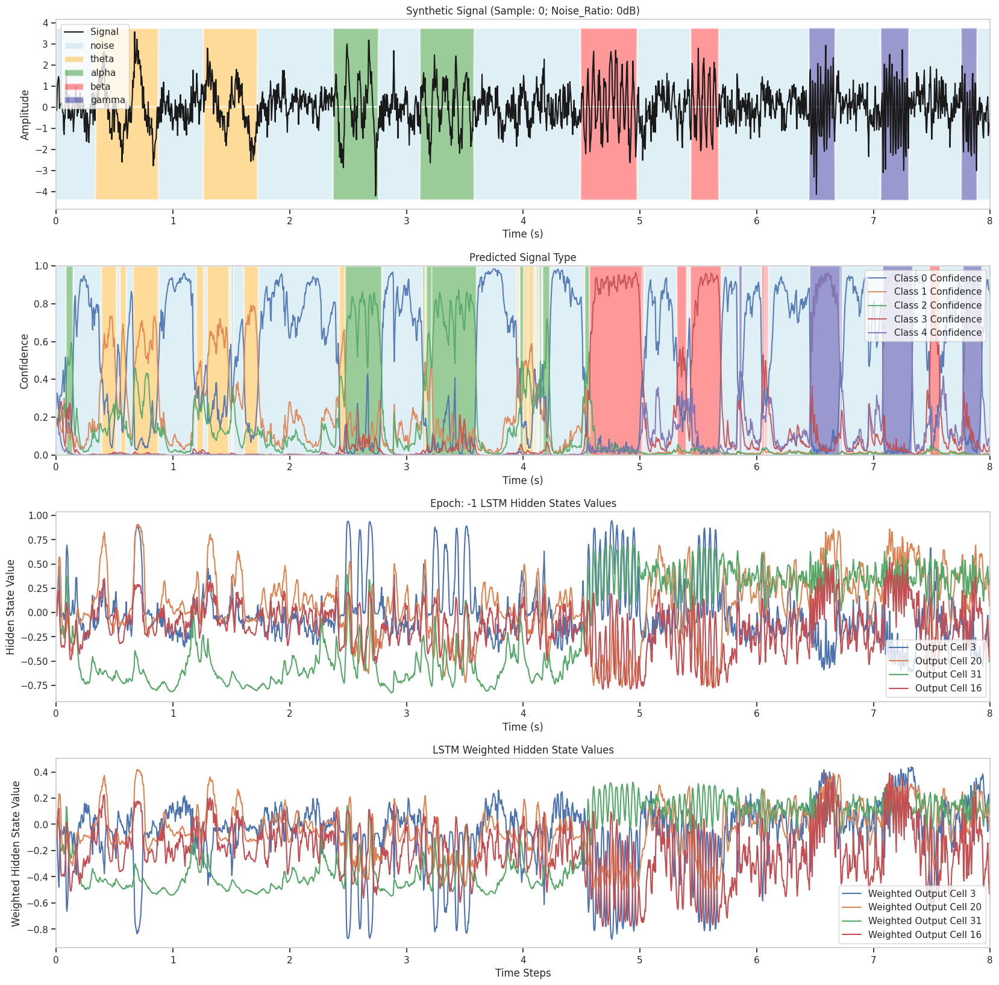

In [ ]:
special_cells = [2, 19, 30, 15]
special_cells = [19]

# Remove dense_weights_ranked as an argument, it's not needed in the function signature.
visualize_hidden_activation_multi(extracted_data_dict_special, tt_splits_dict_special, directory_name=model_name,
                                      sample_number=0, epoch_to_visualize=-1,
                                      top_n=3,
                                      weighted_cells=True,
                                      show_worst_cells=False,
                                      noise_ratio=2,
                                      cells_to_visualize=special_cells,
                                      time_limit=(0, 8),)

## Cells on Frequency

Instead of focussing on how well each cell represents a feature, I know want to focus on how each cell performs overall against frequency.

This will show whether cell are focused on one specific frequency or all frequencies.

In [ ]:
extracted_data_dict.keys()

dict_keys(['all_features_multi', 'signal_multi', 'hilbert_only_multi', 'hilbert_included_multi', 'wavelet_only_multi', 'wavelet_inlcuded_multi'])

### All Features

(20, 5, 7500, 32)
(20, 5, 7500)


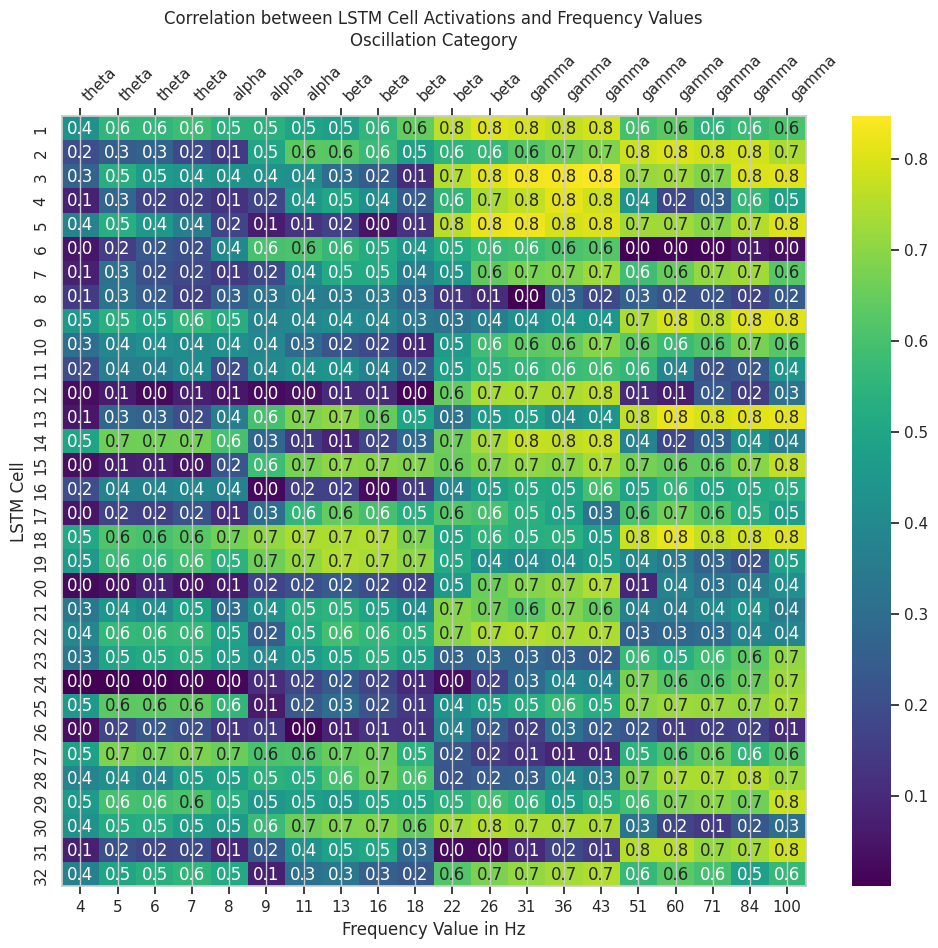

In [ ]:
cell_activations_feature = extracted_data_dict['all_features_multi']['hidden_states_activation'][-1]

y_labels_feature = tt_splits_dict['all_features_multi']['y_test']

print(cell_activations_feature.shape)
print(y_labels_feature.shape)

correlation_matrix = create_heatmap_cell_frequency_corr(cell_activations_feature, y_labels_feature, absolute=True)


In [ ]:
correlation_matrix = create_heatmap_cell_oscillation_corr(cell_activations_feature, y_labels_feature, absolute=True, rounding_factor=.2)

NameError: name 'cell_activations_feature' is not defined

Cell 11 is interesting, because it shows high correlation with theta, alpha and gamma but 0.06 correlation with beta. An oscillation that right in the middle

### Hilberts

(20, 5, 7500, 32)
(20, 5, 7500, 1)


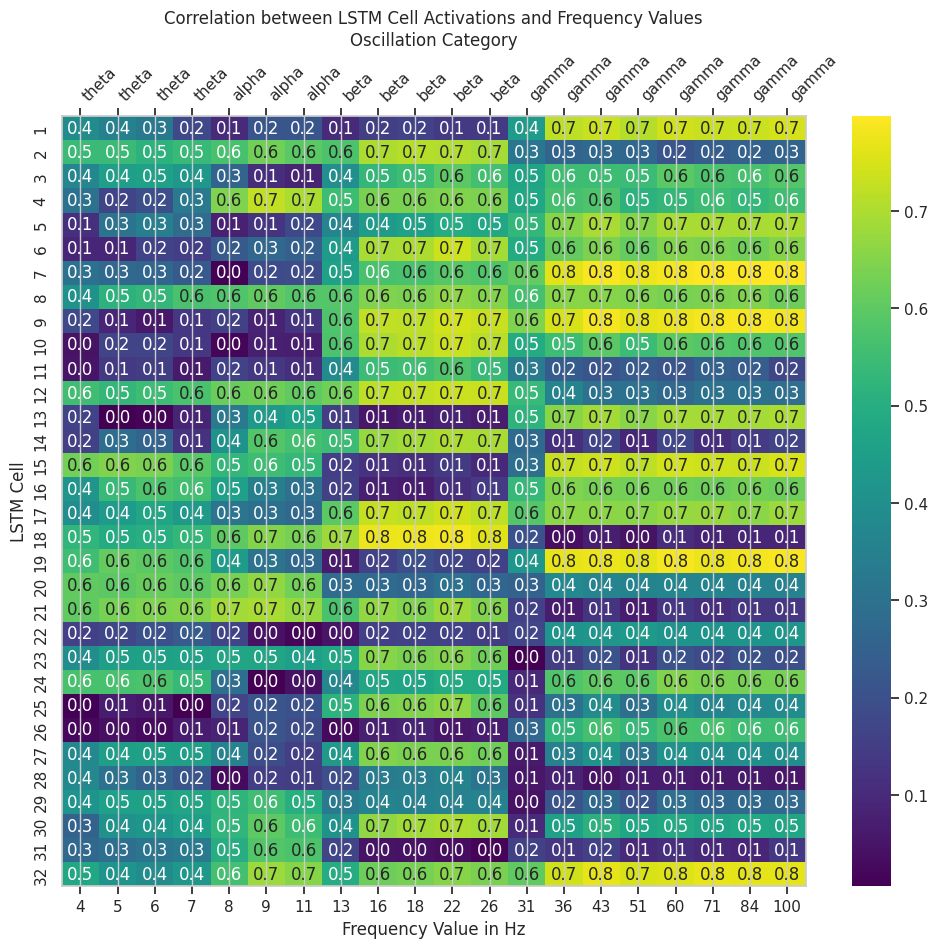

In [ ]:
cell_activations_hilbert = extracted_data_dict['mid_noise_hilbert_multi']['hidden_states_activation'][-1]

y_labels_hilbert = tt_splits_dict['mid_noise_hilbert_multi']['y_test']

print(cell_activations_signal.shape)
print(testing_label.shape)

correlation_matrix = create_heatmap_cell_frequency_corr(cell_activations_hilbert, y_labels_hilbert, absolute=True)


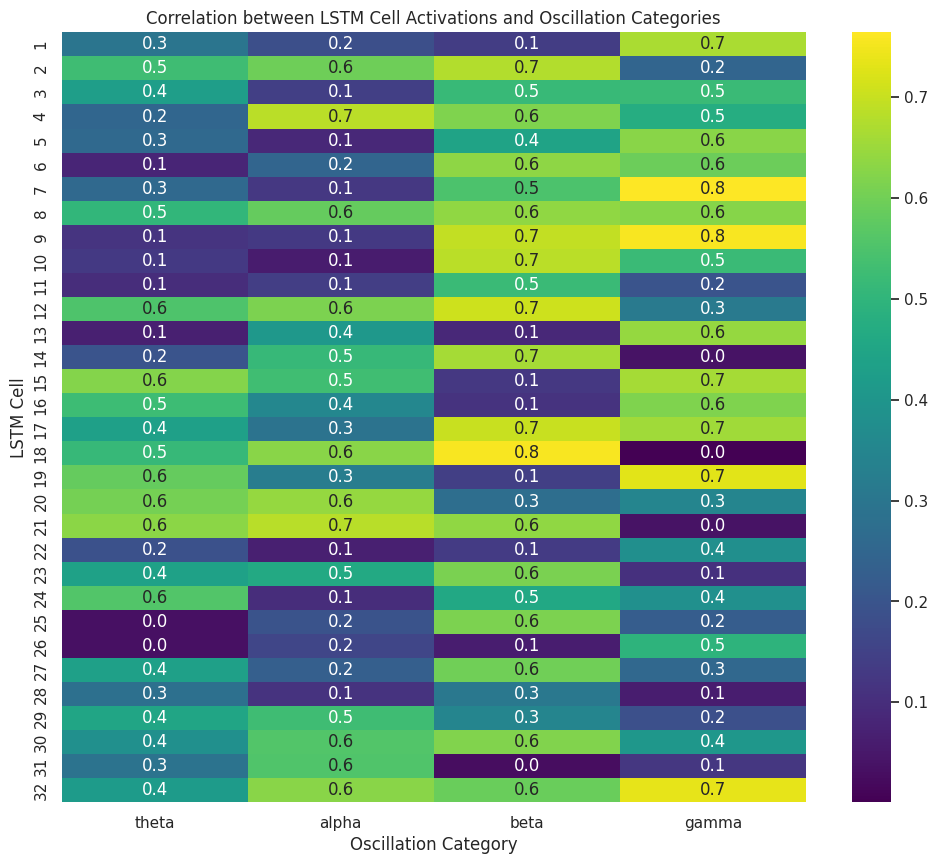

In [ ]:
correlation_matrix = create_heatmap_cell_oscillation_corr(cell_activations_hilbert, y_labels_hilbert, absolute=True, )


### Signal Only

(20, 5, 7500, 32)


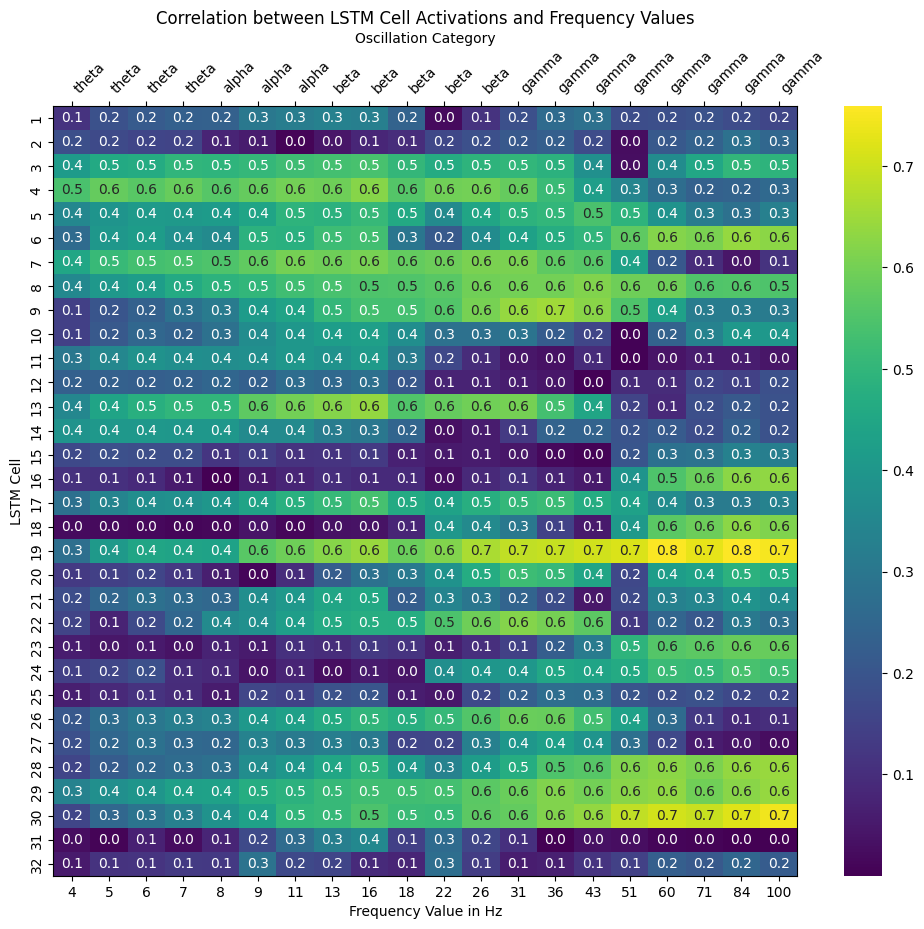

In [ ]:
cell_activations_signal = extracted_data_dict['signal_multi']['hidden_states_activation'][-1]
testing_signal = tt_splits_dict['signal_multi']['X_test']
y_labels = tt_splits_dict['signal_multi']['y_test']

print(cell_activations_signal.shape)
# print(testing_label.shape)

correlation_matrix = create_heatmap_cell_frequency_corr(cell_activations_signal, y_labels, absolute=True)


In [ ]:
correlation_matrix = create_heatmap_cell_oscillation_corr(cell_activations_signal, y_labels, absolute=True, rounding_factor=.2)

0 theta


KeyError: 'mid_noise_all_features_multi'

Model: mid_noise_all_features_multi 
Sample: 10 
NoiseRatio: 0


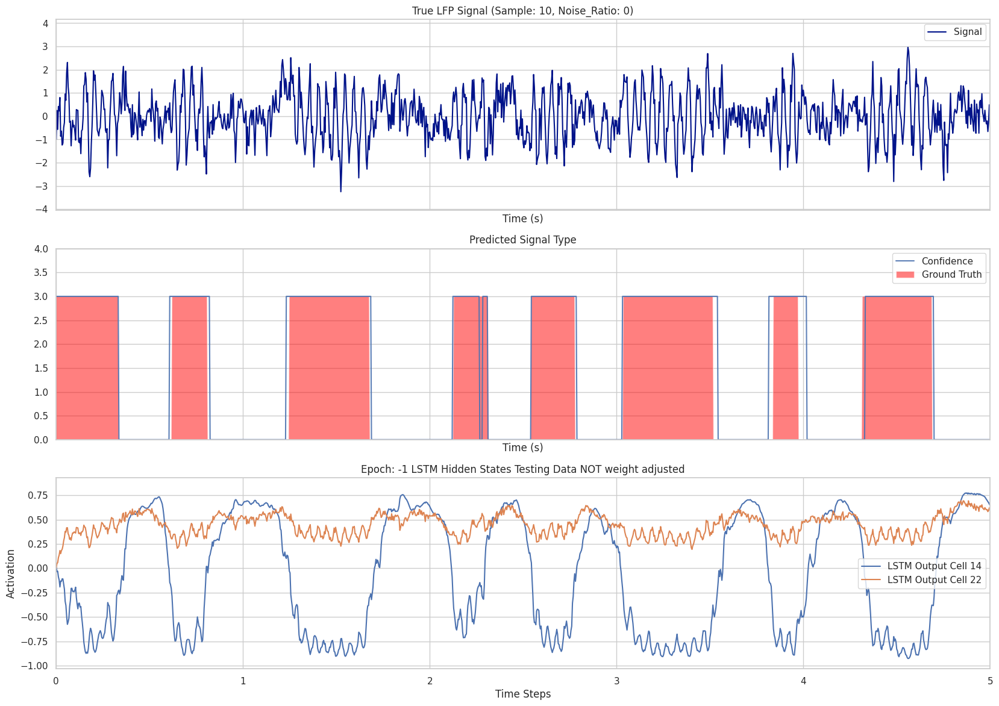

In [ ]:
special_cells = [13, 21]
visualize_hidden_activation_multi(extracted_data_dict, tt_splits_dict, directory_name='mid_noise_all_features_multi',
                                      sample_number=10, epoch_to_visualize=-1,
                                      noise_ratio=2,
                                      cells_to_visualize=special_cells)

## Cells on Noise Levels

In [ ]:

def create_heatmap_cell_noise_corr(hidden_activations, y_labels, correlation_metric=np.corrcoef, absolute=False, rounding_factor=.1):
    """
    Creates a heatmap showing correlation between cell activations and frequency values.

    Args:
        hidden_activations (np.ndarray): Hidden activations of shape (20, 5, 7500, 32).
        y_labels (np.ndarray): Labels of shape (20, 5, 7500).
        correlation_metric (function, optional): The correlation metric function to use. Defaults to np.corrcoef.

    Returns:
        None: Displays the heatmap.
    """
    y_labels = y_labels.copy()
    # Modify all bursts to be binary, maybe correaltions more meaningfull that way
    # y_labels[y_labels > 1] = 1
    # y_labels[y_labels < 1] = -1

    num_noises = hidden_activations.shape[1]  # 5 noise values
    num_cells = hidden_activations.shape[-1]  # 32 cells

    noise_values = [-8,-4,0,4,8]

    correlation_matrix = np.zeros((num_cells, num_noises))

    for noise_idx in range(num_noises):
        # Reshape activations and labels for this frequency
        activations_for_frequency = hidden_activations[:,noise_idx].reshape(-1, num_cells)
        labels_for_frequency = y_labels[:,noise_idx].flatten()

        # Calculate correlation for each cell
        for cell_index in range(num_cells):
            correlation_matrix[cell_index, noise_idx] = correlation_metric(
                activations_for_frequency[:, cell_index], labels_for_frequency)[0, 1]
    if absolute:
        correlation_matrix = np.abs(correlation_matrix)

    # Create and display heatmap
    fig, ax1 = plt.subplots(figsize=(12, 10))  # Adjust figure size as needed
    sns.heatmap(correlation_matrix, annot=True, cmap="viridis", fmt=f"{rounding_factor}f",
                xticklabels=noise_values, yticklabels=range(1, num_cells + 1), ax=ax1)
    ax1.set_title("Correlation between LSTM Cell Activations and groundtruth for different noise levels")
    ax1.set_xlabel("Burst-Noise Ratio in dB")
    ax1.set_ylabel("LSTM Cell")

    plt.show()

    return correlation_matrix

### All Features

(20, 5, 7500, 32)
(20, 5, 7500)
[3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3
 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3
 3 3 3 3 3 3 3 3 3 3 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
[3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3
 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3
 3 3 3 3 3 3 3 3 3 3 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]


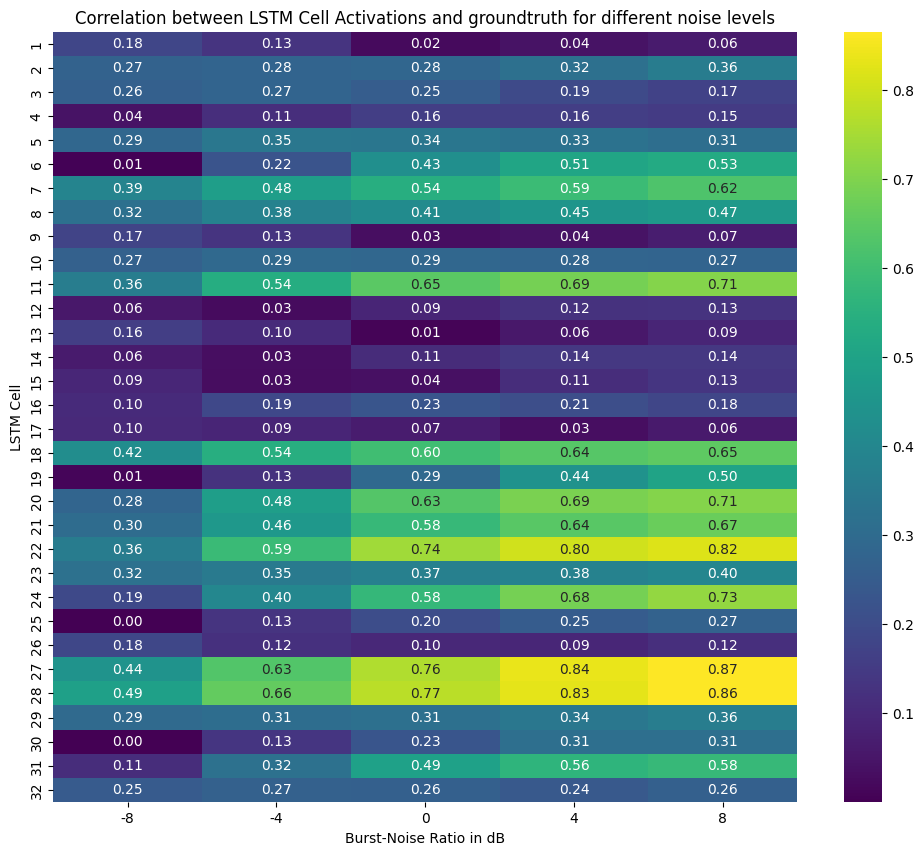

In [ ]:
cell_activations_feature = extracted_data_dict['mid_noise_all_features_multi']['hidden_states_activation'][-1]

y_labels_feature = tt_splits_dict['mid_noise_hilbert_multi']['y_test']

print(cell_activations_feature.shape)
print(y_labels_feature.shape)

print(y_labels_feature[10,2,:100])

correlation_matrix = create_heatmap_cell_noise_corr(cell_activations_feature, y_labels_feature, absolute=True, rounding_factor=.2)


What is the most telling correlation metric?

Leaving the value range for bursts between 1 and 4 gives a strongly different result, than setting all burst vals to 1.

Model: mid_noise_all_features_multi 
Sample: 15 
NoiseRatio: 8


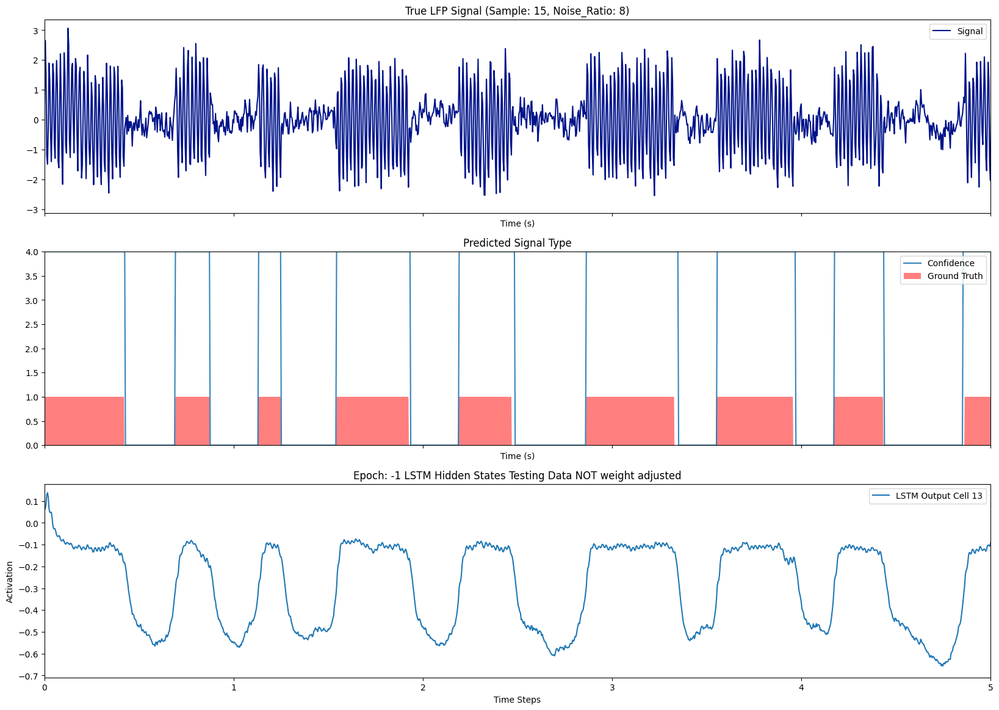

In [ ]:
special_cells = [12]
visualize_hidden_activation_multi(extracted_data_dict, tt_splits_dict, directory_name='mid_noise_all_features_multi',
                                      sample_number=15, epoch_to_visualize=-1,
                                      noise_ratio=4,
                                      cells_to_visualize=special_cells)

Cell 23 (ID22) is very interesting.

It has an inverse relationship for all frequencies except for gamma freqs. Maybe thats the reason why its overall correlation is very poor.

Cell 13 (ID12) is also interesting. It gets punished for having very strong activations during lower frequency bursts, which are smaller.

This metric is not very telling because the cells behavior is so unpredictable, when normed of the whole range of frequencies

### Hilbert

(20, 5, 7500, 32)
(20, 5, 7500)
[3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3
 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3
 3 3 3 3 3 3 3 3 3 3 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]


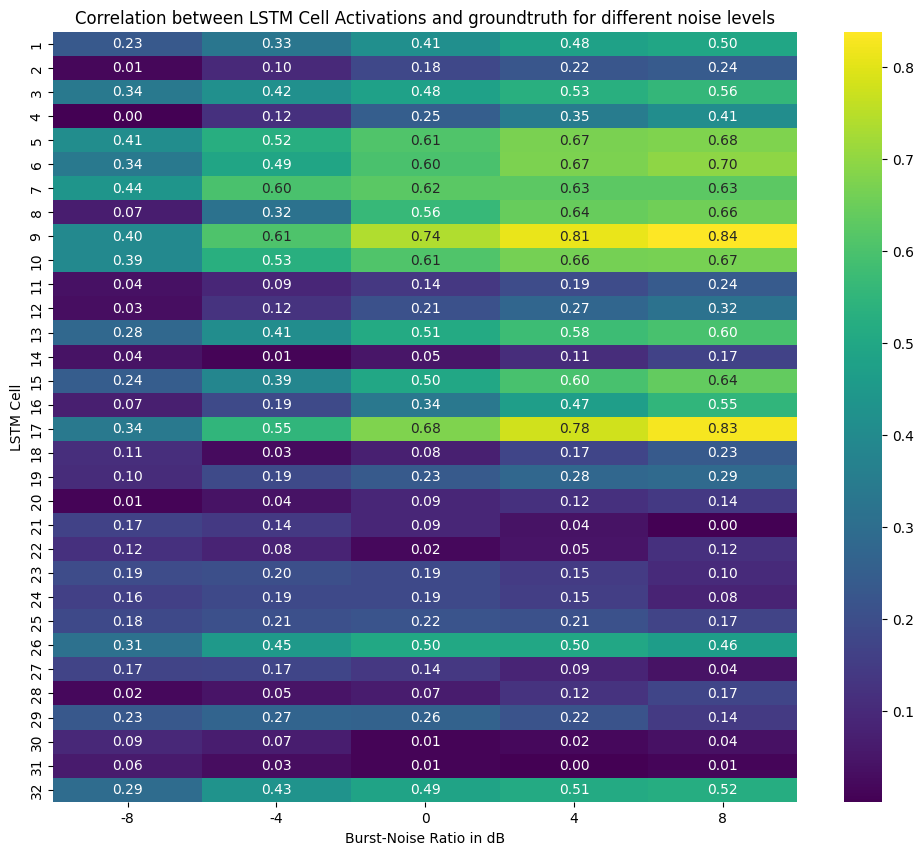

In [ ]:
cell_activations_feature = extracted_data_dict['mid_noise_hilbert_multi']['hidden_states_activation'][-1]

y_labels_feature = tt_splits_dict['mid_noise_hilbert_multi']['y_test']

print(cell_activations_feature.shape)
print(y_labels_feature.shape)

correlation_matrix = create_heatmap_cell_noise_corr(cell_activations_feature, y_labels_feature, absolute=True, rounding_factor=.2)


### Signal Only

(20, 5, 7500, 32)
(20, 5, 7500)
[3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3
 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3
 3 3 3 3 3 3 3 3 3 3 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]


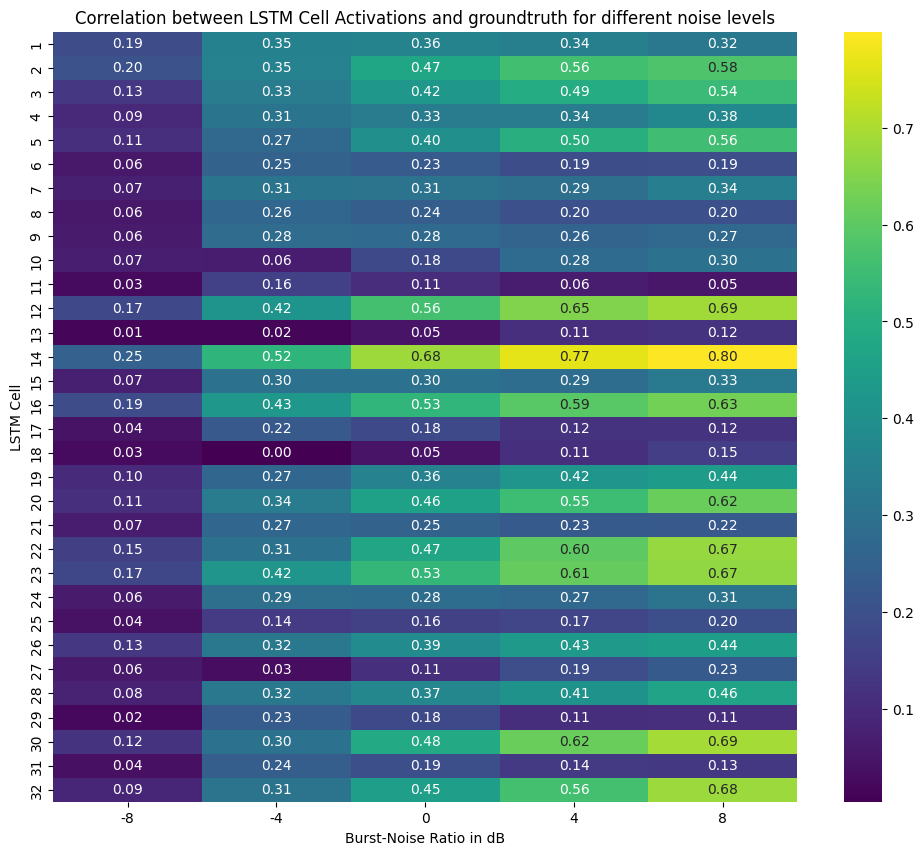

In [ ]:
cell_activations_feature = extracted_data_dict['mid_noise_signal_multi']['hidden_states_activation'][-1]

y_labels_feature = tt_splits_dict['mid_noise_signal_multi']['y_test']

print(cell_activations_feature.shape)
print(y_labels_feature.shape)

correlation_matrix = create_heatmap_cell_noise_corr(cell_activations_feature, y_labels_feature, absolute=True, rounding_factor=.2)


I am hoping for meaning here, because the cells from this model seem less sophisticated

Model: mid_noise_signal_multi 
Sample: 15 
NoiseRatio: -4


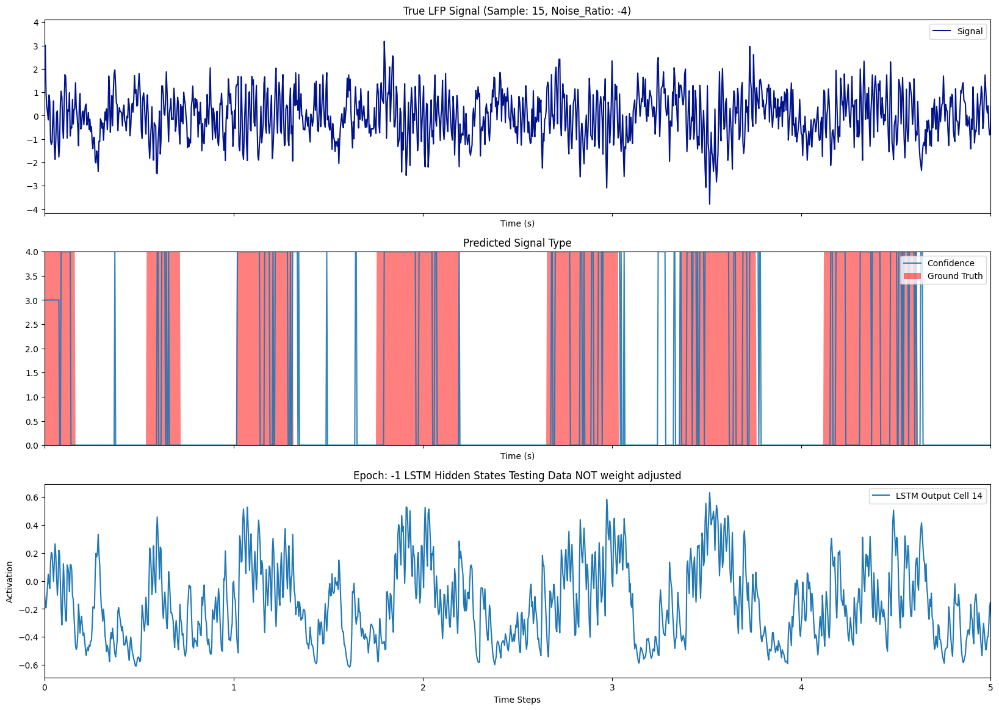

In [ ]:
special_cells = [13]
visualize_hidden_activation_multi(extracted_data_dict, tt_splits_dict, directory_name='mid_noise_signal_multi',
                                      sample_number=15,
                                      epoch_to_visualize=-1,
                                      noise_ratio=1,
                                      cells_to_visualize=special_cells)

## Weighted Cells on Oscillation Types

### All Features

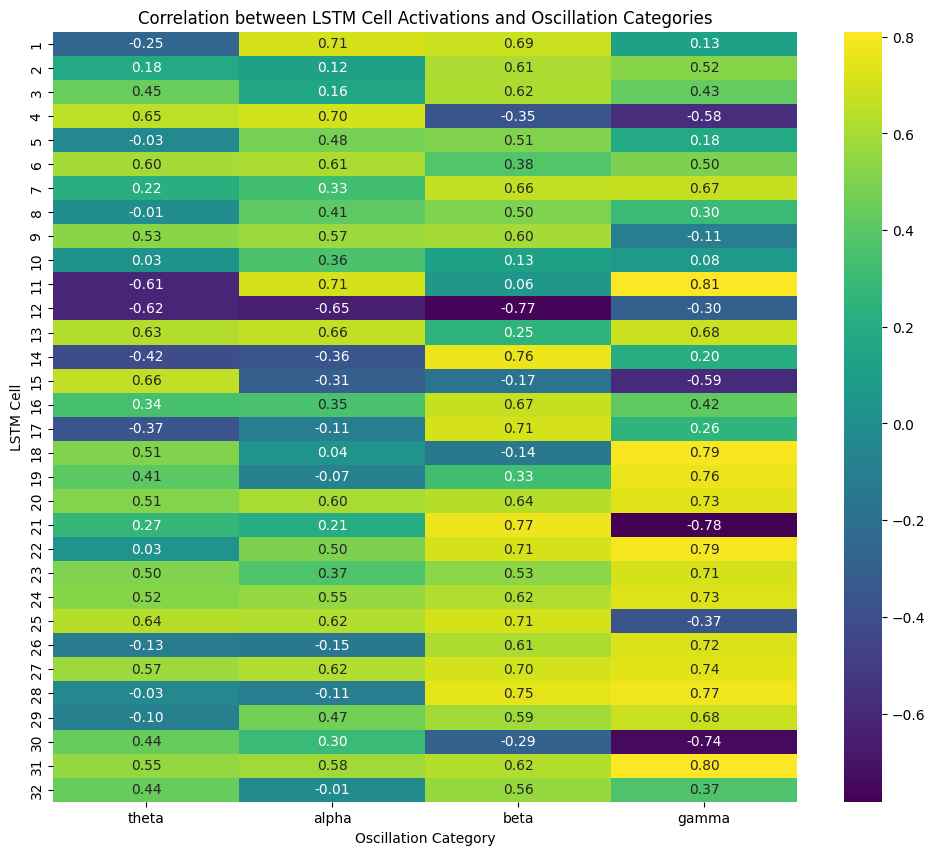

In [ ]:
corr_matix = create_heatmap_weighted_cell_oscillation_corr(extracted_data_dict, model_name='mid_noise_all_features_multi', absolute=False, rounding_factor=.2)

Model: mid_noise_all_features_multi 
Sample: 2 
NoiseRatio: 0
Top 4 LSTM Cells: [31 20 29 27]
Bottom 4 LSTM Cells: [16 26  9  1]
Dense Weights: 32
Dense Bias: (7500, 32)


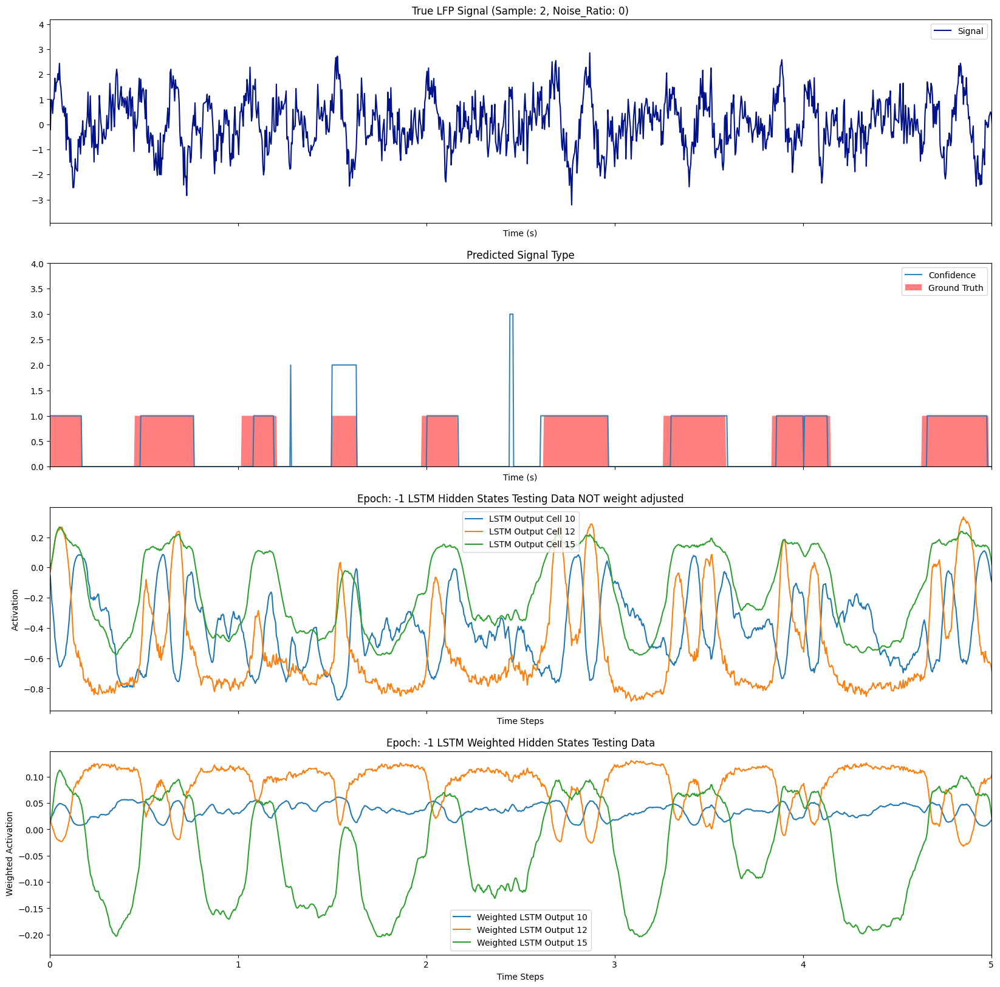

In [ ]:
# Theta
# We visualize a cells with [no, strong negative, strong positive] correlations with theta
special_cells = [9,11,14]
visualize_hidden_activation_multi(extracted_data_dict, tt_splits_dict, directory_name='mid_noise_all_features_multi',
                                      sample_number=2, epoch_to_visualize=-1,
                                      noise_ratio=2,
                                      cells_to_visualize=special_cells,
                                      weighted_cells=True)

The weighted activation shows, how the corresponding output cell for that oscillation wheighs certain cells. Interestingly enough it decides to make some strong correlating features invese related in the aftermath. Potentially because it doesn't want to overshoot its final prediction value of around 1.

### Hilbert

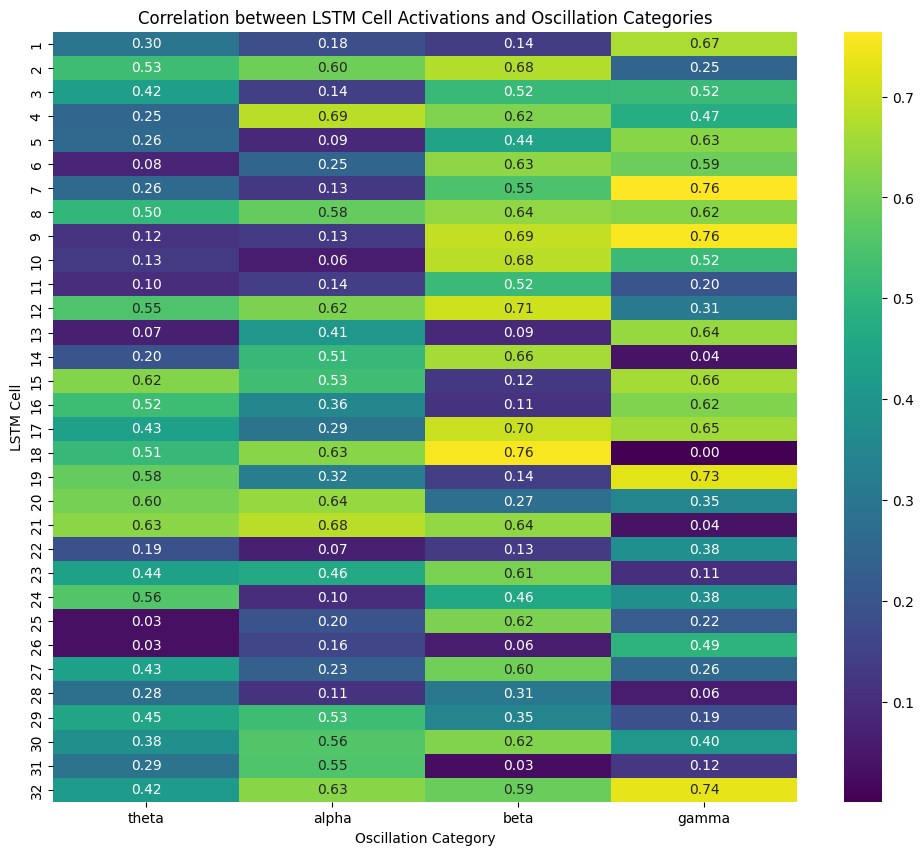

In [ ]:
corr_matix = create_heatmap_weighted_cell_oscillation_corr(extracted_data_dict, model_name='mid_noise_hilbert_multi', absolute=True, rounding_factor=.2)

### Signal Only

In [ ]:
model_name = "signal_multi"
print(extracted_data_dict[model_name]['hidden_states_activation'][-1].shape)
tt_splits_dict[model_name]['X_test'].shape

(20, 5, 7500, 32)


(20, 5, 7500, 1)

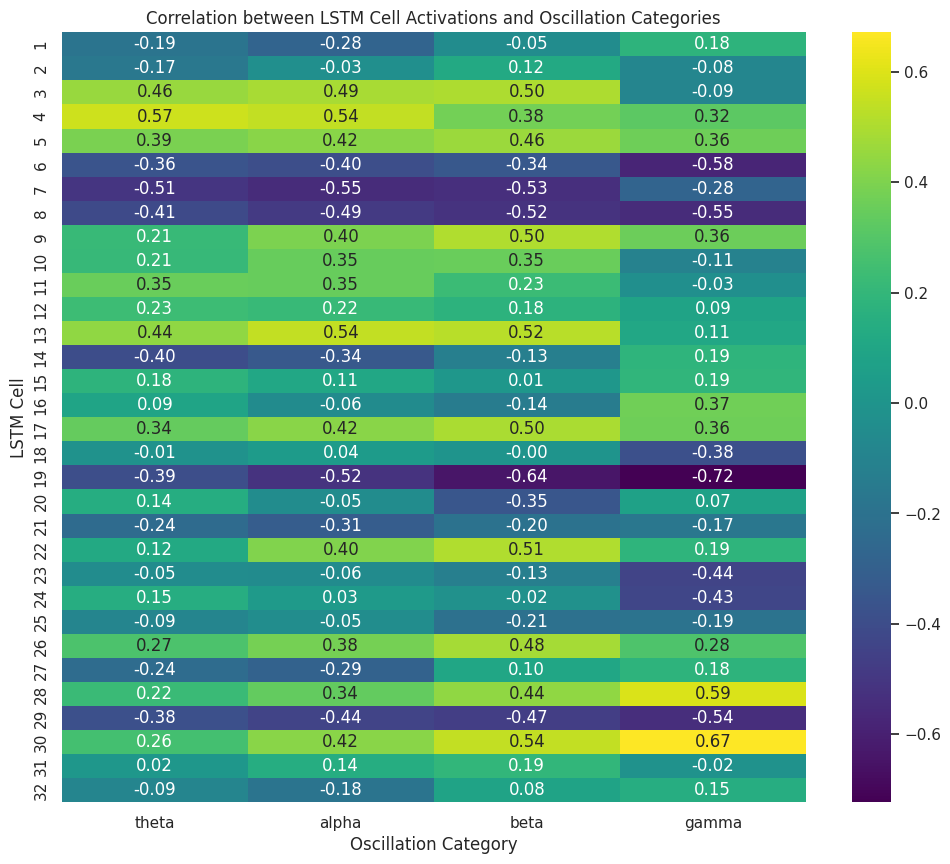

In [ ]:
corr_matix = create_heatmap_weighted_cell_oscillation_corr(extracted_data_dict, model_name='signal_multi', absolute=False, rounding_factor=.2)

Model: signal_multi 
Sample: 0 
NoiseRatio: 4
X_test shape: (1, 1, 5, 7500)
y_test shape: (1, 1, 5, 7500)
30.0
Top 3 LSTM Cells: [29 22 15]
Bottom 3 LSTM Cells: [26 14  6]
(7500, 5, 1)


<ipython-input-67-daf713fad29a>:121: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  ax[1].legend(loc='lower left')  # Adjust legend location if needed


Dense Weights: 32
Dense Bias: (7500, 32)
(1, 32, 5)
(1, 5)
(5, 32, 7500)


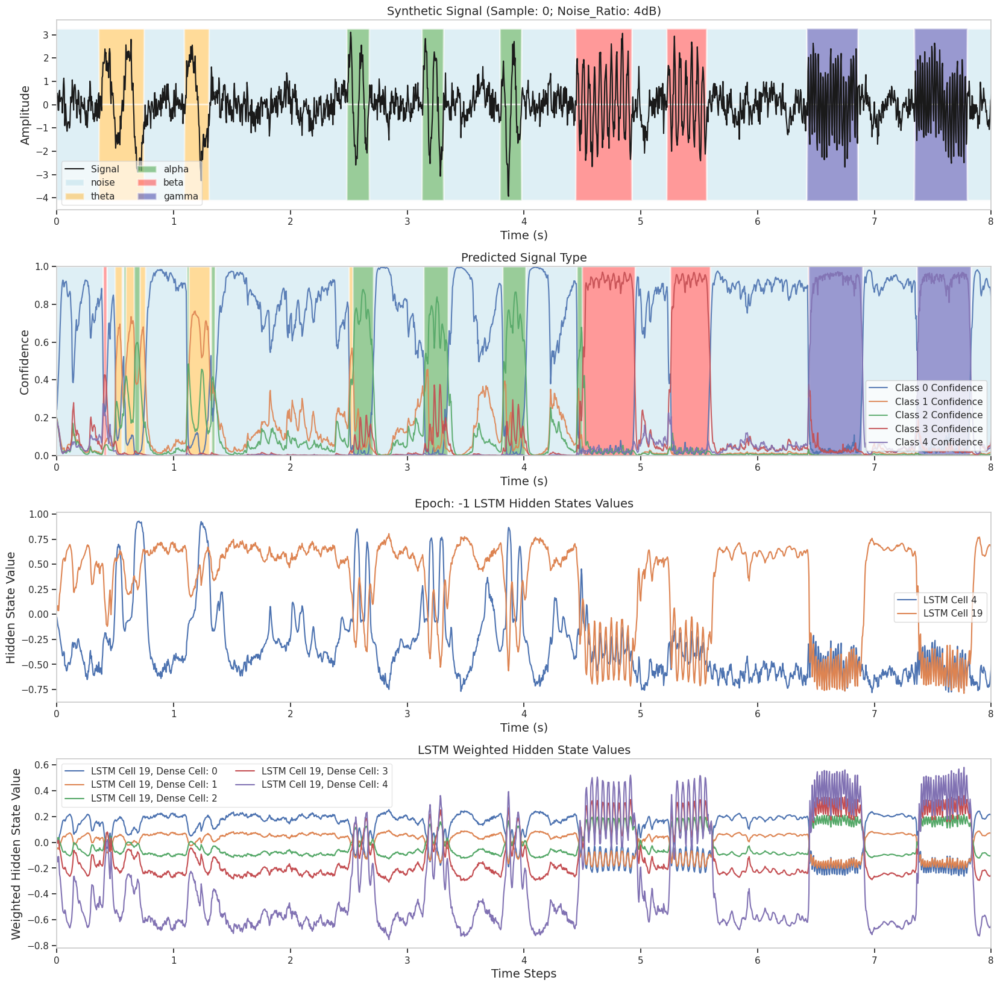

In [ ]:
special_cells = [ 3, 18]
# Cell 4: Good Theta, Alpha; Bad Beta, Gamma
model_name = "signal_multi"
# Remove dense_weights_ranked as an argument, it's not needed in the function signature.
visualize_hidden_activation_multi(extracted_data_dict_special, tt_splits_dict_special, directory_name=model_name,
                                      sample_number=0, epoch_to_visualize=-1,
                                      top_n=3,
                                      weighted_cells=True,
                                      show_worst_cells=False,
                                      noise_ratio=3,
                                      cells_to_visualize=special_cells,
                                      time_limit=(0, 8),
                                      weighted_cell=18)

## Cell Activation Corr w/ Model Continous Predicition

Isnt this pretty much the same as oscillation category detection?

Its actually better, because it also has noise as an aspect.

In [ ]:
def create_heatmap_cell_corr_category(hidden_activations, y_pred, correlation_metric=np.corrcoef, absolute=False, rounding_factor=.1):

    num_cells = hidden_activations.shape[-1]  # 32 cells
    num_categories = y_pred.shape[-1] # 5 Output Neurons (Categories)

    # Define desired order of categories
    category_order = ["noise", "theta", "alpha", "beta", "gamma"]

    # Reshape for easier calculation
    cell_activations = hidden_activations.reshape(-1, num_cells)
    y_pred = y_pred.reshape(-1, num_categories)


    # Initialize correlation matrix for categories
    correlation_matrix = np.zeros((num_cells, num_categories))


    for cat_idx in range(num_categories):

        # Calculate correlations for each cell and the label
        for cell_index in range(num_cells):  # Iterate over cells

            correlation_matrix[cell_index, cat_idx] = correlation_metric(
                    cell_activations[:, cell_index], y_pred[:, cat_idx])[0, 1]

            # distance = np.linalg.norm(activations[:, cell_index] - labels)
            # stability = np.std(activations[:, cell_index])
            # correlation_matrix[cell_index, cat] = np.corrcoef(activations[:, cell_index], labels)[0,1]
        # Store the label correlation (always 1) in the first row

    # Create and display heatmap with annotations
    plt.figure(figsize=(12, 10))  # Adjust figure size as needed
    sns.heatmap(correlation_matrix, annot=True, cmap="viridis", fmt=f".2f",  # Add annot=True and fmt=".2f"
                xticklabels=category_order, yticklabels=range(1, num_cells + 1))
    plt.title("Correlation between LSTM Cell Activations and Input Features")
    plt.xlabel("Input Feature")
    plt.ylabel("LSTM Cell")
    plt.show()

    return correlation_matrix


(20, 5, 7500, 5)
(20, 5, 7500, 32)


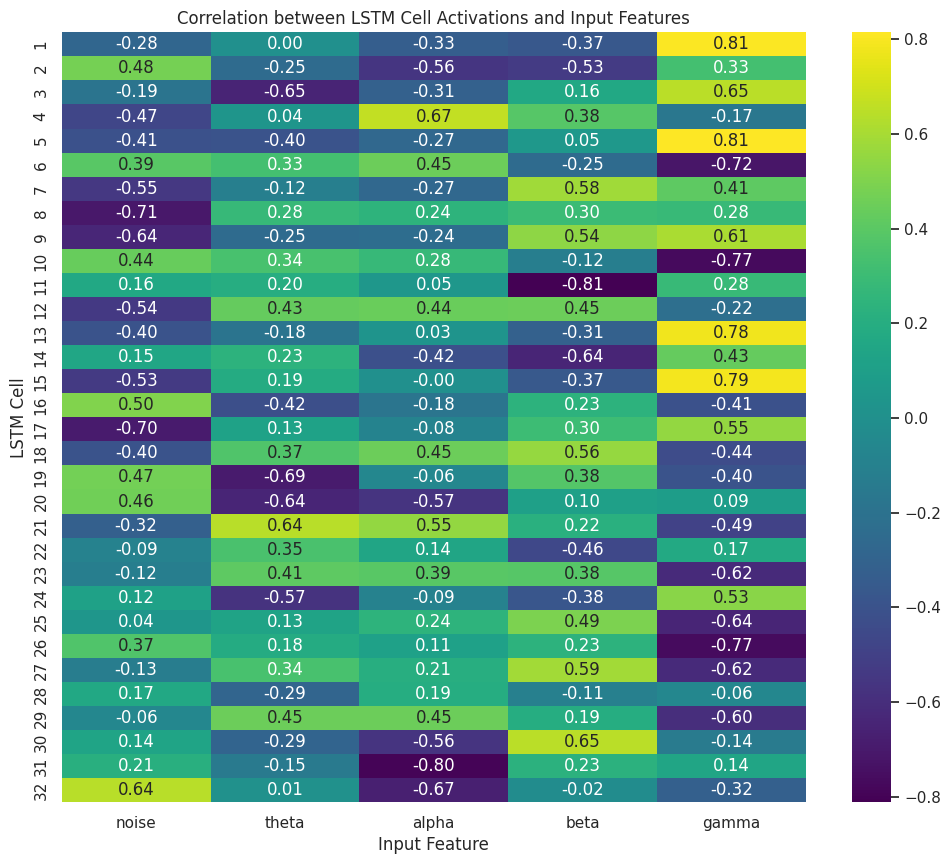

In [ ]:
cell_activations_feature = extracted_data_dict['mid_noise_hilbert_multi']['hidden_states_activation'][-1]
epoch_model_predictions = extracted_data_dict['mid_noise_hilbert_multi']['epoch_model_predictions'][-1]

print(epoch_model_predictions.shape)
print(cell_activations_feature.shape)

matrix_cell_prediction = create_heatmap_cell_corr_category(cell_activations_feature, epoch_model_predictions, absolute=True, rounding_factor=.2)

In [ ]:
import numpy as np
import matplotlib.pyplot as plt

def plot_max_correlation_bar_chart(correlation_matrix, x_labels, title="Max Correlation Per Cell"):
    """
    Plot a bar chart of the maximum correlation for each cell.

    Args:
        correlation_matrix (numpy.ndarray): A 2D array where rows represent cells and columns represent categories or features.
        x_labels (list): Labels for the x-axis (categories or features).
        title (str): Title of the graph.
    """
    num_cells, num_categories = correlation_matrix.shape

    # Calculate maximum correlation and its corresponding category/feature for each cell
    max_correlation = np.max(np.abs(correlation_matrix), axis=1)  # Max absolute correlation per cell
    max_indices = np.argmax(np.abs(correlation_matrix), axis=1)   # Index of the max correlation

    # Prepare labels for categories/features
    max_categories = [x_labels[idx] for idx in max_indices]

    # Create the bar chart
    plt.figure(figsize=(12, 6))
    bars = plt.bar(range(1, num_cells +1), max_correlation, tick_label=[f"Cell {i}" for i in range(1, num_cells +1)])

    # Add colors based on category/feature
    for bar, category in zip(bars, max_categories):
        bar.set_color(plt.cm.tab10(x_labels.index(category) / len(x_labels)))

    # Add text annotations for the category/feature
    for i, category in enumerate(max_categories):
        plt.text(i, max_correlation[i] + 0.01, category, ha='center', fontsize=8)

    plt.title(title)
    plt.xlabel("Cells")
    plt.ylabel("Max Absolute Correlation")
    plt.xticks(rotation=90)
    plt.grid(alpha=0.3)
    plt.tight_layout()
    plt.show()


In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

def plot_specialized_vs_generalist_cells(
    correlation_matrix,
    x_labels,
    high_variance_thresh=0.8,
    low_variance_thresh=0.2,
    title="Specialized vs Generalist Cells"
):
    """
    Plot cells with high and low variance in their correlation values, using distinct color palettes.

    Args:
        correlation_matrix (numpy.ndarray): 2D array (cells x categories/features).
        x_labels (list): Labels for the x-axis (categories or features).
        high_variance_thresh (float): Minimum range for specialized cells (max-min).
        low_variance_thresh (float): Maximum range for generalist cells (max-min).
        title (str): Title of the graph.
    """
    num_cells, num_categories = correlation_matrix.shape

    # Compute max, min, and range for each cell
    max_correlation = np.max(correlation_matrix, axis=1)
    min_correlation = np.min(correlation_matrix, axis=1)
    ranges = max_correlation - min_correlation

    print(f"Ranges: {ranges}")
    # Filter cells based on thresholds
    specialized_cells = np.where(ranges >= high_variance_thresh)[0]
    generalist_cells = np.where(ranges <= low_variance_thresh)[0]

    # Create distinct color palettes for each group
    specialized_colors = sns.color_palette("Paired", len(specialized_cells))
    generalist_colors = sns.color_palette("hls", len(generalist_cells))

    print(f"Specialized Cells: {specialized_cells}")
    print(f"Generalist Cells: {generalist_cells}")

    # Plotting
    plt.figure(figsize=(14, 8))

    # Plot specialized cells
    for i, cell_idx in enumerate(specialized_cells):
        plt.plot(
            x_labels,
            correlation_matrix[cell_idx],
            label=f"Specialized Cell {cell_idx + 1}",
            linestyle="-",
            marker="o"
        )

    # Plot generalist cells
    for i, cell_idx in enumerate(generalist_cells):
        plt.plot(
            x_labels,
            correlation_matrix[cell_idx],
            label=f"Generalist Cell {cell_idx + 1}",
            linestyle="--",
            marker="x",
            color=generalist_colors[i]
        )

    # Add titles and labels
    plt.title(title)
    plt.xlabel("Categories/Features")
    plt.ylabel("Correlation")
    plt.axhline(0, color="black", linewidth=0.8, linestyle="--", alpha=0.6)  # Reference line
    plt.legend(loc="best", fontsize="small", ncol=2)
    plt.grid(alpha=0.3)
    plt.tight_layout()
    plt.show()


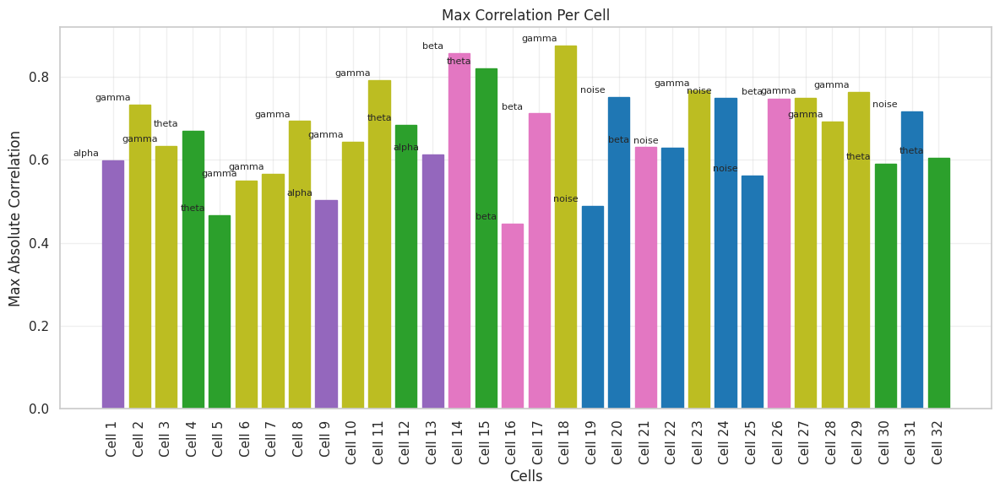

In [ ]:
# Bar Chart

# Example Usage
np.random.seed(42)
correlation_matrix = np.random.uniform(-1, 1, (32, 5))  # 32 cells, 5 categories
x_labels = ["noise", "theta", "alpha", "beta", "gamma"]
plot_max_correlation_bar_chart(matrix_cell_prediction, x_labels, title="Max Correlation Per Cell")

In [ ]:
correlation_matrix.shape

(32, 5)

Ranges: [1.12116693 1.24420589 1.1381686  1.18158649 0.827124   0.95487182
 1.03798043 0.98346941 0.96831476 1.0134738  1.43254979 1.17177234
 1.00053244 1.3128656  1.1923563  0.78134678 1.24845255 1.3740222
 0.95404175 1.11710078 1.07892664 1.1476484  1.2498205  1.06906729
 1.12406566 1.34671475 1.47388975 1.32558808 1.21267391 0.969526
 1.121036   1.19770115]
Specialized Cells: [10 13 17 25 26 27]
Generalist Cells: []


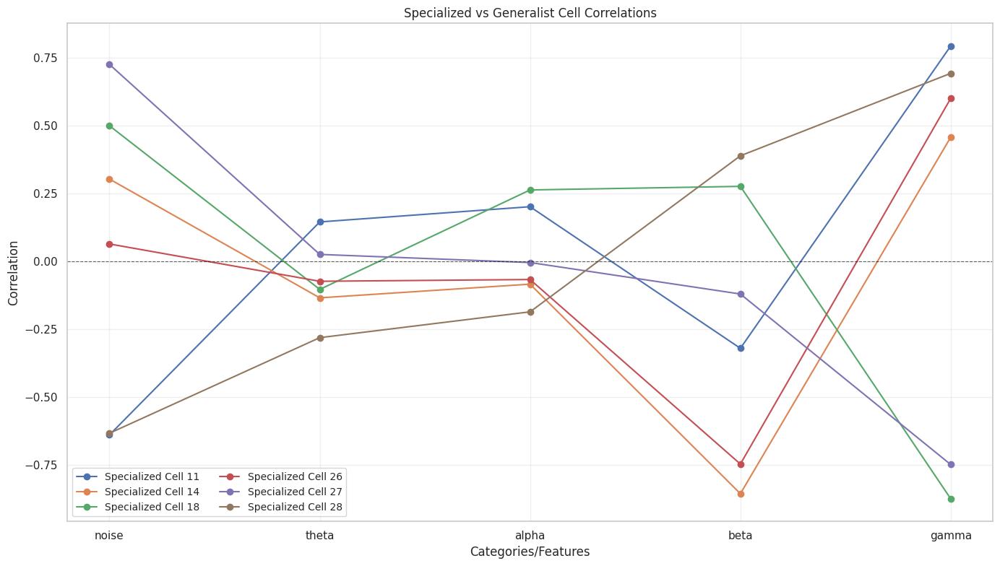

In [ ]:
# Line Graph
# Example Usage
x_labels = ["noise", "theta", "alpha", "beta", "gamma"]

plot_specialized_vs_generalist_cells(
    matrix_cell_prediction,
    x_labels,
    high_variance_thresh=1.3,
    low_variance_thresh=0.6,
    title="Specialized vs Generalist Cell Correlations"
)

Model: mid_noise_all_features_multi 
Sample: 16 
NoiseRatio: -4
(7500, 5, 1)
Printing the [13, 26] cells


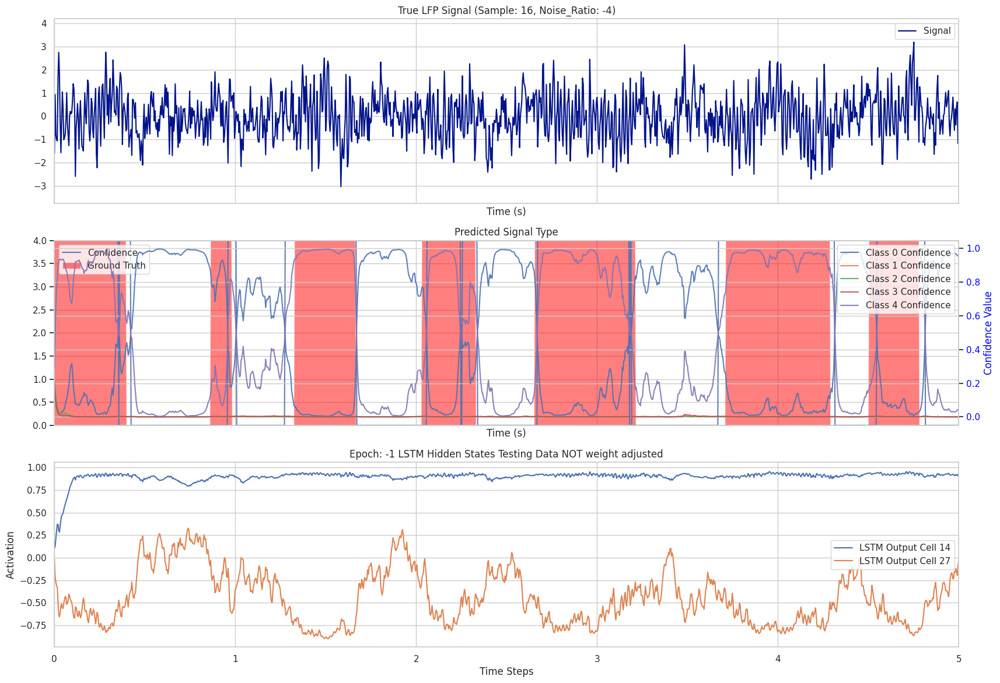

In [ ]:
# Cell 27(Id26) strong pos. corr w/ noise and strong neg. corr w/ gamma, nothing else

special_cells = [13, 26]
visualize_hidden_activation_multi(extracted_data_dict, tt_splits_dict, directory_name='mid_noise_all_features_multi',
                                      sample_number=16, epoch_to_visualize=-1,
                                      noise_ratio=1,
                                      cells_to_visualize=special_cells)

## Combine Noise and Feature Prediction

I have two heat maps or correlation matrices. One depicts the cell's correlation the predicted output under noise variations and one that depicts the cells correlation to predicted categories. Every cell naturally performed better under less noise, but there where steep differences between differences between the cells. I would be interested doing two different things.

1.  Making a new matrix that expands the x-axis to plot num_features x num_noise_levels.  
2. Fusing two matrices by adding the noise level performance two the num_features performance

1. Expanded Matrix (Noise per Feature)

Maybe use a (4x5 Matrix) showcasing the similarity to the ground truth and the cell activation.

Currently it uses the models prediction, but since that also gets worse, once the noise is high, the differences are actually much smaller throughout the noice than I had hoped.

In [ ]:
cell_activations_feature = extracted_data_dict['mid_noise_hilbert_multi']['hidden_states_activation'][-1]
epoch_model_predictions = extracted_data_dict['mid_noise_hilbert_multi']['epoch_model_predictions'][-1]

y_labels_feature = tt_splits_dict['mid_noise_hilbert_multi']['y_test']

y_labels_feature = np.expand_dims(y_labels_feature, axis=-1)

print(y_labels_feature.shape)
print(cell_activations_feature.shape)

douple_matrix = create_heatmap_cell_corr_noise_and_category(cell_activations_feature, epoch_model_predictions, absolute=False, rounding_factor=.2)

NameError: name 'extracted_data_dict' is not defined

Model: mid_noise_all_features_multi 
Sample: 16 
NoiseRatio: -4
(7500, 5, 1)
Printing the [16, 4, 12] cells


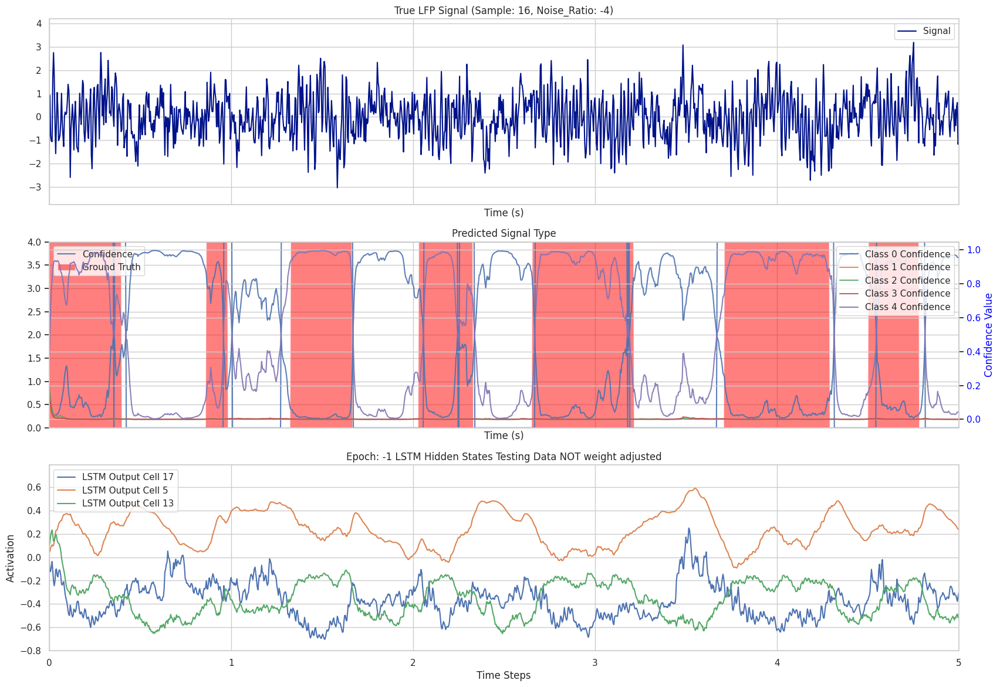

In [ ]:
# Cell 17(Id16) strong differnces throughout noise levels in noise detection

# Cell 5(Id 4) better theta under high noise

# Cell 13(Id 12) better theta under low noise

special_cells = [16, 4, 12]
visualize_hidden_activation_multi(extracted_data_dict, tt_splits_dict, directory_name='mid_noise_all_features_multi',
                                      sample_number=16, epoch_to_visualize=-1,
                                      noise_ratio=1,
                                      cells_to_visualize=special_cells)

In [ ]:
def create_heatmap_cell_corr_noise_and_category(hidden_activations, y_pred, correlation_metric=np.corrcoef, absolute=False, rounding_factor=.1):
    """
    Creates a heatmap showing correlation between cell activations and frequency values,
    split by noise level and prediction category.

    Args:
        hidden_activations (np.ndarray): LSTM hidden activations of shape (samples, noise_ratios, timesteps, cells).
        y_pred (np.ndarray): Model predictions of shape (samples, noise_ratios, timesteps, categories).
        correlation_metric (function, optional): The correlation metric function to use. Defaults to np.corrcoef.
        absolute (bool, optional): Whether to take the absolute value of correlations. Defaults to False.
        rounding_factor (float, optional): The rounding factor for annotations. Defaults to .1.

    Returns:
        np.ndarray: The correlation matrix.
    """
    num_cells = hidden_activations.shape[-1]  # Number of LSTM cells
    num_noise_levels = hidden_activations.shape[1]  # Number of noise levels
    num_categories = y_pred.shape[-1]  # Number of prediction categories

    noise_values = [-8, -4, 0, 4, 8]
    category_order = ["noise", "theta", "alpha", "beta", "gamma"]

    correlation_matrix = np.zeros((num_cells, num_noise_levels * num_categories))


    # Determine y-labels (frequencies)
    mean_freqs = np.logspace(np.log10(4), np.log10(100), num=20)
    mean_freqs_round = np.round(mean_freqs).astype(int)

    # Determine oscillation categories for each frequency
    oscillation_categories = []
    for freq in mean_freqs_round:
        oscillation_categories.append(classify_burst(freq))

    # Define desired order of categories
    category_order = ["theta", "alpha", "beta", "gamma", "noise"]

    # Get unique oscillation categories and their indices, respecting the order
    unique_categories = [cat for cat in category_order if cat in oscillation_categories]
    num_categories = len(unique_categories)



    x_labels_top = []  # Category labels (every 5 ticks)
    x_labels_bottom = [] # Noise level labels (every tick)

    # Iterate over noise levels and categories
    x_index = 0
    for category in range(num_categories):
        for noise_level in range(num_noise_levels):
            x_labels_top.append(f"{noise_values[noise_level]}dB")
            if noise_level == 2:  # Add category label at the beginning of each category group
                x_labels_bottom.append(category_order[category])
            else:
                x_labels_bottom.append('')  # Leave other top labels empty


            # Select data for current noise level and category
            activations_for_corr = hidden_activations[:, noise_level, :, :]  # Select all timesteps and cells
            predictions_for_corr = y_pred[:, noise_level, :, category].flatten()  # Select current category and flatten

            # Ensure activations_for_corr has the same number of elements as predictions_for_corr
            activations_for_corr = activations_for_corr.reshape(-1, num_cells)  # Reshape to (num_timesteps * num_samples, num_cells)

            # Calculate correlation for each cell
            for cell_index in range(num_cells):
                correlation_matrix[cell_index, x_index] = correlation_metric(
                    activations_for_corr[:, cell_index], predictions_for_corr)[0, 1]  # Calculate correlation

            x_index += 1  # Move to the next column in the correlation matrix

    if absolute:
        correlation_matrix = np.abs(correlation_matrix)

       # Create and display heatmap
    fig, ax1 = plt.subplots(figsize=(20, 10))  # Adjust figure size as needed
    sns.heatmap(correlation_matrix, annot=True, cmap="viridis", fmt=f"{rounding_factor}f",
                xticklabels=x_labels_bottom, yticklabels=range(1, num_cells + 1), ax=ax1)

    # Customize grid lines
    ax1.grid(False, which="minor", axis='x') # Turn off minor gridlines entirely

    ax1.set_title("Correlation between LSTM Cell Activations and Noise and Categories")
    ax1.set_xlabel("Categories")
    ax1.set_ylabel("LSTM Cell")

    # Create second x-axis for oscillation categories
    ax2 = ax1.twiny()

    # Customize grid lines
    ax2.grid(False, which="minor", axis='x') # Turn off minor gridlines entirely
    ax2.set_xlim(ax1.get_xlim())  # Align x-axes
    ax2.set_xticks(ax1.get_xticks())  # Align ticks
    ax2.set_xticklabels(x_labels_top, ha='left')  # Set oscillation category labels
    ax2.set_xlabel("Noise in dB")



    # # Create and display heatmap with annotations and two-level x-axis labels
    # plt.figure(figsize=(20, 12))  # Adjust figure size as needed
    # ax = sns.heatmap(correlation_matrix, annot=True, cmap="viridis", fmt=f"{rounding_factor}f",
    #             xticklabels=x_labels_bottom, yticklabels=range(1, num_cells + 1))  # Bottom labels

    # # Add bottom x-axis labels and re-enable top ticks
    # # ax.xaxis.tick_bottom()  # Set the x-axis ticks to the bottom (default) # This is not needed
    # ax.set_xticklabels(x_labels_bottom)  # Set bottom labels (top x axis)
    # ax.xaxis.set_label_position('bottom')  # Move x-axis label to the bottom

    # # Re-enable top x-axis ticks
    # ax.tick_params(axis='x', bottom=True, labelbottom=False, top=True, labeltop=True) # Changed labelbottom to false
    # ax.xaxis.set_tick_params(which='both', labeltop=True)  # Show labels on the top


    # plt.title("Correlation between LSTM Cell Activations and Predictions")
    # plt.xlabel("Noise Ratio in Decibel") # Label for top x-axis
    # plt.ylabel("LSTM Cell")
    # plt.xticks()  # Rotate x-axis labels for better readability
    # plt.tight_layout()  # Adjust layout to prevent labels from overlapping
    plt.show()

    return correlation_matrix

In [ ]:
def create_heatmap_cell_corr_noise_and_category(hidden_activations, y_pred, correlation_metric=np.corrcoef, absolute=False, rounding_factor=.1):

    num_cells = hidden_activations.shape[-1]  # 32 cells
    num_categories = y_pred.shape[-1]         # 5 Output Neurons (Categories)

    num_noises = hidden_activations.shape[1]  # 5 noise values
    noise_values = [-8,-4,0,4,8]

    # Define desired order of categories
    category_order = ["noise", "theta", "alpha", "beta", "gamma"]

    # Reshape for easier calculation
    cell_activations = hidden_activations.reshape(-1, num_noises, num_cells)
    y_pred = y_pred.reshape(-1, num_noises, num_categories)


    # Initialize correlation matrix for categories
    correlation_matrix = np.zeros((num_cells, num_categories * num_noises))


    for cat_idx in range(num_categories):

      for noise_idx in range(num_noises):
          x_index = cat_idx * num_noises + noise_idx
          print(x_index)
          # Calculate correlations for each cell and the label
          for cell_index in range(num_cells):  # Iterate over cells
              print("Prediction:", y_pred[:, noise_idx, cat_idx].shape)
              print("Activations:", cell_activations[:, noise_idx, cell_index].shape)
              correlation_matrix[cell_index, x_index] = correlation_metric(
                    cell_activations[:, noise_idx, cell_index], y_pred[:, noise_idx, cat_idx])[0, 1]

            # distance = np.linalg.norm(activations[:, cell_index] - labels)
            # stability = np.std(activations[:, cell_index])
            # correlation_matrix[cell_index, cat] = np.corrcoef(activations[:, cell_index], labels)[0,1]
        # Store the label correlation (always 1) in the first row

    # Create and display heatmap with annotations
    plt.figure(figsize=(20, 10))  # Adjust figure size as needed
    sns.heatmap(correlation_matrix, annot=True, cmap="viridis", fmt=f".2f",  # Add annot=True and fmt=".2f"
                xticklabels=category_order, yticklabels=range(1, num_cells + 1))
    plt.title("Correlation between LSTM Cell Activations and Input Features")
    plt.xlabel("Input Feature")
    plt.ylabel("LSTM Cell")
    plt.show()

    return correlation_matrix


# Epoch Analysis


# Take-aways:

- Hidden state is available for each timestep and is used for predictions. It contains information about the input sequence up to that point, including any information carried by the cell state.
- Cell state accumulates over the sequence and is only returned as a final value at the end of the sequence.

**1. Hidden State (h_t)**

- The hidden state is a representation of the information the LSTM has learned up to that point in time, including its memory of past timesteps and current input.
The hidden state is calculated at every timestep of the sequence. This means that every time the LSTM processes a new timestep of the input sequence, it updates the hidden state based on both the previous hidden state and the current input.
- The output of the LSTM (when return_sequences=True) corresponds to the hidden state at each timestep of the sequence. This is the "active" memory of the network, and it's used to make predictions, process future timesteps, and propagate information throughout the sequence.

**2. Cell State (c_t):**

- The cell state is like the "long-term memory" of the LSTM. It carries information throughout the sequence, but it is not updated at every timestep in the same way as the hidden state. Instead, it is updated through a combination of gates (input, forget, and output gates) at each timestep, but it only gets the final value after the sequence ends.
- The cell state is updated at every timestep, but its final value at the end of the sequence is the long-term memory that has been passed from one timestep to the next.

Note: The cell state is typically not returned as an output for every timestep, because it's primarily used as a form of internal memory to pass information between timesteps. It's not directly used for prediction — it's the hidden state that contains the key information used for outputs and predictions.

**3. How the LSTM Works Internally:**

At each timestep 𝑡, the LSTM updates the hidden state (h_t) and the cell state (c_t) using the following operations:

- Forget Gate: Decides what proportion of the previous cell state to "forget."
- Input Gate: Determines how much new information to add to the cell state.
- Output Gate: Decides what the current hidden state should be, based on the cell state and current input.

**4. Final**

- The cell state is essentially the memory that is propagated through the network as the sequence progresses, and it's not directly used for making predictions at each timestep (it’s used internally for learning).
- The final cell state at the end of the sequence is returned because it represents the accumulated memory after the whole sequence has been processed.
